In [1]:
# AeroCNN-II
import os
import sys
import numpy as np
import pandas as pd
import tensorflow as tf
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.impute import SimpleImputer

import datetime
%matplotlib inline

In [2]:
n_kernel=100
l2Regularizer=1e-09
kernel_size1 = 3
kernel_size2 = 3
#kernel_size3 = 5
n_grid = 100
strides1 = 1
strides2 = 2
lr=5e-04
batch_size=20

In [3]:
alpha = np.linspace(-10,20,16).reshape((16,1))

In [4]:
aa = np.zeros((16*133,1))
for i in range(0, 133):
    aa[16*i:16*(i+1), :] = alpha[:,:]

In [5]:
aa = aa.reshape((133, 16, 1, 1))

In [6]:
os.chdir('D:\\AeroCNN2Inputs')

In [7]:
origin = "D:\\AeroCNN2Inputs2"
origin_data = "D:\\AirfoilClCdCoordinates_out\\AirfoilClCdCoordinates_out"
origin_poisson = "D:\\CNN_poisson_files\\poisson\\bc2"

In [8]:
folders_orig = os.listdir(origin)
folders = [file for file in folders_orig if file.endswith('.csv')]

In [9]:
image_df = pd.DataFrame()
for i in range(1, 134):
    for j in range(0, alpha.shape[0]):
        csv_file_name = origin + '\\airfoil' + str(i) + "_alpha"+ str(int(alpha[j])) + ".csv"
        data = pd.read_csv(csv_file_name, header=None)
        image_df = pd.concat([image_df, data])

In [10]:
image_np = image_df.iloc[:, :].values

In [11]:
image = image_np.reshape((133, 16, n_grid, n_grid))

In [12]:
image = 1-image/100

In [13]:
# Laplace/Poisson field
field_df = pd.DataFrame()
for i in range(1, 134):
    for j in range(0, alpha.shape[0]):
        csv_file_name = origin_poisson + '\\airfoil' + str(i) + "_alpha"+ str(int(alpha[j])) + ".csv"
        data = pd.read_csv(csv_file_name, header=None)
        field_df = pd.concat([field_df, data], axis=0)

In [14]:
field_np = field_df.iloc[:, :].values

In [15]:
imr = SimpleImputer(missing_values=np.nan, strategy='mean')
imr = imr.fit(field_np)
imputed_field = imr.transform(field_np)

In [16]:
field = imputed_field.reshape((133, 16, n_grid, n_grid))

In [17]:
field_nor = (field-np.min(field))/(np.max(field)-np.min(field))

In [18]:
file_name = origin_data + "\\AirfoilIndexList.xlsx"
airfoilName_df = pd.read_excel(file_name)
geometry_orig = airfoilName_df.iloc[:, 1].values

In [19]:
geometry = np.zeros((133*16,1))
geometry = geometry.astype(np.string_)
for i in geometry_orig:
    index_ = np.where(geometry_orig==i)
    for j in range(0,16):
        geometry[16*index_[0]+j,:] = np.asarray(i)

In [20]:
geometry = geometry.reshape((133, 16, 1))

In [21]:
x_all, x_test, aa_all, aa_test, geo_all, geo_test, y_all, y_test = train_test_split(image, aa, geometry, field_nor, test_size=0.1, random_state=1)

In [22]:
x_train, x_val, aa_train, aa_val, geo_train, geo_val, y_train, y_val = train_test_split(x_all, aa_all, geo_all, y_all, test_size=0.2, random_state=1)

In [23]:
x_train = x_train.reshape((x_train.shape[0]*x_train.shape[1], x_train.shape[2], x_train.shape[3], 1))
x_val = x_val.reshape((x_val.shape[0]*x_val.shape[1], x_val.shape[2], x_val.shape[3], 1))
x_test = x_test.reshape((x_test.shape[0]*x_test.shape[1], x_test.shape[2], x_test.shape[3], 1))
aa_train = aa_train.reshape((aa_train.shape[0]*aa_train.shape[1], aa_train.shape[2], aa_train.shape[3]))
aa_val = aa_val.reshape((aa_val.shape[0]*aa_val.shape[1], aa_val.shape[2], aa_val.shape[3]))
aa_test = aa_test.reshape((aa_test.shape[0]*aa_test.shape[1], aa_test.shape[2], aa_test.shape[3]))
geo_train = geo_train.reshape((geo_train.shape[0]*geo_train.shape[1], geo_train.shape[2]))
geo_val = geo_val.reshape((geo_val.shape[0]*geo_val.shape[1], geo_val.shape[2]))
geo_test = geo_test.reshape((geo_test.shape[0]*geo_test.shape[1], geo_test.shape[2]))
y_train = y_train.reshape((y_train.shape[0]*y_train.shape[1], y_train.shape[2], y_train.shape[3], 1))
y_val = y_val.reshape((y_val.shape[0]*y_val.shape[1], y_val.shape[2], y_val.shape[3], 1))
y_test = y_test.reshape((y_test.shape[0]*y_test.shape[1], y_test.shape[2], y_test.shape[3], 1))

In [24]:
tf.keras.backend.set_image_data_format('channels_last')

In [40]:
input_image = tf.keras.Input(shape=(n_grid, n_grid, 1))

x_conv1 = tf.keras.layers.Conv2D(n_kernel, (kernel_size1, kernel_size1), strides=(strides1, strides1),
                                activation='relu', padding='same',
                                kernel_regularizer=tf.keras.regularizers.l2(l2Regularizer),
                                name='Conv2DLayer1')(input_image)
x_1 = tf.keras.layers.MaxPooling2D((2,2))(x_conv1)
x_conv2 = tf.keras.layers.Conv2D(n_kernel*2, (kernel_size1, kernel_size1), strides=(strides1, strides1),
                                activation='relu', padding='same',
                                kernel_regularizer=tf.keras.regularizers.l2(l2Regularizer),
                                name='Conv2DLayer2')(x_1)
x_2 = tf.keras.layers.MaxPooling2D((2,2))(x_conv2)

x_deconv1 = tf.keras.layers.Conv2DTranspose(n_kernel*2, (kernel_size1, kernel_size1),
                                            strides=(2,2),
                                            activation='relu', padding='same',
                                            kernel_regularizer=tf.keras.regularizers.l2(l2Regularizer),
                                            name='Conv2DTLayer1')(x_2)
x_concat1 = tf.concat([x_conv2, x_deconv1], axis=-1)
x_deconv2 = tf.keras.layers.Conv2DTranspose(n_kernel, (kernel_size1, kernel_size1),
                                            strides=(2,2),
                                            activation='relu', padding='same',
                                            kernel_regularizer=tf.keras.regularizers.l2(l2Regularizer),
                                            name='Conv2DTLayer2')(x_concat1)
x_concat2 = tf.concat([x_conv1, x_deconv2], axis=-1)

x_conv_final = tf.keras.layers.Conv2D(1, (kernel_size1, kernel_size1), strides=(strides1, strides1),
                                      activation='relu', padding='same',
                                      kernel_regularizer=tf.keras.regularizers.l2(l2Regularizer),
                                      name='Conv2DLayerFinal')(x_concat2)
x_flat = tf.keras.layers.Flatten()(x_conv_final)
x_ = tf.keras.layers.Dense(units=int((n_grid)**2), activation='linear', name='FCLayer',
                           kernel_regularizer=tf.keras.regularizers.l2(l2Regularizer))(x_flat)

output_data = tf.keras.layers.Reshape((n_grid,n_grid,1))(x_)

# AeroCNN-II/Poisson/BC 2
model = tf.keras.Model(input_image, output_data)

In [41]:
model.summary()

Model: "model_3"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_6 (InputLayer)           [(None, 100, 100, 1  0           []                               
                                )]                                                                
                                                                                                  
 Conv2DLayer1 (Conv2D)          (None, 100, 100, 10  1000        ['input_6[0][0]']                
                                0)                                                                
                                                                                                  
 max_pooling2d_8 (MaxPooling2D)  (None, 50, 50, 100)  0          ['Conv2DLayer1[0][0]']           
                                                                                            

In [42]:
#with mirrored_strategy.scope():
model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=lr),
              loss = tf.keras.losses.MeanSquaredError(),
              metrics=[tf.keras.metrics.RootMeanSquaredError(name="rmse")])

In [43]:
#with mirrored_strategy.scope():
# 끝까지 학습시키고 싶을 땐 ReduceLRONPlateau에서 min_delta를 1e-11로, patience=100,
# EarlyStopping에서 patience를 200으로 설정. 평상시에는(50. 100, 1e-7로.)
# 아예 loss가 1e-6되면 멈추게끔 할 수도?
start = datetime.datetime.now()
history = model.fit(x_train, y_train, epochs=5000, shuffle=True, 
                    validation_data=[x_val, y_val], batch_size=batch_size,
                    callbacks=[tf.keras.callbacks.EarlyStopping(monitor='loss', patience=100,
                                                                min_delta=6e-7,
                                                                restore_best_weights=True,
                                                                verbose=1),
                               tf.keras.callbacks.ReduceLROnPlateau(monitor='loss', factor=0.5,
                                                                    mode='min', patience=50,
                                                                    min_delta=1e-7,
                                                                    min_lr=1e-06,
                                                                    verbose=1)])
end = datetime.datetime.now()

Epoch 1/5000
76/76 [==============================] - 5s 46ms/step - loss: 0.1003 - rmse: 0.3166 - val_loss: 0.0106 - val_rmse: 0.1027 - lr: 5.0000e-04
Epoch 2/5000
76/76 [==============================] - 3s 41ms/step - loss: 0.0025 - rmse: 0.0494 - val_loss: 3.7210e-04 - val_rmse: 0.0190 - lr: 5.0000e-04
Epoch 3/5000
76/76 [==============================] - 3s 41ms/step - loss: 6.1595e-04 - rmse: 0.0246 - val_loss: 2.1710e-04 - val_rmse: 0.0144 - lr: 5.0000e-04
Epoch 4/5000
76/76 [==============================] - 3s 41ms/step - loss: 3.4113e-04 - rmse: 0.0182 - val_loss: 2.0233e-04 - val_rmse: 0.0138 - lr: 5.0000e-04
Epoch 5/5000
76/76 [==============================] - 3s 41ms/step - loss: 2.2377e-04 - rmse: 0.0146 - val_loss: 4.9950e-04 - val_rmse: 0.0221 - lr: 5.0000e-04
Epoch 6/5000
76/76 [==============================] - 3s 41ms/step - loss: 1.7033e-04 - rmse: 0.0126 - val_loss: 2.7969e-04 - val_rmse: 0.0164 - lr: 5.0000e-04
Epoch 7/5000
76/76 [==============================] 

76/76 [==============================] - 3s 38ms/step - loss: 6.0063e-05 - rmse: 0.0068 - val_loss: 1.6103e-04 - val_rmse: 0.0121 - lr: 5.0000e-04
Epoch 53/5000
76/76 [==============================] - 3s 41ms/step - loss: 5.7095e-05 - rmse: 0.0065 - val_loss: 2.0804e-04 - val_rmse: 0.0139 - lr: 5.0000e-04
Epoch 54/5000
76/76 [==============================] - 3s 38ms/step - loss: 6.1726e-05 - rmse: 0.0069 - val_loss: 1.7411e-04 - val_rmse: 0.0126 - lr: 5.0000e-04
Epoch 55/5000
76/76 [==============================] - 3s 41ms/step - loss: 5.5592e-05 - rmse: 0.0064 - val_loss: 1.7458e-04 - val_rmse: 0.0127 - lr: 5.0000e-04
Epoch 56/5000
76/76 [==============================] - 3s 38ms/step - loss: 5.5535e-05 - rmse: 0.0064 - val_loss: 1.6064e-04 - val_rmse: 0.0121 - lr: 5.0000e-04
Epoch 57/5000
76/76 [==============================] - 3s 41ms/step - loss: 5.4373e-05 - rmse: 0.0063 - val_loss: 1.7190e-04 - val_rmse: 0.0126 - lr: 5.0000e-04
Epoch 58/5000
76/76 [===========================

Epoch 103/5000
76/76 [==============================] - 3s 38ms/step - loss: 4.1628e-05 - rmse: 0.0053 - val_loss: 2.1360e-04 - val_rmse: 0.0141 - lr: 5.0000e-04
Epoch 104/5000
76/76 [==============================] - 3s 38ms/step - loss: 5.4862e-05 - rmse: 0.0064 - val_loss: 1.7139e-04 - val_rmse: 0.0126 - lr: 5.0000e-04
Epoch 105/5000
76/76 [==============================] - 3s 41ms/step - loss: 3.5902e-05 - rmse: 0.0047 - val_loss: 1.6467e-04 - val_rmse: 0.0123 - lr: 5.0000e-04
Epoch 106/5000
76/76 [==============================] - 3s 39ms/step - loss: 3.5333e-05 - rmse: 0.0047 - val_loss: 1.6522e-04 - val_rmse: 0.0123 - lr: 5.0000e-04
Epoch 107/5000
76/76 [==============================] - 3s 38ms/step - loss: 3.6693e-05 - rmse: 0.0048 - val_loss: 1.8175e-04 - val_rmse: 0.0130 - lr: 5.0000e-04
Epoch 108/5000
76/76 [==============================] - 3s 39ms/step - loss: 4.4177e-05 - rmse: 0.0055 - val_loss: 1.5710e-04 - val_rmse: 0.0120 - lr: 5.0000e-04
Epoch 109/5000
76/76 [======

76/76 [==============================] - 3s 38ms/step - loss: 4.6000e-05 - rmse: 0.0058 - val_loss: 3.2295e-04 - val_rmse: 0.0176 - lr: 5.0000e-04
Epoch 154/5000
76/76 [==============================] - 3s 38ms/step - loss: 4.0876e-05 - rmse: 0.0053 - val_loss: 1.7614e-04 - val_rmse: 0.0128 - lr: 5.0000e-04
Epoch 155/5000
76/76 [==============================] - 3s 41ms/step - loss: 2.7754e-05 - rmse: 0.0039 - val_loss: 1.4878e-04 - val_rmse: 0.0117 - lr: 5.0000e-04
Epoch 156/5000
76/76 [==============================] - 3s 38ms/step - loss: 3.2247e-05 - rmse: 0.0044 - val_loss: 1.6800e-04 - val_rmse: 0.0125 - lr: 5.0000e-04
Epoch 157/5000
76/76 [==============================] - 3s 38ms/step - loss: 3.7511e-05 - rmse: 0.0050 - val_loss: 1.5898e-04 - val_rmse: 0.0121 - lr: 5.0000e-04
Epoch 158/5000
76/76 [==============================] - 3s 38ms/step - loss: 3.3099e-05 - rmse: 0.0045 - val_loss: 1.8922e-04 - val_rmse: 0.0133 - lr: 5.0000e-04
Epoch 159/5000
76/76 [=====================

Epoch 204/5000
76/76 [==============================] - 3s 38ms/step - loss: 4.8797e-05 - rmse: 0.0061 - val_loss: 1.6770e-04 - val_rmse: 0.0125 - lr: 5.0000e-04
Epoch 205/5000
76/76 [==============================] - 3s 38ms/step - loss: 2.4288e-05 - rmse: 0.0035 - val_loss: 1.4213e-04 - val_rmse: 0.0114 - lr: 5.0000e-04
Epoch 206/5000
76/76 [==============================] - 3s 41ms/step - loss: 2.3027e-05 - rmse: 0.0033 - val_loss: 1.4366e-04 - val_rmse: 0.0115 - lr: 5.0000e-04
Epoch 207/5000
76/76 [==============================] - 3s 38ms/step - loss: 2.5383e-05 - rmse: 0.0037 - val_loss: 1.6535e-04 - val_rmse: 0.0124 - lr: 5.0000e-04
Epoch 208/5000
76/76 [==============================] - 3s 38ms/step - loss: 2.2497e-05 - rmse: 0.0033 - val_loss: 1.3677e-04 - val_rmse: 0.0112 - lr: 5.0000e-04
Epoch 209/5000
76/76 [==============================] - 3s 38ms/step - loss: 2.4810e-05 - rmse: 0.0036 - val_loss: 1.6349e-04 - val_rmse: 0.0123 - lr: 5.0000e-04
Epoch 210/5000
76/76 [======

76/76 [==============================] - 3s 39ms/step - loss: 1.9819e-05 - rmse: 0.0029 - val_loss: 1.4930e-04 - val_rmse: 0.0118 - lr: 5.0000e-04
Epoch 255/5000
76/76 [==============================] - 3s 39ms/step - loss: 2.0233e-05 - rmse: 0.0030 - val_loss: 1.2960e-04 - val_rmse: 0.0109 - lr: 5.0000e-04
Epoch 256/5000
76/76 [==============================] - 3s 38ms/step - loss: 1.9822e-05 - rmse: 0.0029 - val_loss: 1.1869e-04 - val_rmse: 0.0104 - lr: 5.0000e-04
Epoch 257/5000
76/76 [==============================] - 3s 38ms/step - loss: 1.8681e-05 - rmse: 0.0027 - val_loss: 1.2006e-04 - val_rmse: 0.0104 - lr: 5.0000e-04
Epoch 258/5000
76/76 [==============================] - 3s 38ms/step - loss: 2.1044e-05 - rmse: 0.0031 - val_loss: 1.3314e-04 - val_rmse: 0.0110 - lr: 5.0000e-04
Epoch 259/5000
76/76 [==============================] - 3s 38ms/step - loss: 1.9123e-05 - rmse: 0.0028 - val_loss: 1.2501e-04 - val_rmse: 0.0107 - lr: 5.0000e-04
Epoch 260/5000
76/76 [=====================

Epoch 305/5000
76/76 [==============================] - 3s 38ms/step - loss: 1.6282e-05 - rmse: 0.0024 - val_loss: 1.0885e-04 - val_rmse: 0.0099 - lr: 5.0000e-04
Epoch 306/5000
76/76 [==============================] - 3s 38ms/step - loss: 1.9809e-05 - rmse: 0.0031 - val_loss: 1.0957e-04 - val_rmse: 0.0100 - lr: 5.0000e-04
Epoch 307/5000
76/76 [==============================] - 3s 38ms/step - loss: 1.4699e-05 - rmse: 0.0021 - val_loss: 1.1188e-04 - val_rmse: 0.0101 - lr: 5.0000e-04
Epoch 308/5000
76/76 [==============================] - 3s 38ms/step - loss: 1.4556e-05 - rmse: 0.0020 - val_loss: 1.2196e-04 - val_rmse: 0.0106 - lr: 5.0000e-04
Epoch 309/5000
76/76 [==============================] - 3s 38ms/step - loss: 1.6077e-05 - rmse: 0.0024 - val_loss: 1.1382e-04 - val_rmse: 0.0102 - lr: 5.0000e-04
Epoch 310/5000
76/76 [==============================] - 3s 38ms/step - loss: 1.8983e-05 - rmse: 0.0029 - val_loss: 1.1419e-04 - val_rmse: 0.0102 - lr: 5.0000e-04
Epoch 311/5000
76/76 [======

76/76 [==============================] - 3s 38ms/step - loss: 1.7702e-05 - rmse: 0.0028 - val_loss: 1.2069e-04 - val_rmse: 0.0105 - lr: 5.0000e-04
Epoch 356/5000
76/76 [==============================] - 3s 38ms/step - loss: 1.6928e-05 - rmse: 0.0027 - val_loss: 1.0338e-04 - val_rmse: 0.0097 - lr: 5.0000e-04
Epoch 357/5000
76/76 [==============================] - 3s 38ms/step - loss: 2.0794e-05 - rmse: 0.0033 - val_loss: 1.0956e-04 - val_rmse: 0.0100 - lr: 5.0000e-04
Epoch 358/5000
76/76 [==============================] - 3s 38ms/step - loss: 1.5470e-05 - rmse: 0.0024 - val_loss: 1.1033e-04 - val_rmse: 0.0100 - lr: 5.0000e-04
Epoch 359/5000
76/76 [==============================] - 3s 38ms/step - loss: 1.3291e-05 - rmse: 0.0019 - val_loss: 1.1002e-04 - val_rmse: 0.0100 - lr: 5.0000e-04
Epoch 360/5000
76/76 [==============================] - 3s 38ms/step - loss: 1.6332e-05 - rmse: 0.0026 - val_loss: 1.1793e-04 - val_rmse: 0.0104 - lr: 5.0000e-04
Epoch 361/5000
76/76 [=====================

Epoch 406/5000
76/76 [==============================] - 3s 39ms/step - loss: 1.7587e-05 - rmse: 0.0029 - val_loss: 1.0700e-04 - val_rmse: 0.0099 - lr: 5.0000e-04
Epoch 407/5000
76/76 [==============================] - 3s 39ms/step - loss: 1.4529e-05 - rmse: 0.0023 - val_loss: 1.0408e-04 - val_rmse: 0.0097 - lr: 5.0000e-04
Epoch 408/5000
76/76 [==============================] - 3s 38ms/step - loss: 2.2158e-05 - rmse: 0.0036 - val_loss: 9.5836e-05 - val_rmse: 0.0093 - lr: 5.0000e-04
Epoch 409/5000
76/76 [==============================] - 3s 38ms/step - loss: 1.6186e-05 - rmse: 0.0027 - val_loss: 1.0551e-04 - val_rmse: 0.0098 - lr: 5.0000e-04
Epoch 410/5000
76/76 [==============================] - 3s 38ms/step - loss: 1.3836e-05 - rmse: 0.0022 - val_loss: 1.1843e-04 - val_rmse: 0.0105 - lr: 5.0000e-04
Epoch 411/5000
76/76 [==============================] - 3s 39ms/step - loss: 1.4351e-05 - rmse: 0.0023 - val_loss: 1.1164e-04 - val_rmse: 0.0101 - lr: 5.0000e-04
Epoch 412/5000
76/76 [======

76/76 [==============================] - 3s 38ms/step - loss: 1.1549e-05 - rmse: 0.0017 - val_loss: 9.6719e-05 - val_rmse: 0.0094 - lr: 5.0000e-04
Epoch 457/5000
76/76 [==============================] - 3s 38ms/step - loss: 1.2530e-05 - rmse: 0.0020 - val_loss: 9.7434e-05 - val_rmse: 0.0094 - lr: 5.0000e-04
Epoch 458/5000
76/76 [==============================] - 3s 38ms/step - loss: 1.1822e-05 - rmse: 0.0018 - val_loss: 1.1222e-04 - val_rmse: 0.0102 - lr: 5.0000e-04
Epoch 459/5000
76/76 [==============================] - 3s 38ms/step - loss: 1.2350e-05 - rmse: 0.0020 - val_loss: 1.0358e-04 - val_rmse: 0.0098 - lr: 5.0000e-04
Epoch 460/5000
76/76 [==============================] - 3s 38ms/step - loss: 1.4210e-05 - rmse: 0.0024 - val_loss: 1.5033e-04 - val_rmse: 0.0119 - lr: 5.0000e-04
Epoch 461/5000
76/76 [==============================] - 3s 39ms/step - loss: 2.2313e-05 - rmse: 0.0037 - val_loss: 1.2330e-04 - val_rmse: 0.0107 - lr: 5.0000e-04
Epoch 462/5000
76/76 [=====================

Epoch 507/5000
76/76 [==============================] - 3s 38ms/step - loss: 1.9364e-05 - rmse: 0.0034 - val_loss: 1.0024e-04 - val_rmse: 0.0096 - lr: 5.0000e-04
Epoch 508/5000
76/76 [==============================] - 3s 38ms/step - loss: 1.1653e-05 - rmse: 0.0019 - val_loss: 9.8269e-05 - val_rmse: 0.0095 - lr: 5.0000e-04
Epoch 509/5000
76/76 [==============================] - 3s 38ms/step - loss: 1.1129e-05 - rmse: 0.0018 - val_loss: 1.0202e-04 - val_rmse: 0.0097 - lr: 5.0000e-04
Epoch 510/5000
76/76 [==============================] - 3s 38ms/step - loss: 1.0836e-05 - rmse: 0.0017 - val_loss: 9.9376e-05 - val_rmse: 0.0096 - lr: 5.0000e-04
Epoch 511/5000
76/76 [==============================] - 3s 38ms/step - loss: 9.6145e-06 - rmse: 0.0013 - val_loss: 9.9383e-05 - val_rmse: 0.0096 - lr: 5.0000e-04
Epoch 512/5000
76/76 [==============================] - 3s 38ms/step - loss: 9.9906e-06 - rmse: 0.0014 - val_loss: 1.0067e-04 - val_rmse: 0.0096 - lr: 5.0000e-04
Epoch 513/5000
76/76 [======

Epoch 556/5000
76/76 [==============================] - 3s 38ms/step - loss: 8.3845e-06 - rmse: 8.8018e-04 - val_loss: 9.7588e-05 - val_rmse: 0.0095 - lr: 2.5000e-04
Epoch 557/5000
76/76 [==============================] - 3s 38ms/step - loss: 8.5912e-06 - rmse: 9.9342e-04 - val_loss: 9.3865e-05 - val_rmse: 0.0093 - lr: 2.5000e-04
Epoch 558/5000
76/76 [==============================] - 3s 38ms/step - loss: 8.7107e-06 - rmse: 0.0011 - val_loss: 9.7546e-05 - val_rmse: 0.0095 - lr: 2.5000e-04
Epoch 559/5000
76/76 [==============================] - 3s 38ms/step - loss: 8.0623e-06 - rmse: 6.8459e-04 - val_loss: 9.8251e-05 - val_rmse: 0.0095 - lr: 2.5000e-04
Epoch 560/5000
76/76 [==============================] - 3s 38ms/step - loss: 8.4880e-06 - rmse: 9.4861e-04 - val_loss: 9.5677e-05 - val_rmse: 0.0094 - lr: 2.5000e-04
Epoch 561/5000
76/76 [==============================] - 3s 38ms/step - loss: 9.5971e-06 - rmse: 0.0014 - val_loss: 9.9766e-05 - val_rmse: 0.0096 - lr: 2.5000e-04
Epoch 562/50

Epoch 606/5000
76/76 [==============================] - 3s 38ms/step - loss: 8.2794e-06 - rmse: 9.6684e-04 - val_loss: 9.5780e-05 - val_rmse: 0.0094 - lr: 2.5000e-04
Epoch 607/5000
76/76 [==============================] - 3s 38ms/step - loss: 9.2719e-06 - rmse: 0.0014 - val_loss: 1.0105e-04 - val_rmse: 0.0097 - lr: 2.5000e-04
Epoch 608/5000
76/76 [==============================] - 3s 38ms/step - loss: 8.7313e-06 - rmse: 0.0012 - val_loss: 9.3692e-05 - val_rmse: 0.0093 - lr: 2.5000e-04
Epoch 609/5000
76/76 [==============================] - 3s 38ms/step - loss: 8.7243e-06 - rmse: 0.0012 - val_loss: 9.8388e-05 - val_rmse: 0.0095 - lr: 2.5000e-04
Epoch 610/5000
76/76 [==============================] - 3s 38ms/step - loss: 7.8841e-06 - rmse: 7.4835e-04 - val_loss: 9.4742e-05 - val_rmse: 0.0093 - lr: 2.5000e-04
Epoch 611/5000
76/76 [==============================] - 3s 38ms/step - loss: 8.1279e-06 - rmse: 8.9949e-04 - val_loss: 1.0051e-04 - val_rmse: 0.0097 - lr: 2.5000e-04
Epoch 612/5000
7

Epoch 656/5000
76/76 [==============================] - 3s 38ms/step - loss: 7.8012e-06 - rmse: 8.4341e-04 - val_loss: 9.6209e-05 - val_rmse: 0.0094 - lr: 2.5000e-04
Epoch 657/5000
76/76 [==============================] - 3s 38ms/step - loss: 7.5599e-06 - rmse: 6.8923e-04 - val_loss: 9.8666e-05 - val_rmse: 0.0096 - lr: 2.5000e-04
Epoch 658/5000
76/76 [==============================] - 3s 39ms/step - loss: 8.3226e-06 - rmse: 0.0011 - val_loss: 9.5343e-05 - val_rmse: 0.0094 - lr: 2.5000e-04
Epoch 659/5000
76/76 [==============================] - 3s 38ms/step - loss: 9.2299e-06 - rmse: 0.0015 - val_loss: 9.4614e-05 - val_rmse: 0.0094 - lr: 2.5000e-04
Epoch 660/5000
76/76 [==============================] - 3s 38ms/step - loss: 7.7229e-06 - rmse: 8.0805e-04 - val_loss: 9.6767e-05 - val_rmse: 0.0095 - lr: 2.5000e-04
Epoch 661/5000
76/76 [==============================] - 3s 38ms/step - loss: 7.4992e-06 - rmse: 6.5903e-04 - val_loss: 9.5650e-05 - val_rmse: 0.0094 - lr: 2.5000e-04
Epoch 662/50

76/76 [==============================] - 3s 39ms/step - loss: 7.2342e-06 - rmse: 6.2059e-04 - val_loss: 9.7278e-05 - val_rmse: 0.0095 - lr: 2.5000e-04
Epoch 706/5000
76/76 [==============================] - 3s 39ms/step - loss: 7.3278e-06 - rmse: 6.9546e-04 - val_loss: 9.5250e-05 - val_rmse: 0.0094 - lr: 2.5000e-04
Epoch 707/5000
76/76 [==============================] - 3s 39ms/step - loss: 7.3411e-06 - rmse: 7.0848e-04 - val_loss: 9.3419e-05 - val_rmse: 0.0093 - lr: 2.5000e-04
Epoch 708/5000
76/76 [==============================] - 3s 39ms/step - loss: 7.6246e-06 - rmse: 8.8897e-04 - val_loss: 9.5678e-05 - val_rmse: 0.0094 - lr: 2.5000e-04
Epoch 709/5000
76/76 [==============================] - 3s 39ms/step - loss: 7.7055e-06 - rmse: 9.3599e-04 - val_loss: 9.5974e-05 - val_rmse: 0.0094 - lr: 2.5000e-04
Epoch 710/5000
76/76 [==============================] - 3s 39ms/step - loss: 7.2451e-06 - rmse: 6.4847e-04 - val_loss: 9.4364e-05 - val_rmse: 0.0094 - lr: 2.5000e-04
Epoch 711/5000
76/7

In [44]:
time = end - start
print("Training time:", time)

Training time: 0:35:20.630670


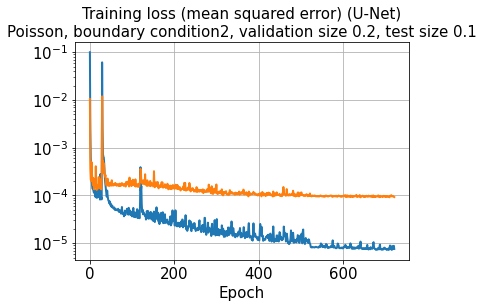

In [45]:
hist = history.history
plt.plot(hist['loss'], lw=2)
plt.plot(hist['val_loss'],lw=2)
plt.title('Training loss (mean squared error) (U-Net)\nPoisson, boundary condition2, validation size 0.2, test size 0.1', size=15)
plt.xlabel('Epoch', size=15)
plt.yscale('log')
#plt.ylim([5e-5, 1e-1])
plt.tick_params(axis='both', which='major', labelsize=15)
plt.grid()
plt.show()

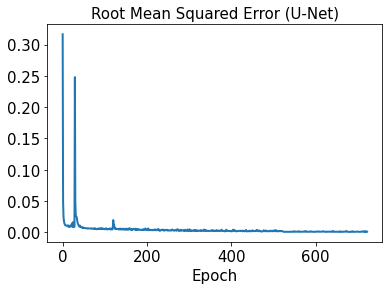

In [46]:
plt.plot(hist['rmse'], lw=2)
plt.title('Root Mean Squared Error (U-Net)', size=15)
plt.xlabel('Epoch', size=15)
plt.tick_params(axis='both', which='major', labelsize=15)
plt.show()

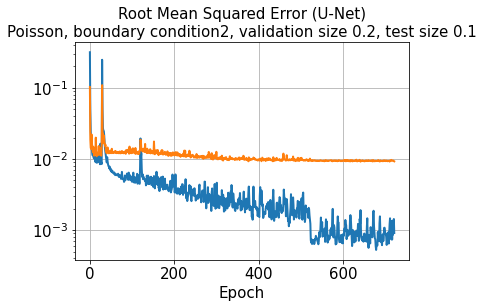

In [47]:
plt.plot(hist['rmse'], lw=2)
plt.plot(hist['val_rmse'], lw=2)
plt.title('Root Mean Squared Error (U-Net)\nPoisson, boundary condition2, validation size 0.2, test size 0.1', size=15)
plt.xlabel('Epoch', size=15)
plt.yscale('log')
plt.tick_params(axis='both', which='major', labelsize=15)
plt.grid()
plt.show()

In [48]:
#with mirrored_strategy.scope():
test_results = model.evaluate(x_train)

48/48 [==============================] - 0s 3ms/step - loss: 7.2546e-06 - rmse: 0.0000e+00


In [49]:
#with mirrored_strategy.scope():
decoded_train = model.predict(x_train)

48/48 [==============================] - 1s 15ms/step


In [50]:
decoded_val = model.predict(x_val)

12/12 [==============================] - 0s 13ms/step


In [51]:
#with mirrored_strategy.scope():
decoded_test = model.predict(x_test)

7/7 [==============================] - 0s 13ms/step


In [52]:
error_train_abs = np.abs(decoded_train - y_train)

In [53]:
error_val_abs = np.abs(decoded_val - y_val)

In [54]:
error_test_abs = np.abs(decoded_test - y_test)

In [55]:
os.chdir("D:\\TrainedModels\\20221030")
model.save('Poisson_bc2_100kernel_2by2MaxPooling_2CNNlayer_UNet_valSize0.2testSize0.1.h5',
           overwrite=True, include_optimizer=True, save_format='h5')

In [56]:
l2_error_train = np.sqrt(np.sum((decoded_train - y_train)**2) / np.sum(y_train**2))
print(l2_error_train)

0.0008682321379768791


In [57]:
l2_error_val = np.sqrt(np.sum((decoded_val - y_val)**2) / np.sum(y_val**2))
print(l2_error_val)

0.01421505044568956


In [58]:
l2_error_test = np.sqrt(np.sum((decoded_test - y_test)**2) / np.sum(y_test**2))
print(l2_error_test)

0.010689314934049404


In [59]:
l2_error_train_list = []
for i in range(0, len(aa_train)):
    l2_error_train_data = np.sqrt(np.sum((decoded_train[i] - y_train[i])**2) / np.sum(y_train[i]**2))
    l2_error_train_list.append(l2_error_train_data)
#print(l2_error_train_list)

In [60]:
l2_error_val_list = []
for i in range(0, len(aa_val)):
    l2_error_val_data = np.sqrt(np.sum((decoded_val[i] - y_val[i])**2) / np.sum(y_val[i]**2))
    l2_error_val_list.append(l2_error_val_data)
print(l2_error_val_list)

[0.0014276241722455286, 0.0012523664601108277, 0.0004966923613071042, 0.0005860803243744422, 0.0004130413483268512, 0.0004511960237353928, 0.0006049855977657772, 0.0007714317483652792, 0.0005400904534804955, 0.0004517120114716653, 0.0007473861758624769, 0.002955621429057597, 0.0018490891800330873, 0.0027009735098134633, 0.0032066318705517806, 0.0021968179270704406, 0.000887748961234729, 0.0016843287343402656, 0.0016661567766229814, 0.00048141209154149657, 0.0010366811899115568, 0.0010018245146856137, 0.0010032458396565676, 0.00047404522904922244, 0.0009944609142872845, 0.0007638496834969262, 0.001238706584608041, 0.0008357365113991652, 0.0012007778284407735, 0.0009799966297710226, 0.001986245110937159, 0.0013108684783668335, 0.0033891634348725934, 0.00045474419586652676, 0.0012740647885141824, 0.0008616398569929693, 0.0017875070612124043, 0.0014953895641742865, 0.0023183555668671286, 0.001940992820962789, 0.004606862140419961, 0.003742654838115601, 0.0018868425734249533, 0.002447034555

In [61]:
l2_error_test_list = []
for i in range(0, len(aa_test)):
    l2_error_test_data = np.sqrt(np.sum((decoded_test[i] - y_test[i])**2) / np.sum(y_test[i]**2))
    l2_error_test_list.append(l2_error_test_data)
#print(l2_error_test_list)

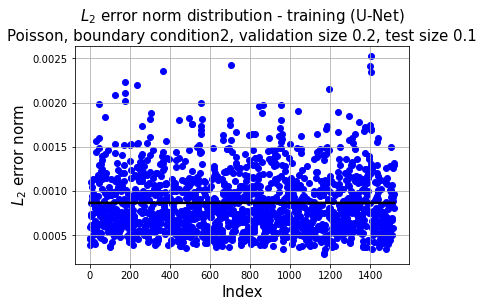

In [62]:
plt.plot(np.linspace(1, aa_train.shape[0], aa_train.shape[0]),
         l2_error_train*np.ones(aa_train.shape[0],), 'k', lw=2.5)
plt.scatter(np.linspace(1, aa_train.shape[0], aa_train.shape[0]), l2_error_train_list, c='b')
plt.xlabel('Index', fontsize=15)
plt.ylabel('$L_2$ error norm', fontsize=15)
plt.title('$L_2$ error norm distribution - training (U-Net)\nPoisson, boundary condition2, validation size 0.2, test size 0.1',
          fontsize=15)
plt.grid()
save_variance_name = "20221030L2ErrorDistribution_Poisson_bc2(training).jpg"
plt.savefig(save_variance_name, dpi=300, bbox_inches='tight', pad_inches=0.3)
plt.show()

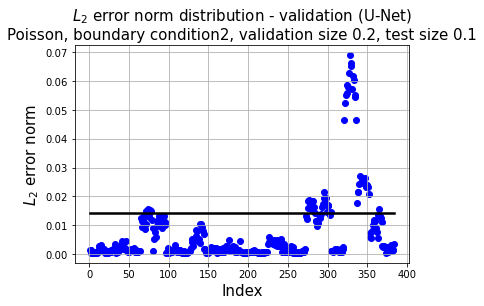

In [63]:
plt.plot(np.linspace(1, aa_val.shape[0], aa_val.shape[0]),
         l2_error_val*np.ones(aa_val.shape[0],), 'k', lw=2.5)
plt.scatter(np.linspace(1, aa_val.shape[0], aa_val.shape[0]), l2_error_val_list, c='b')
plt.xlabel('Index', fontsize=15)
plt.ylabel('$L_2$ error norm', fontsize=15)
plt.title('$L_2$ error norm distribution - validation (U-Net)\nPoisson, boundary condition2, validation size 0.2, test size 0.1',
          fontsize=15)
plt.grid()
save_variance_name = "20221030L2ErrorDistribution_Poisson_bc2(validation).jpg"
plt.savefig(save_variance_name, dpi=300, bbox_inches='tight', pad_inches=0.3)
plt.show()

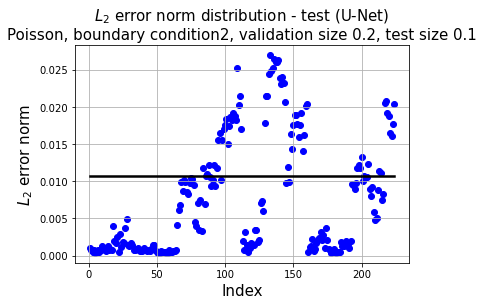

In [64]:
plt.plot(np.linspace(1, aa_test.shape[0], aa_test.shape[0]),
         l2_error_test*np.ones(aa_test.shape[0],), 'k', lw=2.5)
plt.scatter(np.linspace(1, aa_test.shape[0], aa_test.shape[0]), l2_error_test_list, c='b')
plt.xlabel('Index', fontsize=15)
plt.ylabel('$L_2$ error norm', fontsize=15)
plt.title('$L_2$ error norm distribution - test (U-Net)\nPoisson, boundary condition2, validation size 0.2, test size 0.1',
          fontsize=15)
plt.grid()
save_test_name = "20221030L2ErrorDistribution_Poisson_bc2(test).jpg"
plt.savefig(save_test_name, dpi=300, bbox_inches='tight', pad_inches=0.3)
plt.show()

In [66]:
os.chdir("D:\\CNN_poisson_files\\images\\20221030\\UNetValSize0.2TestSize0.1")

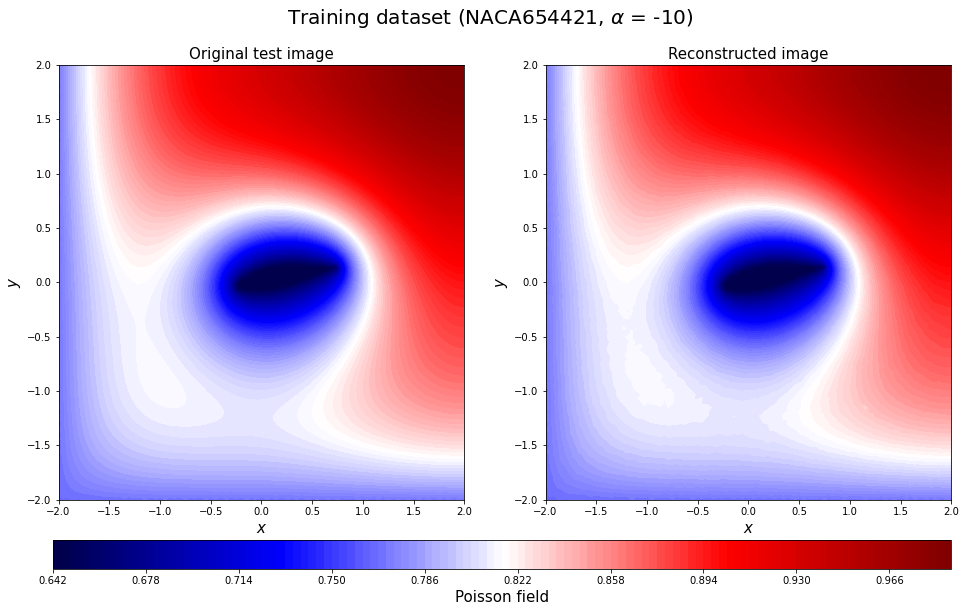

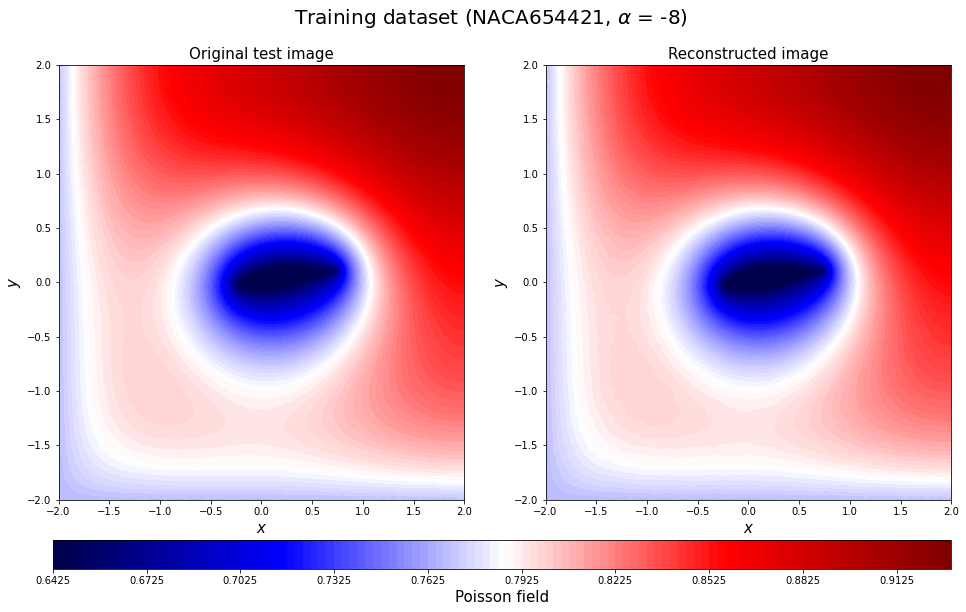

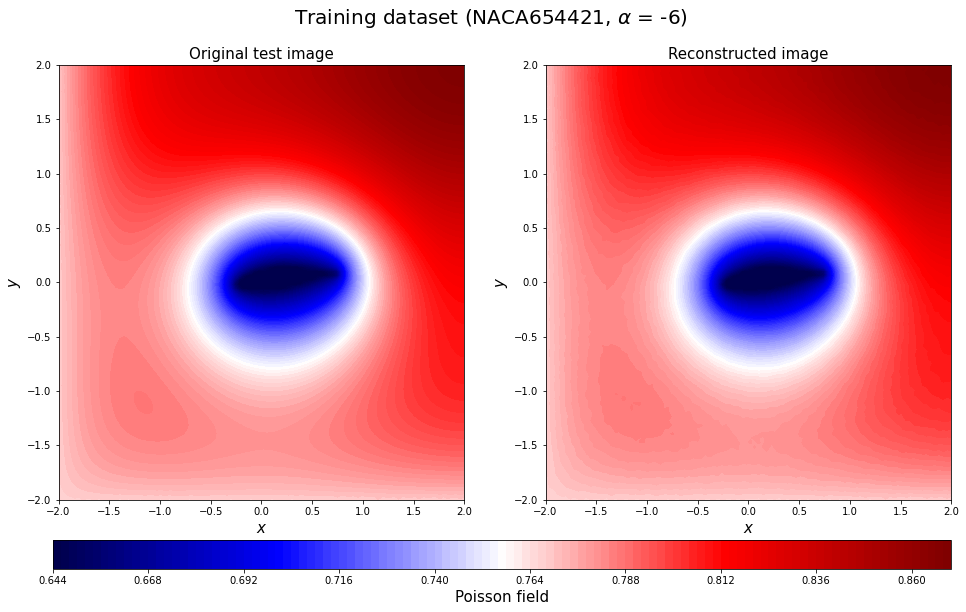

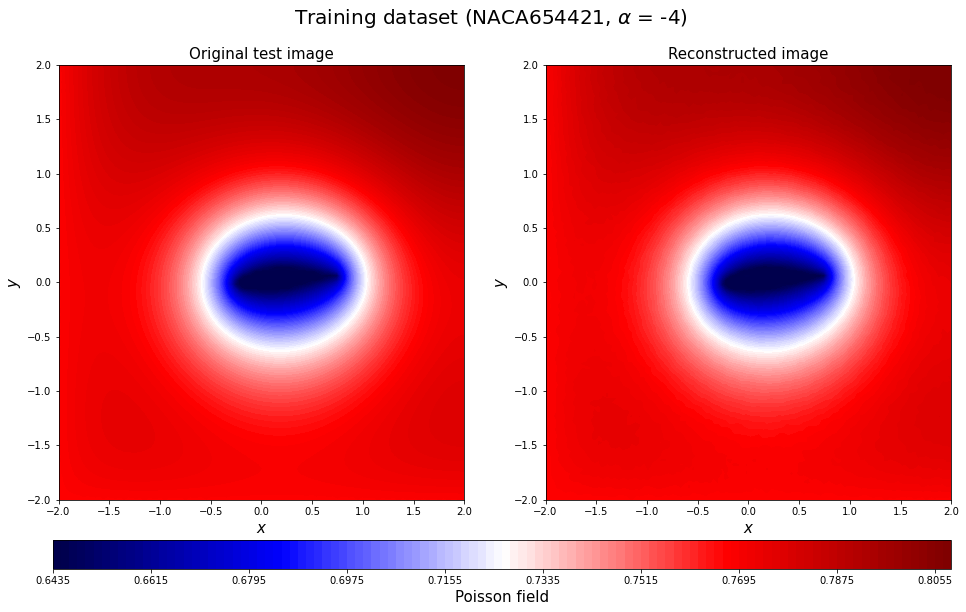

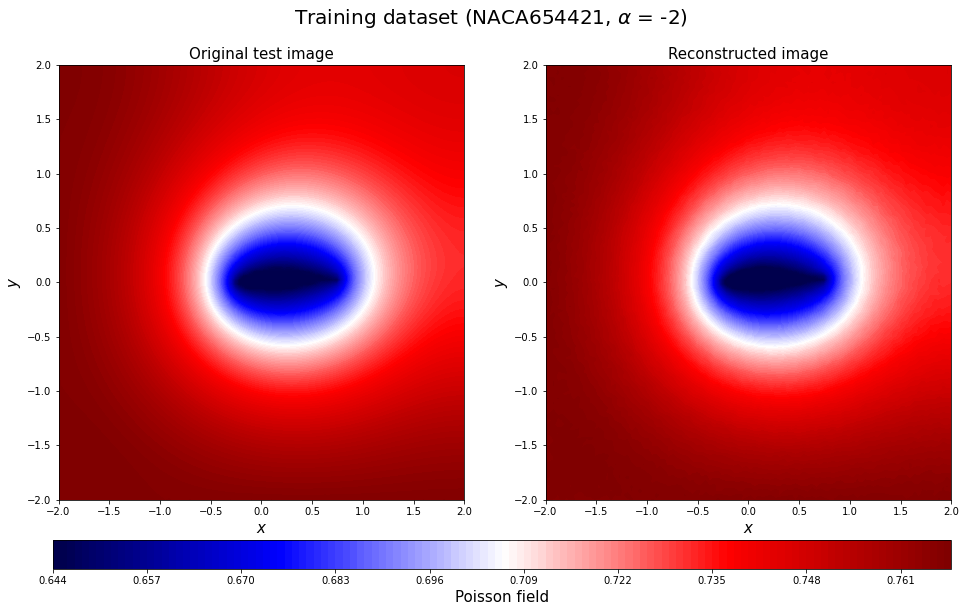

...

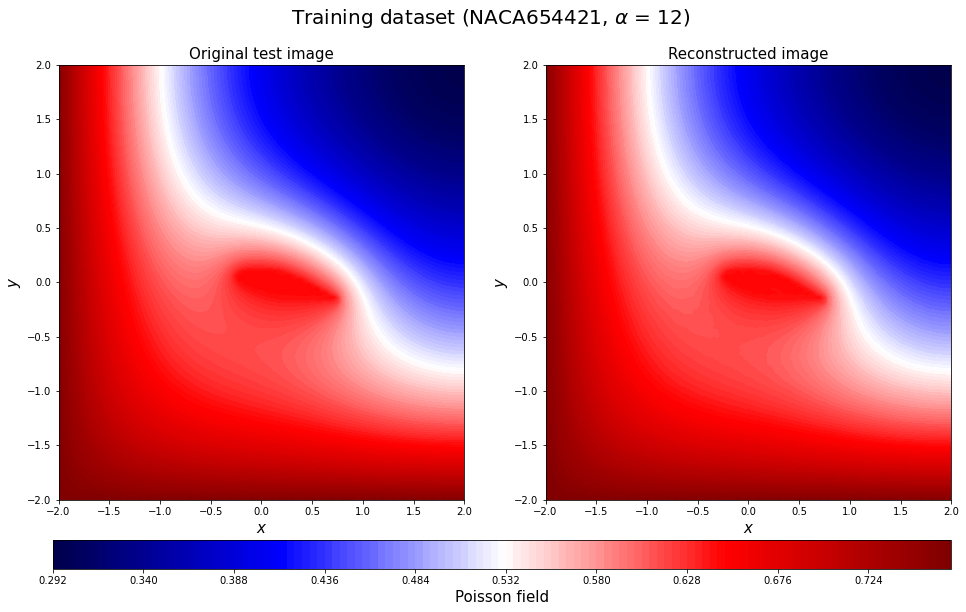

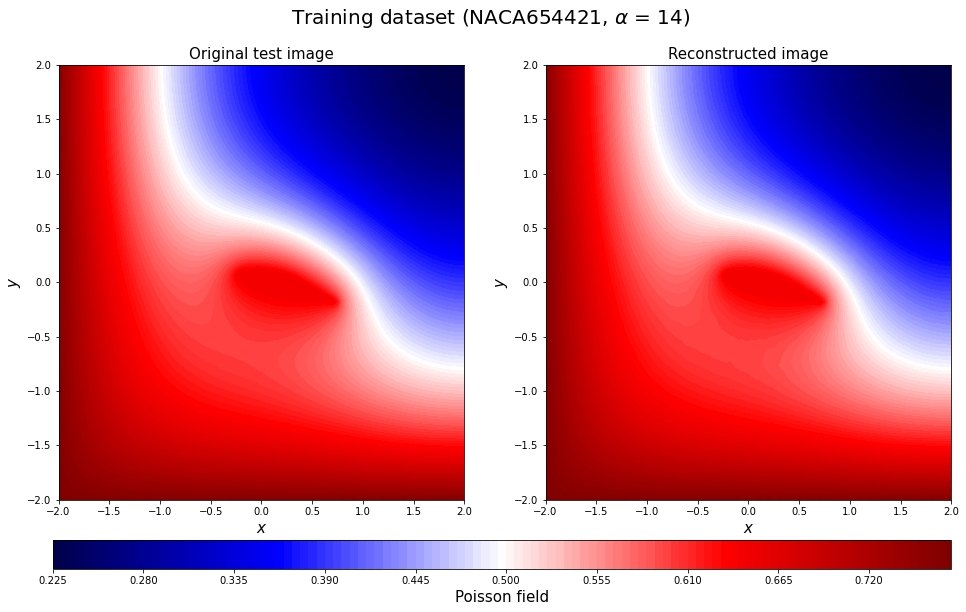

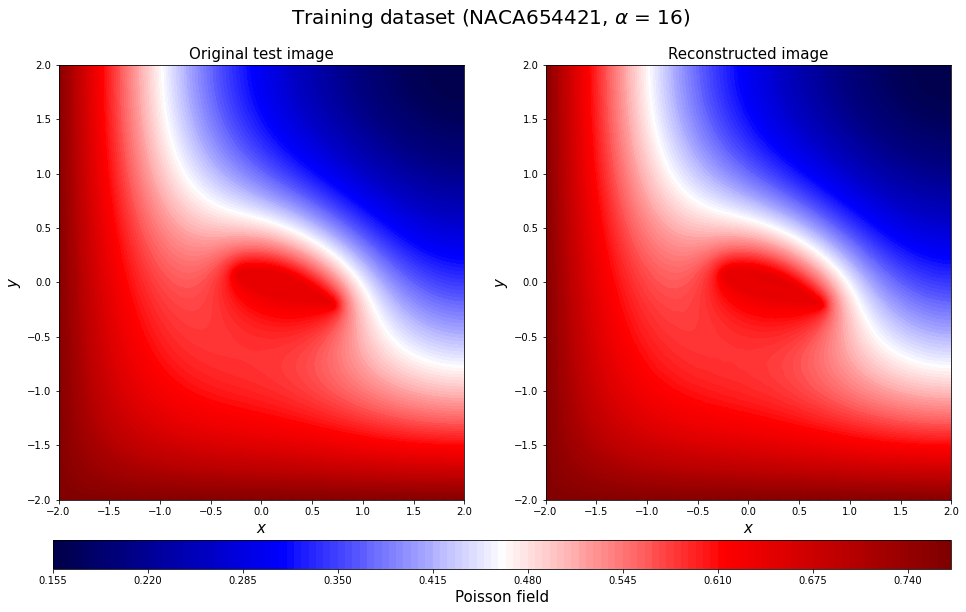

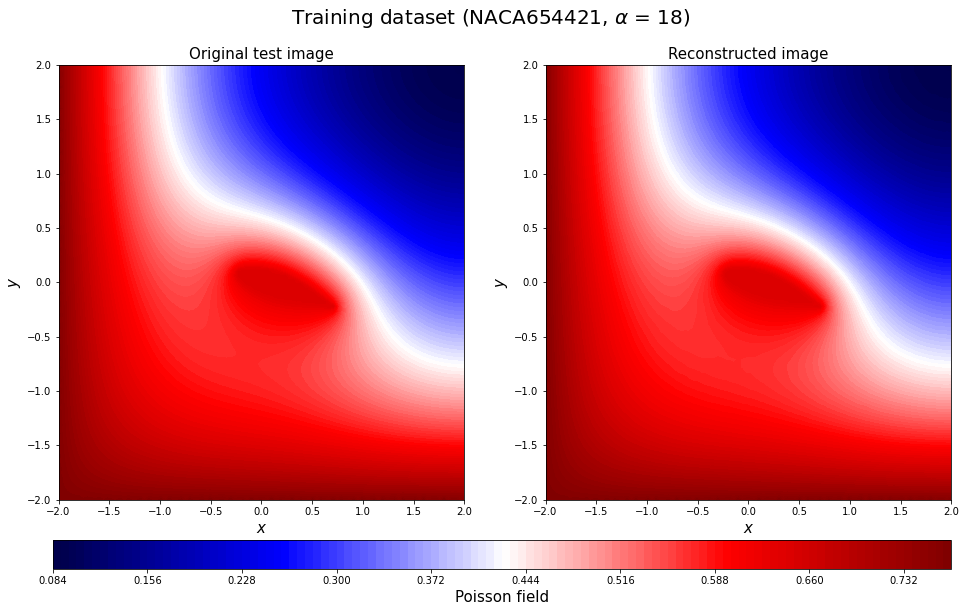

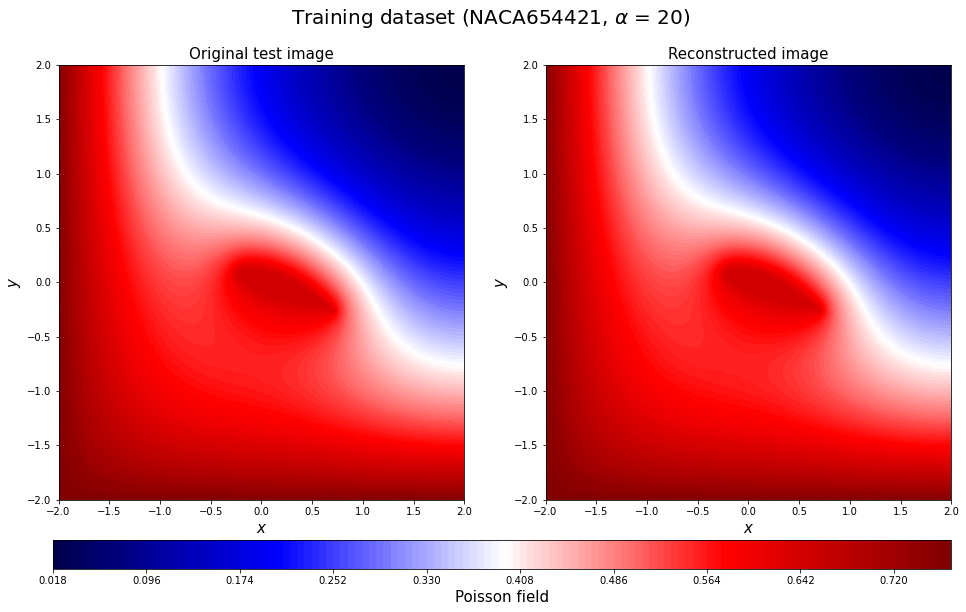

In [67]:
for c in range(0,16):
    plt.figure(figsize=(16, 8))
    y_train0_rotate = y_train[c].reshape(n_grid,n_grid).T
    decoded_rotate = decoded_train[c].reshape(n_grid,n_grid).T

    xrange = np.linspace(-2, 2, n_grid)
    yrange = np.linspace(-2, 2, n_grid)
    xmesh, ymesh = np.meshgrid(xrange, yrange)

    ax = plt.subplot(1, 2, 1)
    a1 = plt.contourf(xmesh, ymesh, y_train0_rotate, vmin=np.min(y_train0_rotate),
                      vmax = np.max(y_train0_rotate), levels=128, cmap='seismic')
    ax.set_xlabel('$x$', fontsize=15)
    ax.set_ylabel('$y$', fontsize=15)
    ax.set_title('Original test image', fontsize=15)

    # Display reconstruction
    ax = plt.subplot(1, 2, 2)
    a2 = plt.contourf(xmesh, ymesh, decoded_rotate, vmin=np.min(y_train0_rotate),
                      vmax = np.max(y_train0_rotate), levels=128, cmap='seismic')
    ax.set_xlabel('$x$', fontsize=15)
    ax.set_ylabel('$y$', fontsize=15)
    ax.set_title('Reconstructed image', fontsize=15)
    cax = plt.axes([0.12, 0.005, 0.78, 0.05])
    cbar = plt.colorbar(a1, cax=cax, orientation="horizontal")
    cbar.set_label('Poisson field', fontsize=15)
    #cbar.set_ticks([-0.5, -0.4, -0.3, -0.2, -0.1, 0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9])

    plt.suptitle(r'Training dataset (%s, $\alpha$ = %d)' %(np.array2string(geo_train[c])[3:-2], aa_train[c]),fontsize=20)
    save_fig_name = "20221030Prediction_Poisson_bc2(training)"+str(np.array2string(geo_train[c])[3:-2])+str(aa_train[c])+".jpg"
    plt.savefig(save_fig_name, dpi=300, bbox_inches='tight', pad_inches=0.3)
    plt.show()

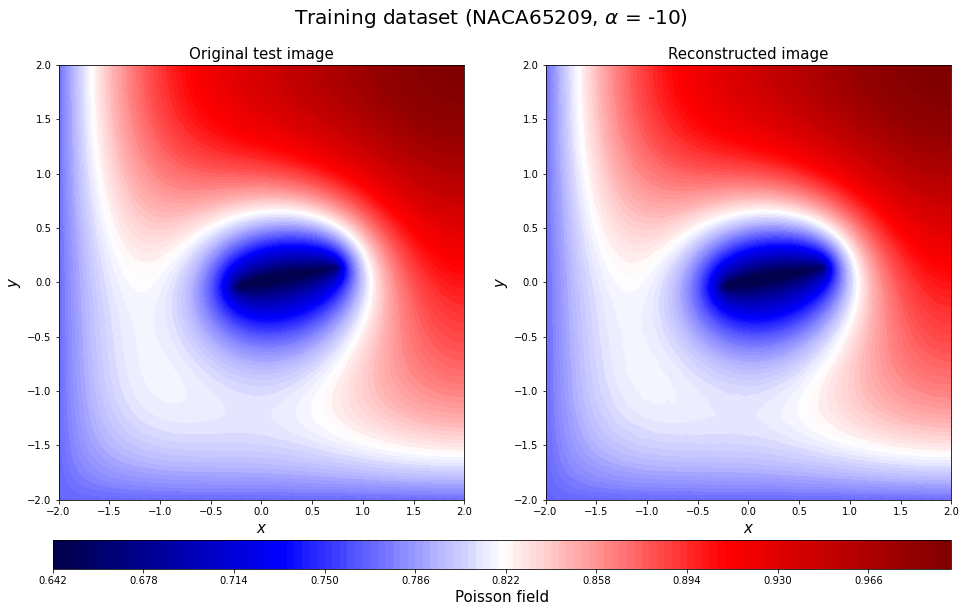

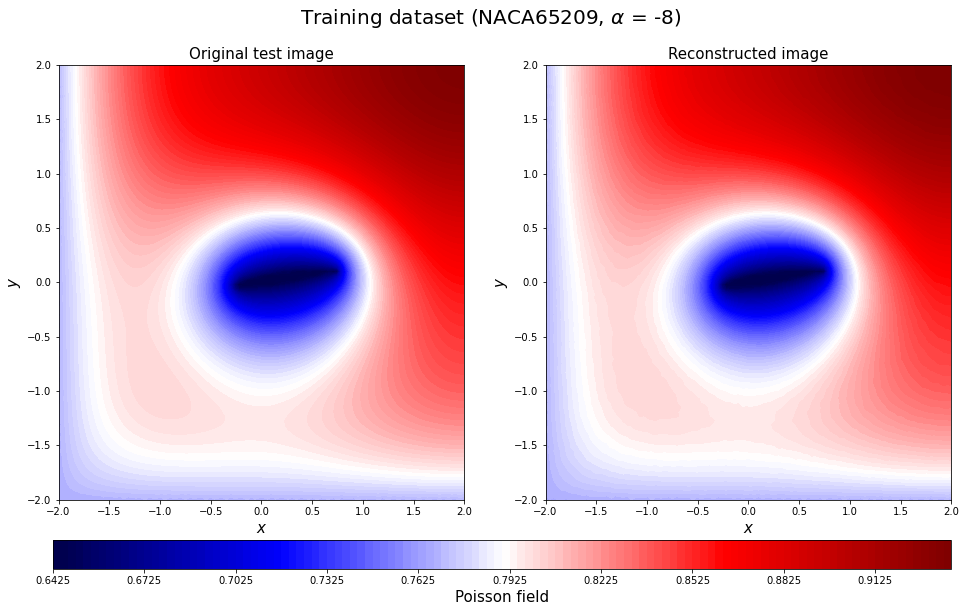

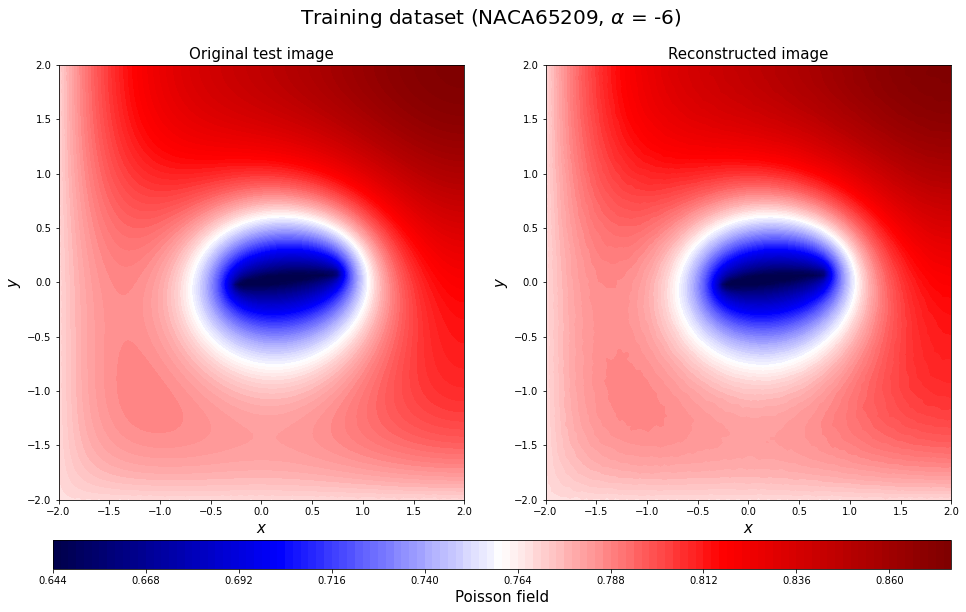

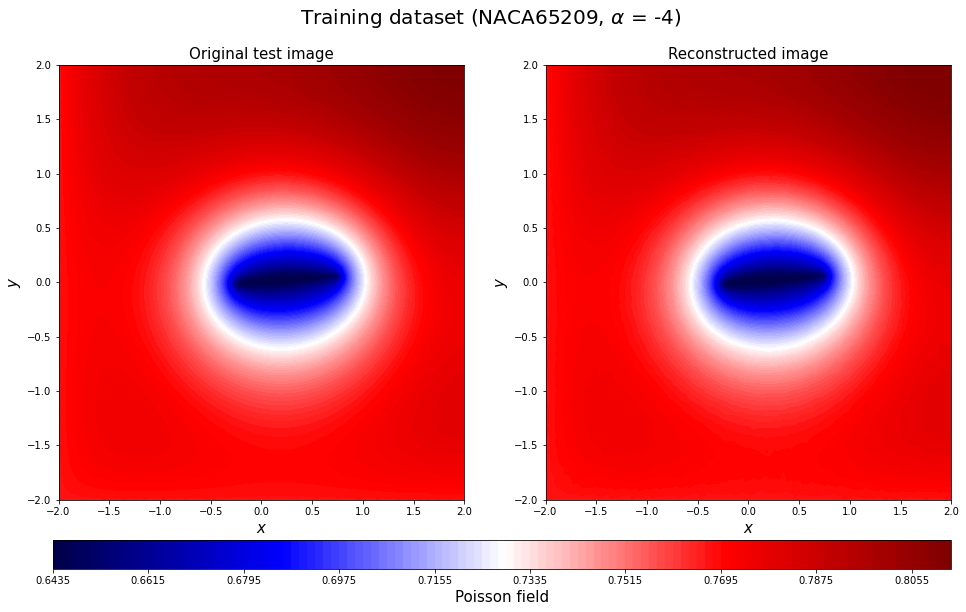

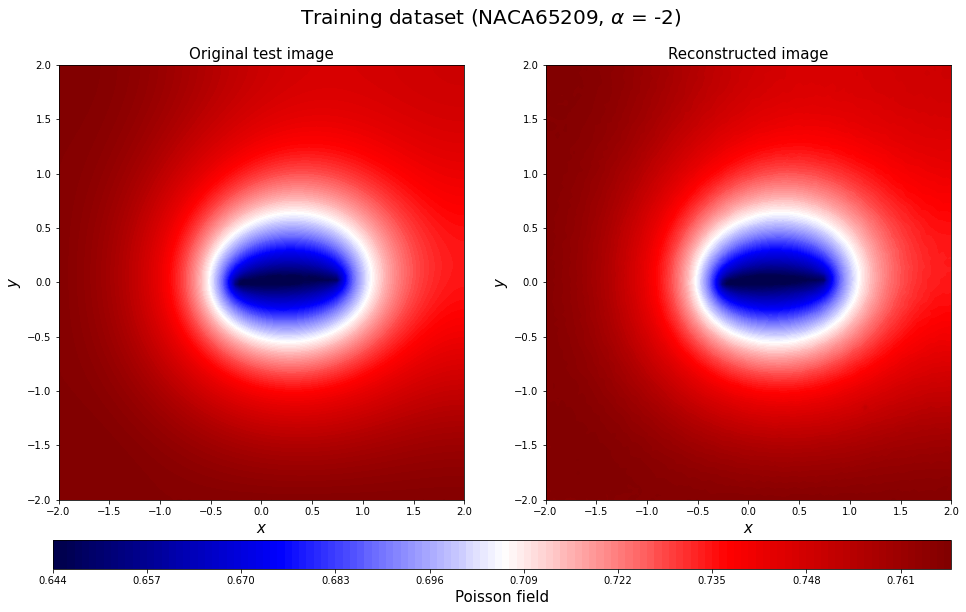

...

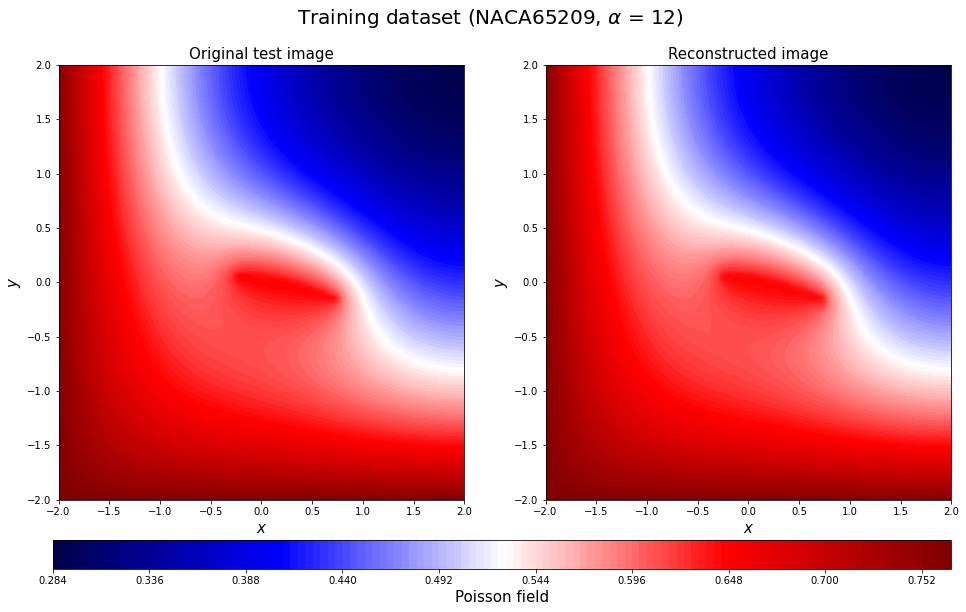

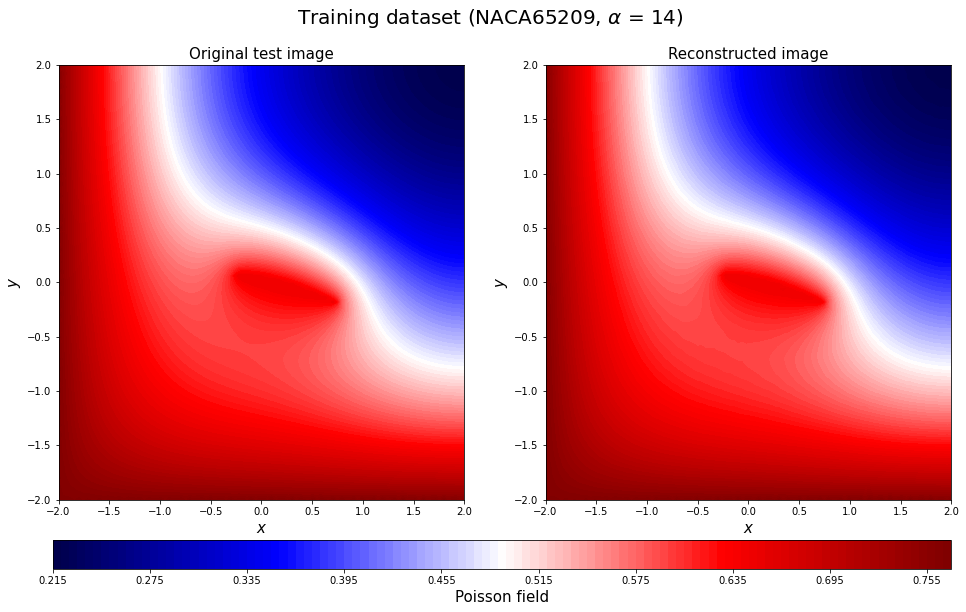

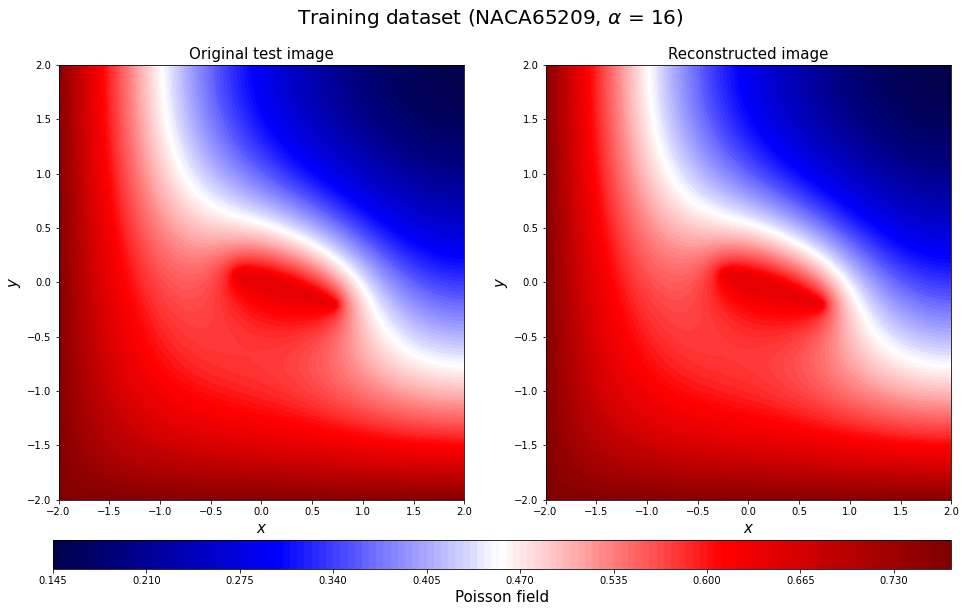

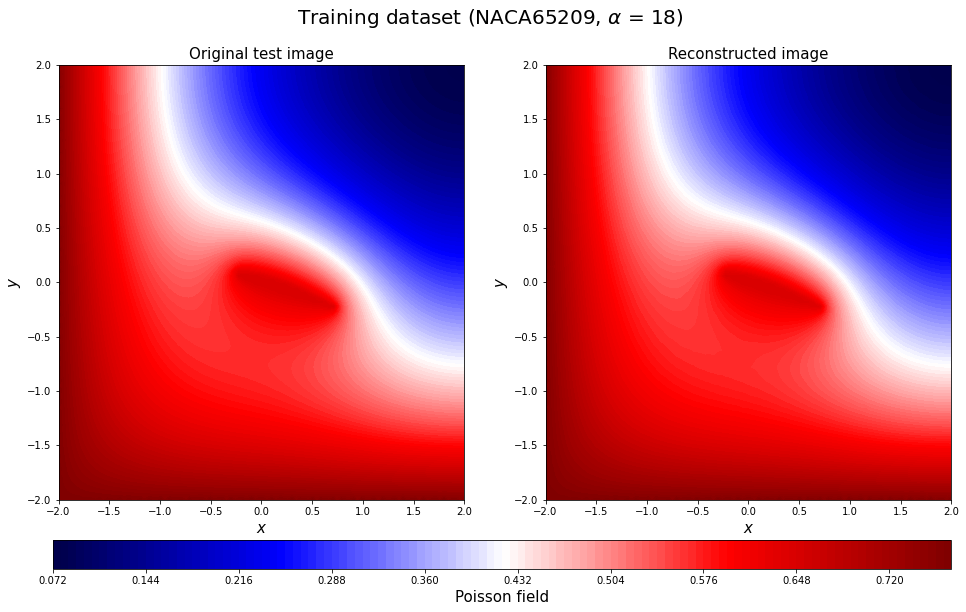

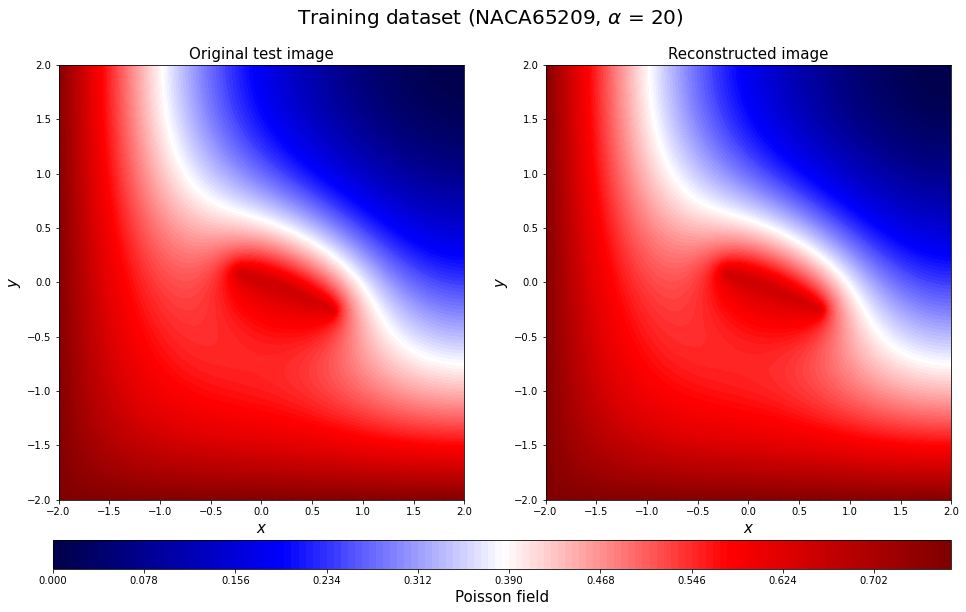

In [68]:
for c in range(0,16):
    plt.figure(figsize=(16, 8))
    y_train20_rotate = y_train[20*16+c].reshape(n_grid,n_grid).T
    decoded_rotate = decoded_train[20*16+c].reshape(n_grid,n_grid).T

    xrange = np.linspace(-2, 2, n_grid)
    yrange = np.linspace(-2, 2, n_grid)
    xmesh, ymesh = np.meshgrid(xrange, yrange)

    ax = plt.subplot(1, 2, 1)
    a1 = plt.contourf(xmesh, ymesh, y_train20_rotate, vmin=np.min(y_train20_rotate),
                      vmax=np.max(y_train20_rotate), levels=128, cmap='seismic')
    ax.set_xlabel('$x$', fontsize=15)
    ax.set_ylabel('$y$', fontsize=15)
    ax.set_title('Original test image', fontsize=15)

    # Display reconstruction
    ax = plt.subplot(1, 2, 2)
    a2 = plt.contourf(xmesh, ymesh, decoded_rotate, vmin=np.min(y_train20_rotate),
                      vmax=np.max(y_train20_rotate), levels=128, cmap='seismic')
    ax.set_xlabel('$x$', fontsize=15)
    ax.set_ylabel('$y$', fontsize=15)
    ax.set_title('Reconstructed image', fontsize=15)
    cax = plt.axes([0.12, 0.005, 0.78, 0.05])
    cbar = plt.colorbar(a1, cax=cax, orientation="horizontal")
    cbar.set_label('Poisson field', fontsize=15)
    #cbar.set_ticks([-0.5, -0.4, -0.3, -0.2, -0.1, 0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9])

    plt.suptitle(r'Training dataset (%s, $\alpha$ = %d)' %(np.array2string(geo_train[20*16+c])[3:-2], aa_train[20*16+c]),fontsize=20)
    save_fig_name = "20221030Prediction_Poisson_bc2(training)"+str(np.array2string(geo_train[20*16+c])[3:-2])+str(aa_train[20*16+c])+".jpg"
    plt.savefig(save_fig_name, dpi=300, bbox_inches='tight', pad_inches=0.3)
    plt.show()

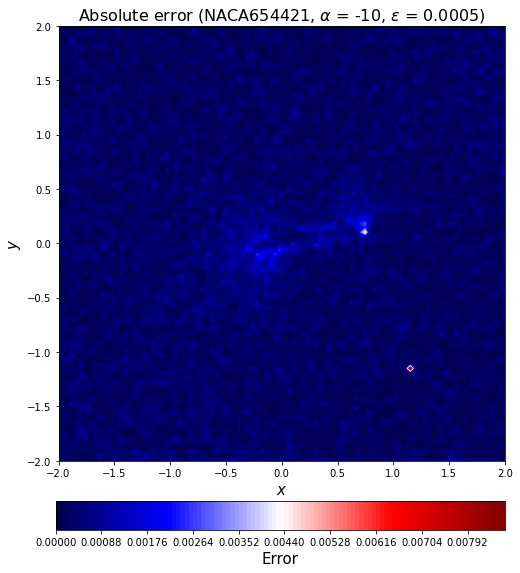

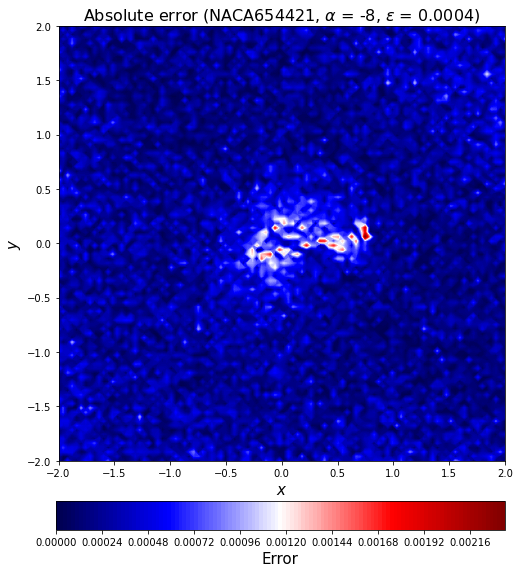

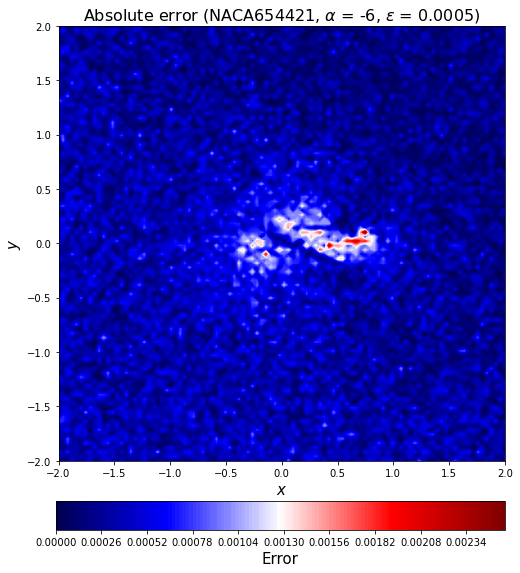

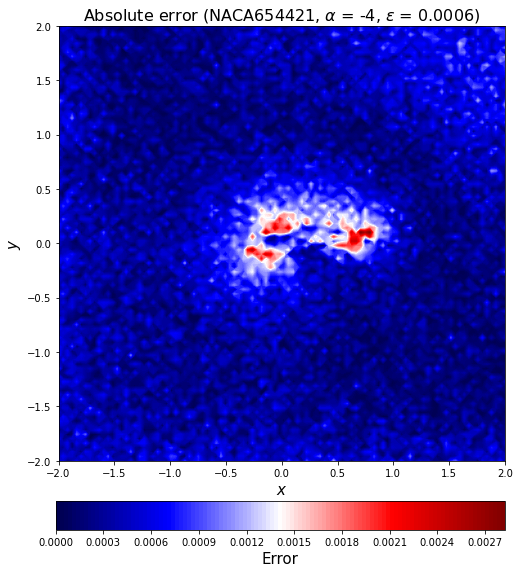

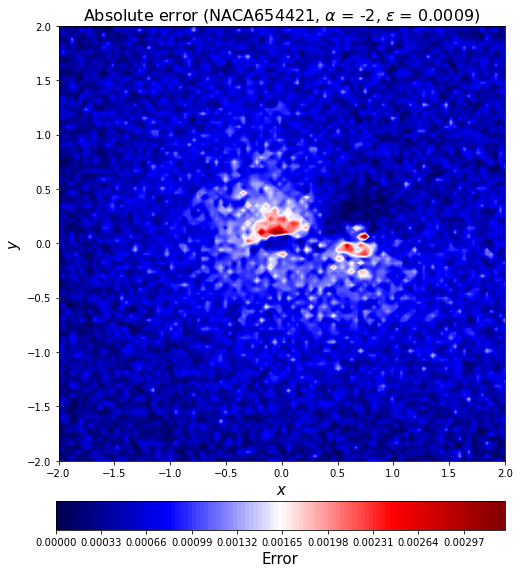

...

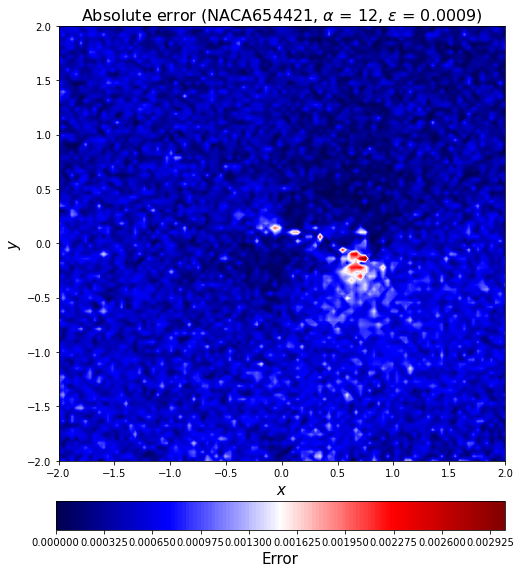

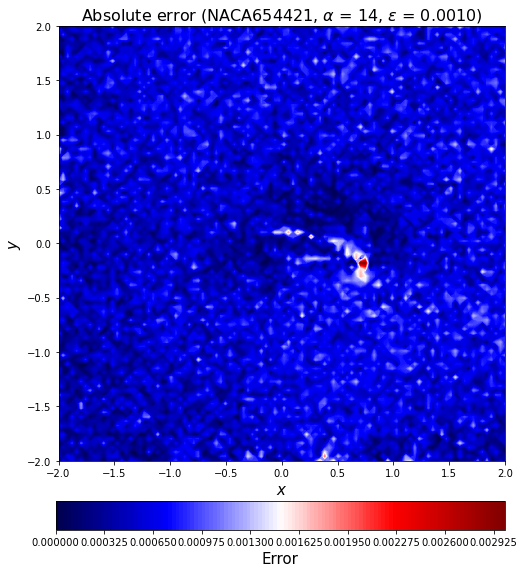

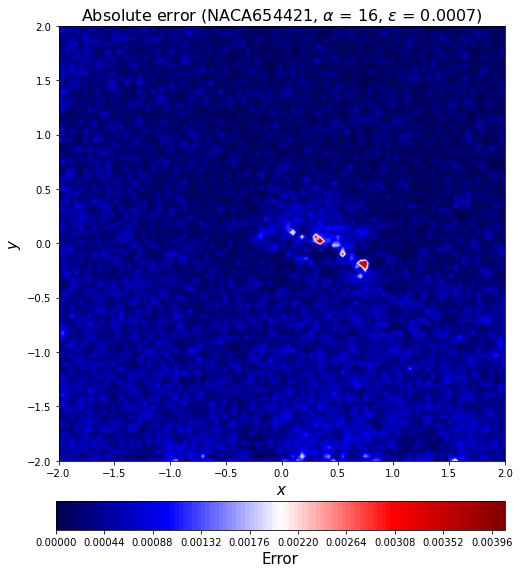

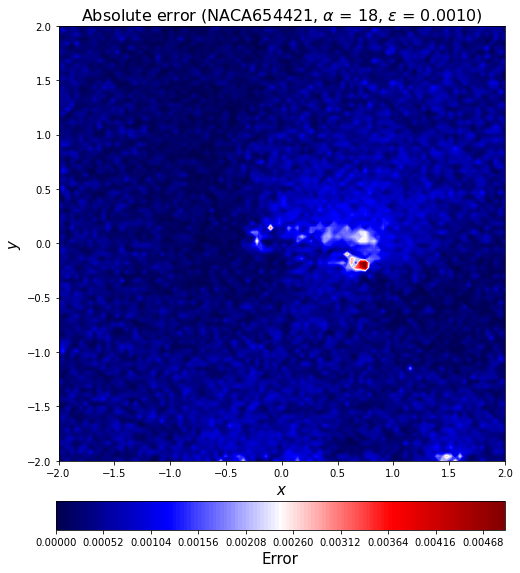

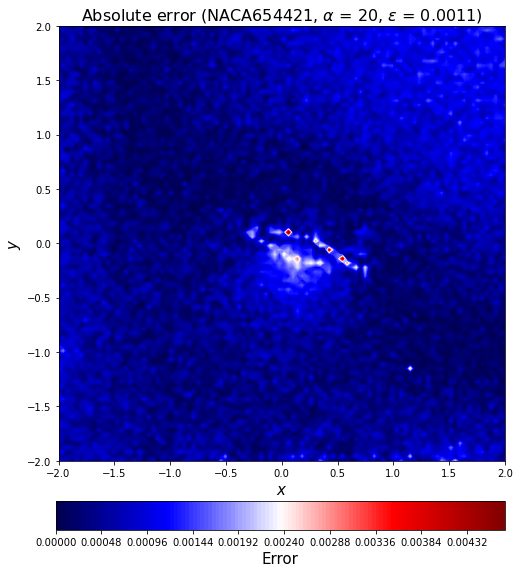

In [69]:
for c in range(0,16):
    error_train_abs2_rotate = error_train_abs[c].reshape(n_grid,n_grid).T

    fig5 = plt.figure(figsize = (8, 8))
    ax5 = fig5.add_subplot(111)
    mappable = ax5.contourf(xmesh, ymesh, error_train_abs2_rotate, levels=128, cmap='seismic')
    ax5.set_title(r'Absolute error (%s, $\alpha$ = %d, $\epsilon$ = %.4f)' %(np.array2string(geo_train[c])[3:-2],
                                                                             aa_train[c], l2_error_train_list[c]), fontsize=16)
    ax5.set_xlabel('$x$', fontsize=15)
    ax5.set_ylabel('$y$', fontsize=15)

    cax = plt.axes([0.12, 0.005, 0.78, 0.05])
    cbar = plt.colorbar(mappable, cax=cax, orientation="horizontal")
    cbar.set_label('Error', fontsize=15)

    save_fig_name = "20221030PredictionError_Poisson_bc2(training)"+str(np.array2string(geo_train[c])[3:-2])+str(aa_train[c])[3:-2]+".jpg"
    plt.savefig(save_fig_name, dpi=300, bbox_inches='tight', pad_inches=0.3)
    plt.show()

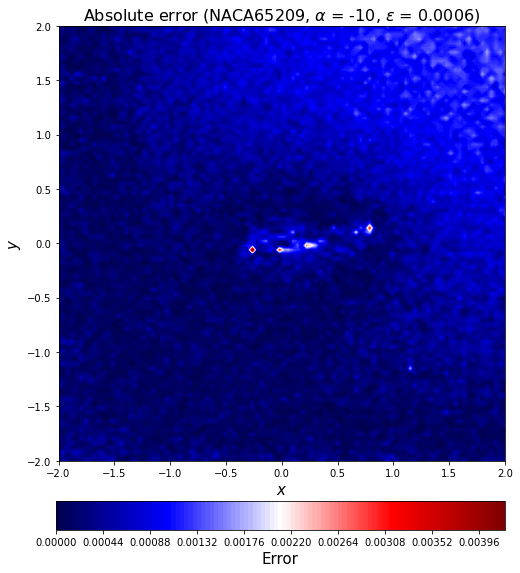

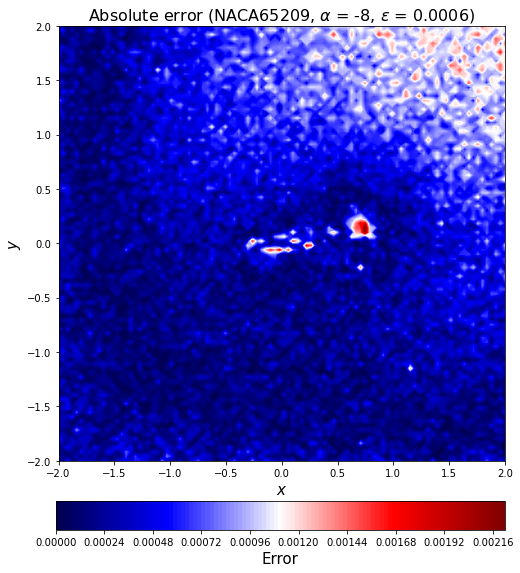

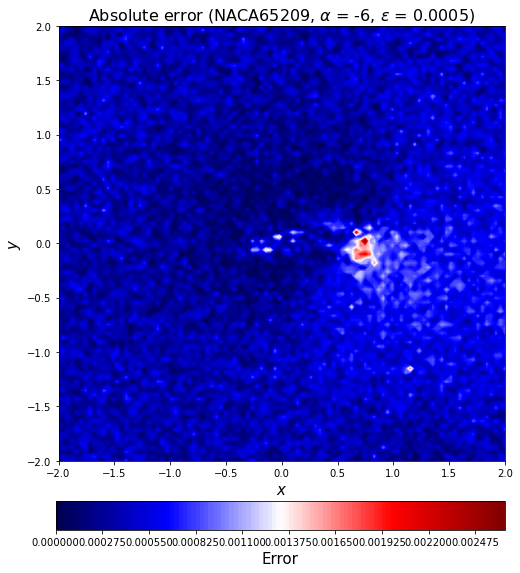

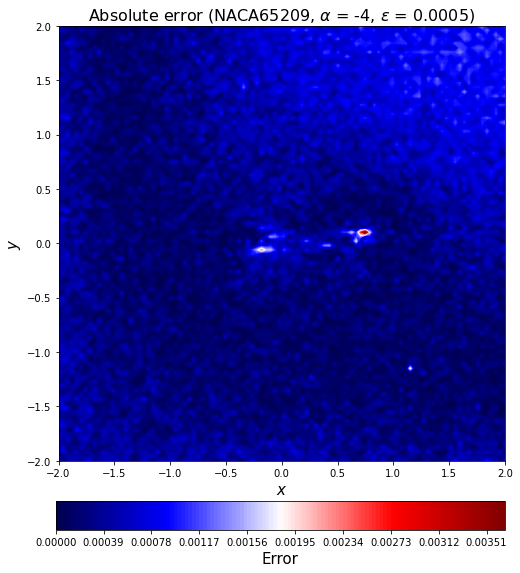

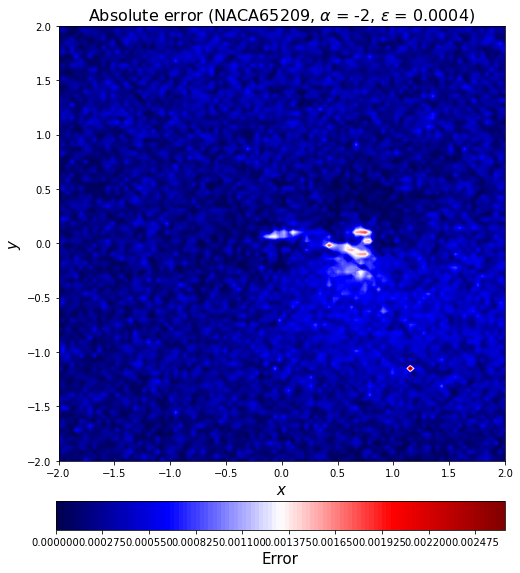

...

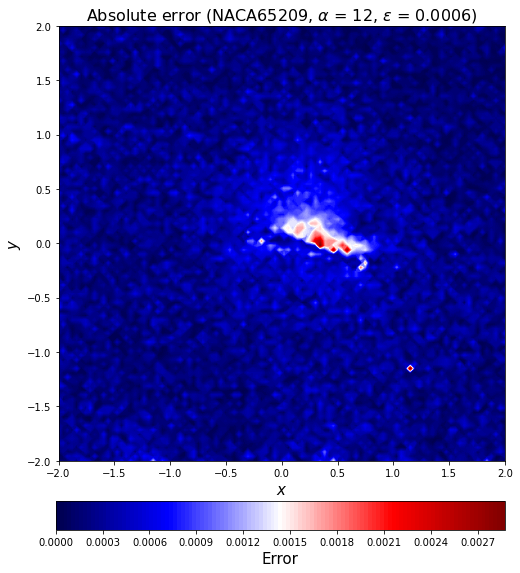

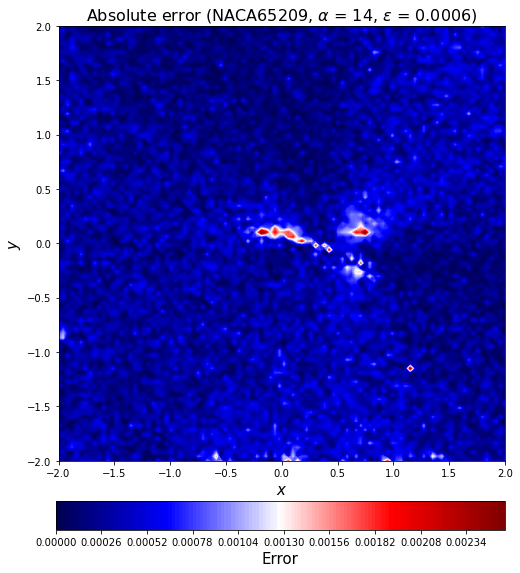

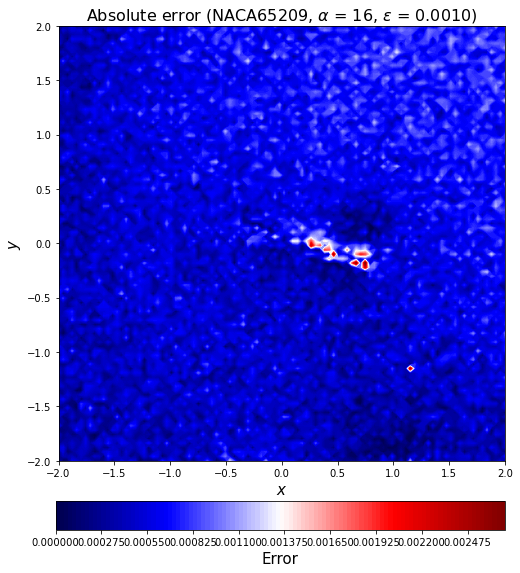

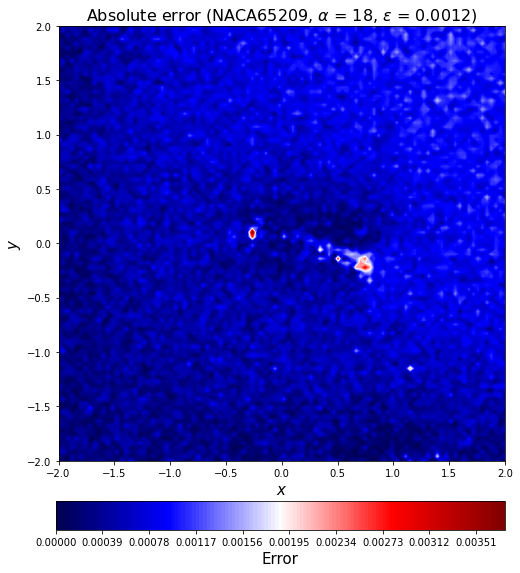

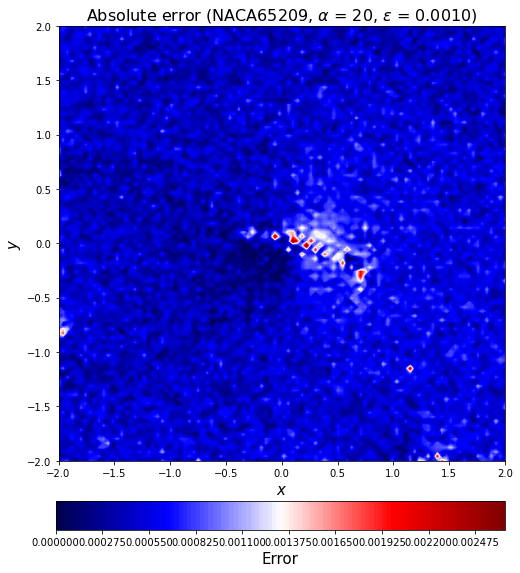

In [70]:
for c in range(0,16):
    error_train_abs2_rotate = error_train_abs[16*20+c].reshape(n_grid,n_grid).T

    fig5 = plt.figure(figsize = (8, 8))
    ax5 = fig5.add_subplot(111)
    mappable = ax5.contourf(xmesh, ymesh, error_train_abs2_rotate, levels=128, cmap='seismic')
    ax5.set_title(r'Absolute error (%s, $\alpha$ = %d, $\epsilon$ = %.4f)' %(np.array2string(geo_train[16*20+c])[3:-2],
                                                                             aa_train[16*20+c], l2_error_train_list[16*20+c]),fontsize=16)
    ax5.set_xlabel('$x$', fontsize=15)
    ax5.set_ylabel('$y$', fontsize=15)

    cax = plt.axes([0.12, 0.005, 0.78, 0.05])
    cbar = plt.colorbar(mappable, cax=cax, orientation="horizontal")
    cbar.set_label('Error', fontsize=15)

    save_fig_name = "20221030PredictionError_Poisson_bc2(training)"+str(np.array2string(geo_train[16*20+c])[3:-2])+str(aa_train[16*20+c])+".jpg"
    plt.savefig(save_fig_name, dpi=300, bbox_inches='tight', pad_inches=0.3)
    plt.show()

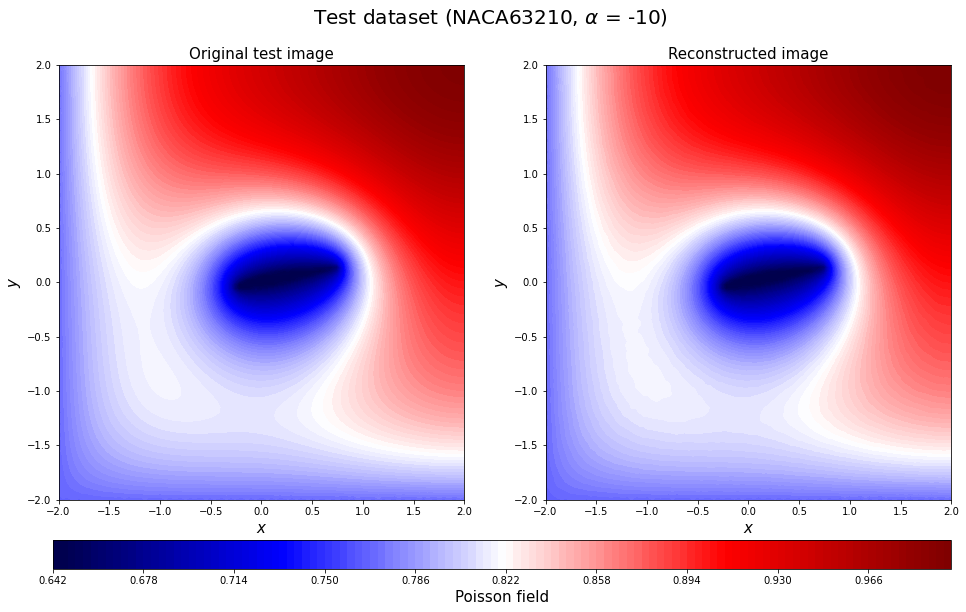

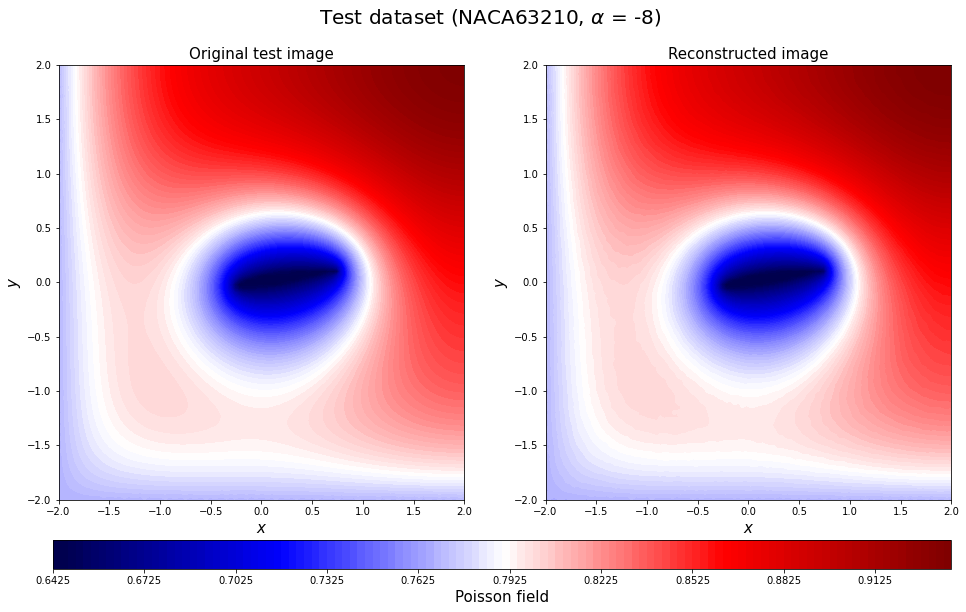

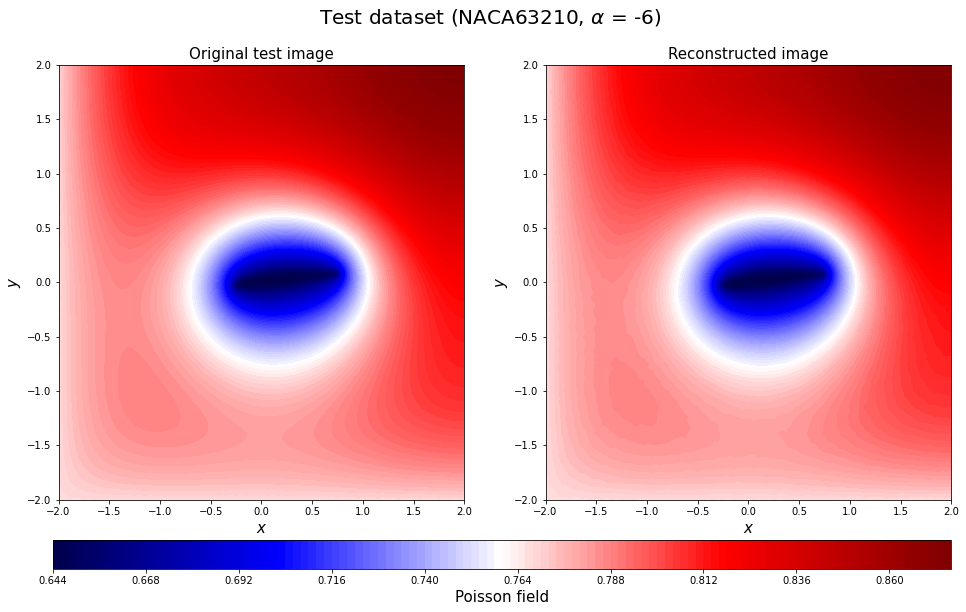

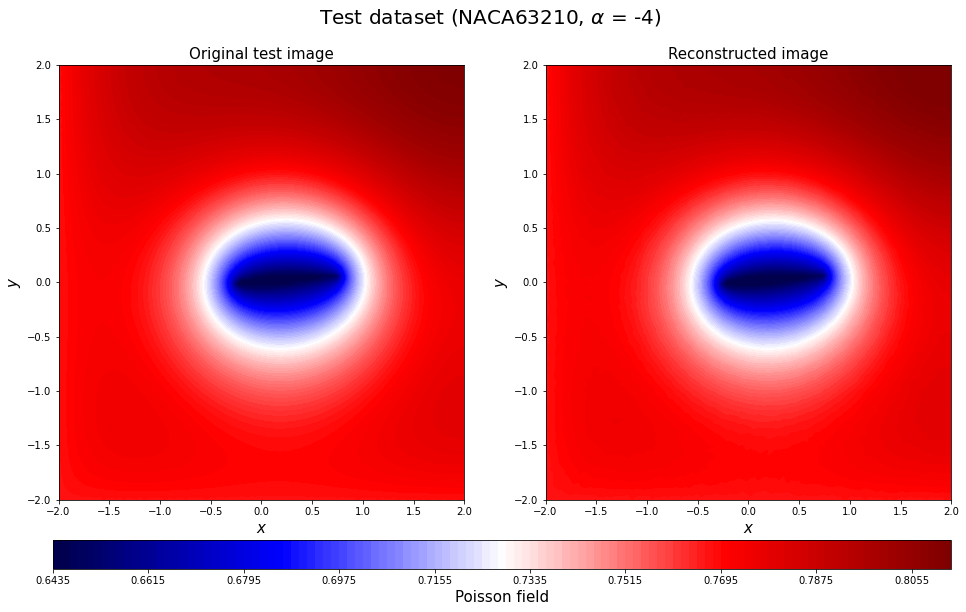

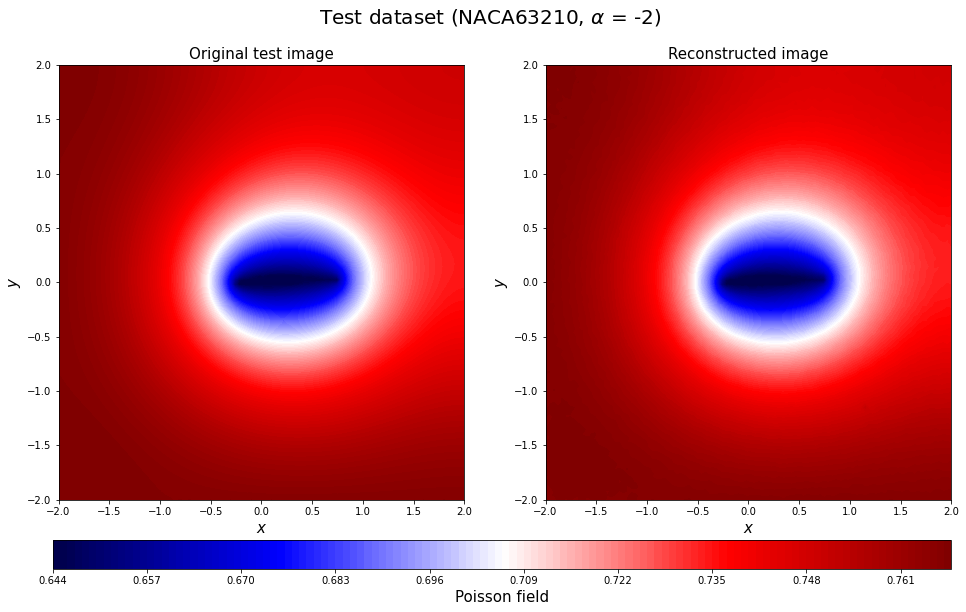

...

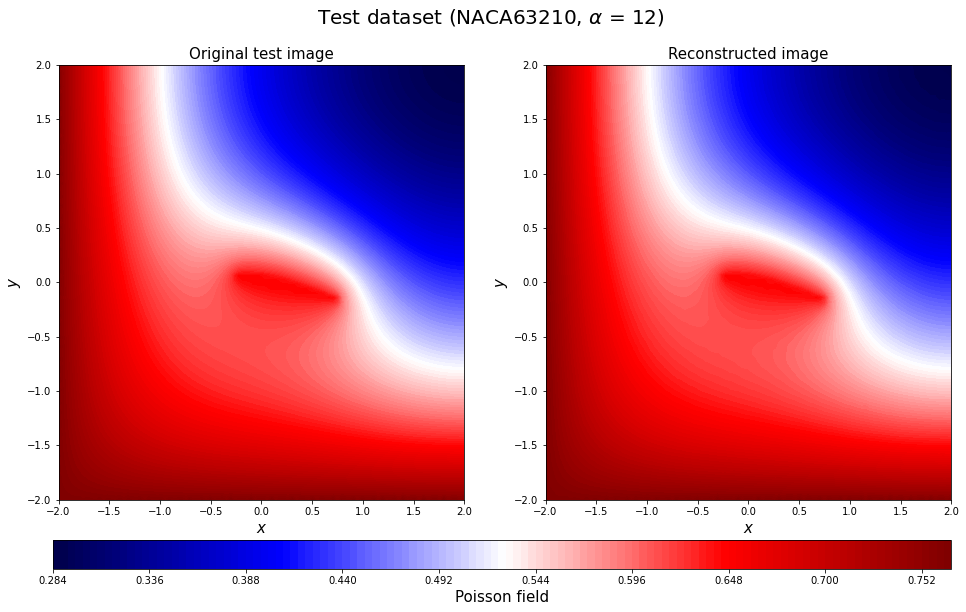

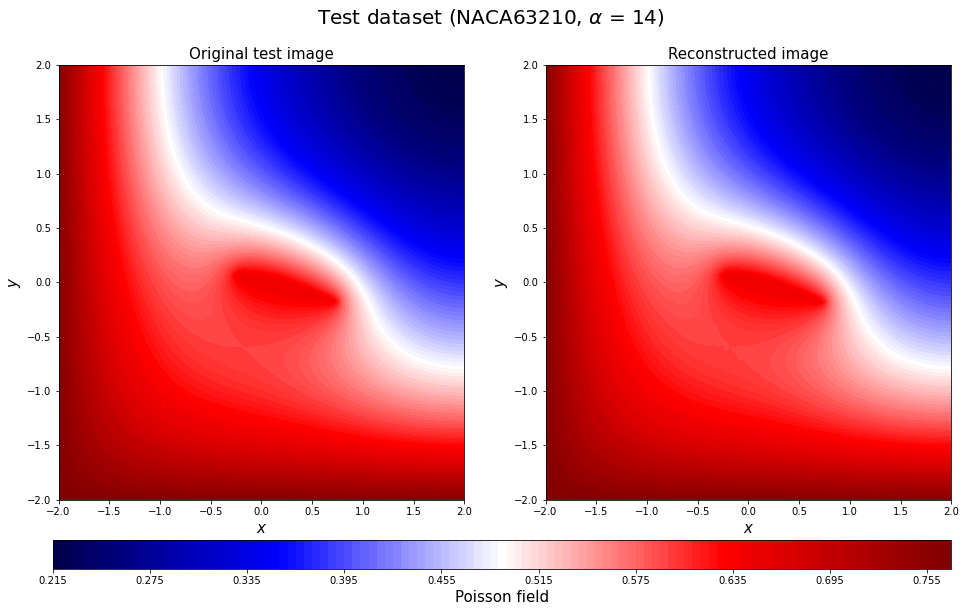

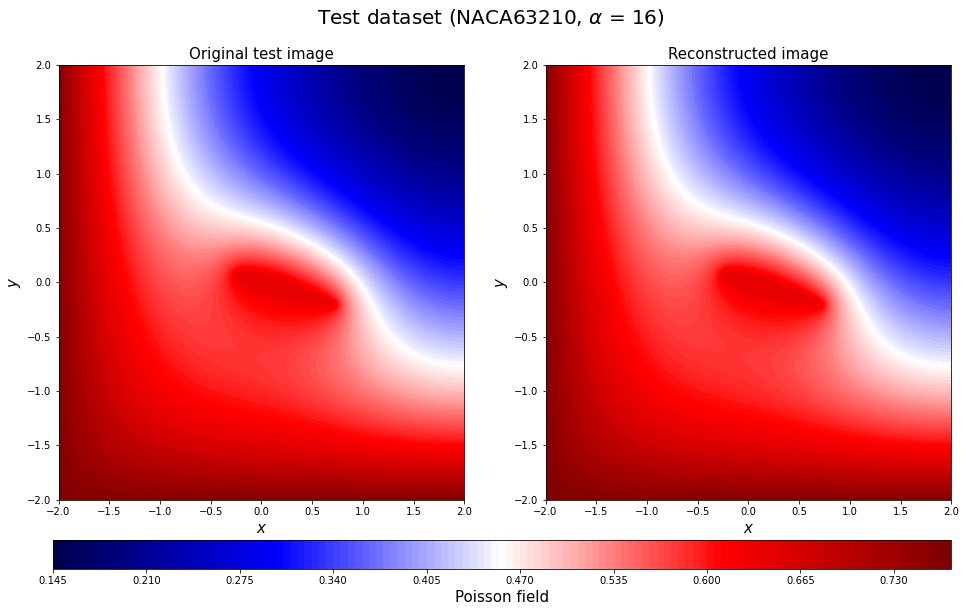

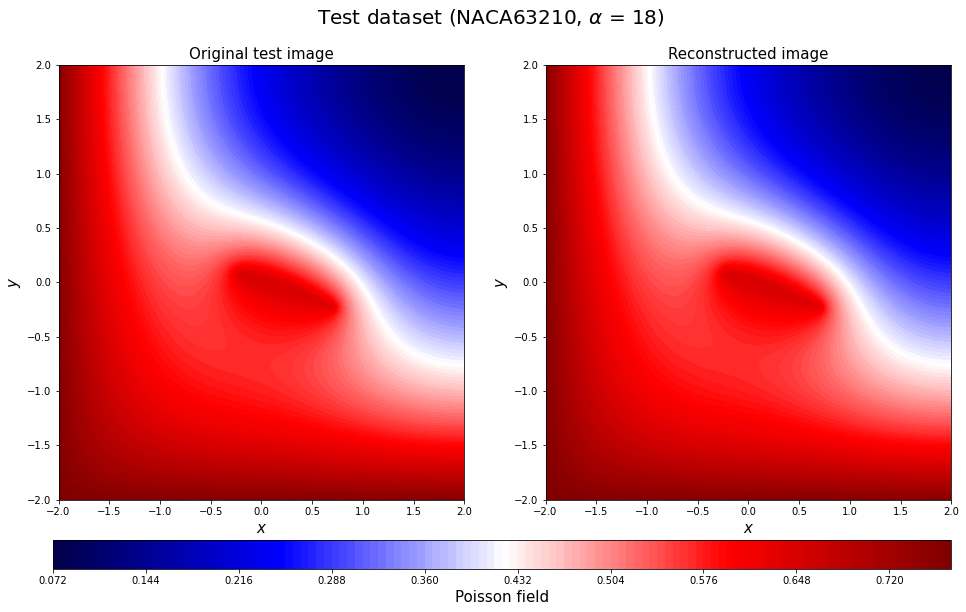

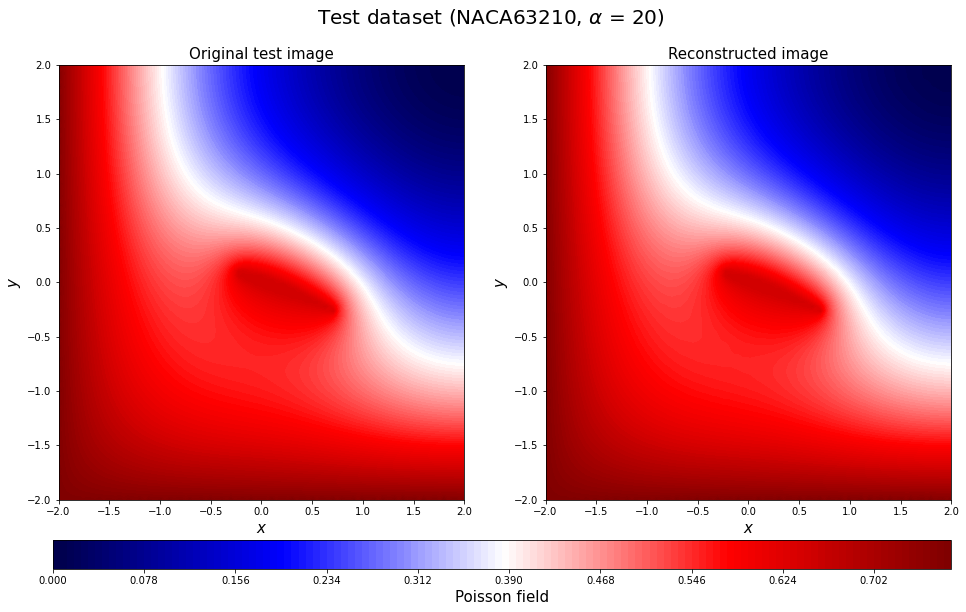

In [71]:
for c in range(0,16):
    plt.figure(figsize=(16, 8))
    y_test2_rotate = y_test[2*16+c].reshape(n_grid,n_grid).T
    decoded_rotate = decoded_test[2*16+c].reshape(n_grid,n_grid).T

    xrange = np.linspace(-2, 2, n_grid)
    yrange = np.linspace(-2, 2, n_grid)
    xmesh, ymesh = np.meshgrid(xrange, yrange)

    ax = plt.subplot(1, 2, 1)
    a1 = plt.contourf(xmesh, ymesh, y_test2_rotate, vmin=np.min(y_test2_rotate), 
                      vmax=np.max(y_test2_rotate), levels=128, cmap='seismic')
    ax.set_xlabel('$x$', fontsize=15)
    ax.set_ylabel('$y$', fontsize=15)
    ax.set_title('Original test image', fontsize=15)

    # Display reconstruction
    ax = plt.subplot(1, 2, 2)
    a2 = plt.contourf(xmesh, ymesh, decoded_rotate, vmin=np.min(y_test2_rotate), 
                      vmax=np.max(y_test2_rotate), levels=128, cmap='seismic')
    ax.set_xlabel('$x$', fontsize=15)
    ax.set_ylabel('$y$', fontsize=15)
    ax.set_title('Reconstructed image', fontsize=15)
    cax = plt.axes([0.12, 0.005, 0.78, 0.05])
    cbar = plt.colorbar(a1, cax=cax, orientation="horizontal")
    cbar.set_label('Poisson field', fontsize=15)
    #cbar.set_ticks([-0.5, -0.4, -0.3, -0.2, -0.1, 0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9])

    plt.suptitle(r'Test dataset (%s, $\alpha$ = %d)' %(np.array2string(geo_test[2*16+c])[3:-2], aa_test[2*16+c]),fontsize=20)
    save_fig_name = "20221030Prediction_Poisson_bc2(test)"+str(np.array2string(geo_test[2*16+c])[3:-2])+str(aa_test[2*16+c])+".jpg"
    plt.savefig(save_fig_name, dpi=300, bbox_inches='tight', pad_inches=0.3)
    plt.show()

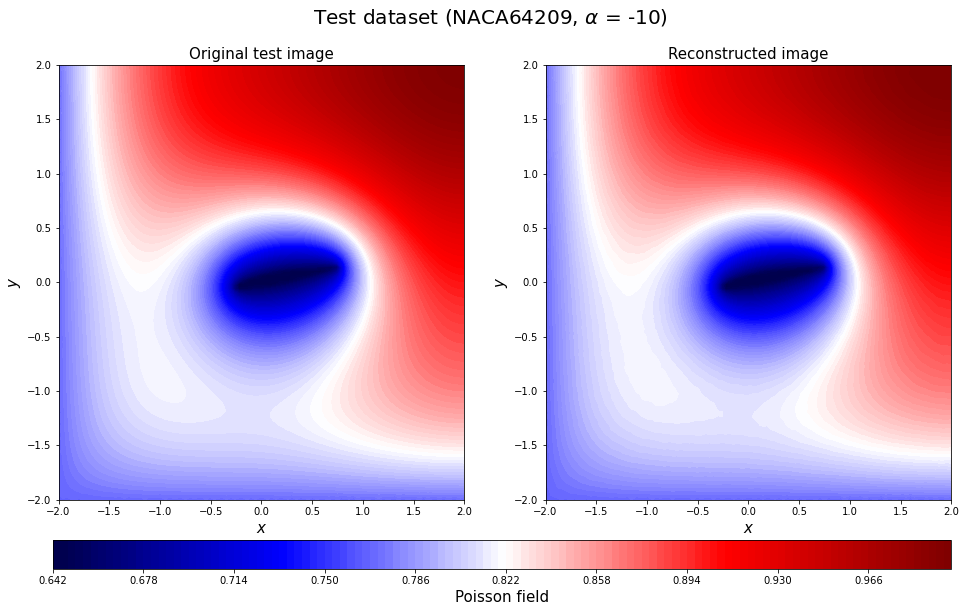

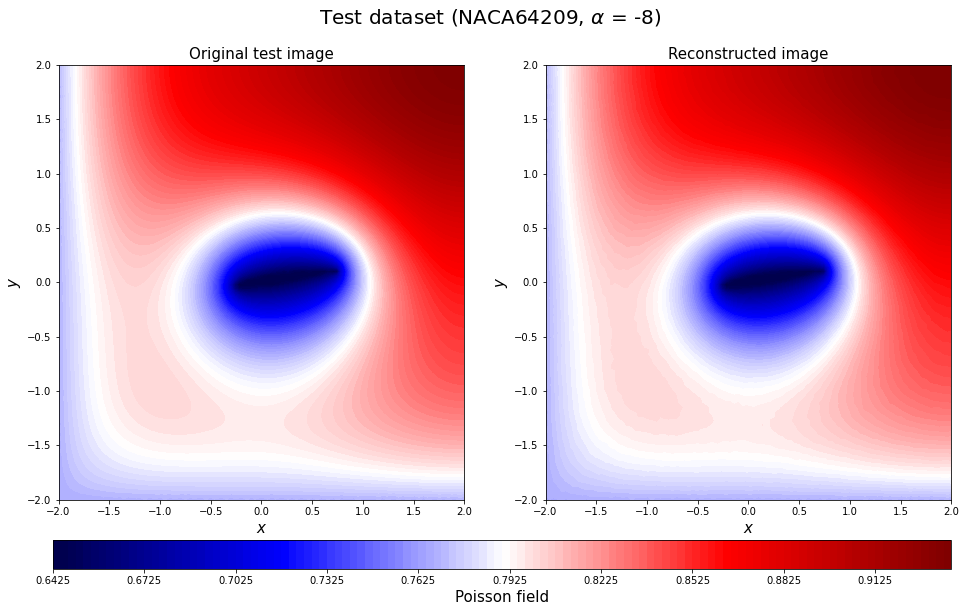

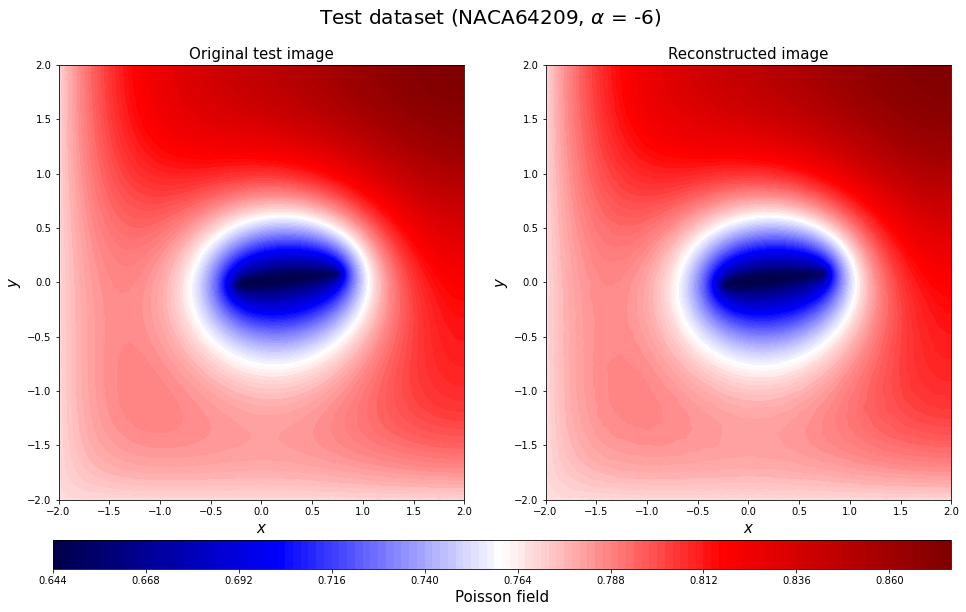

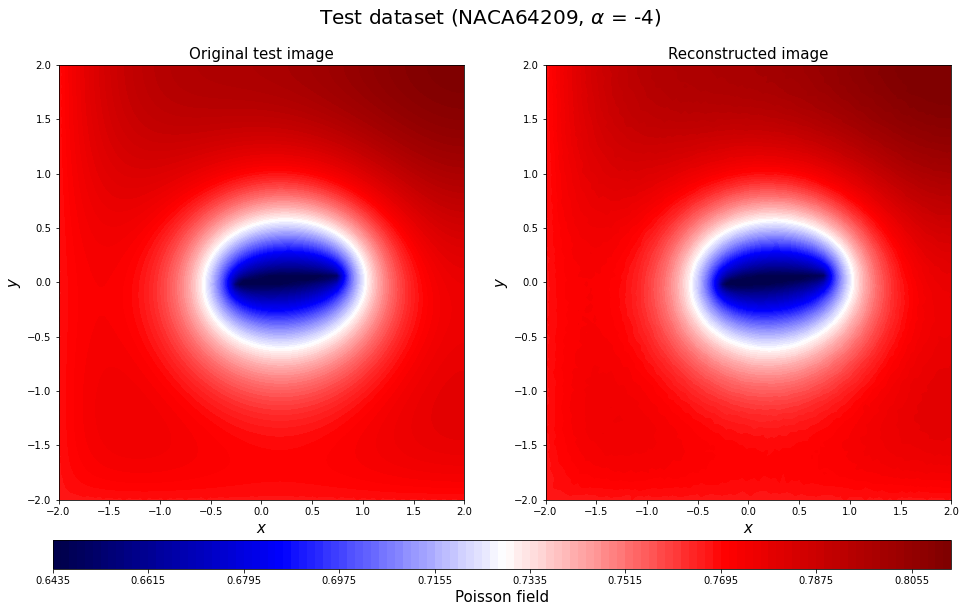

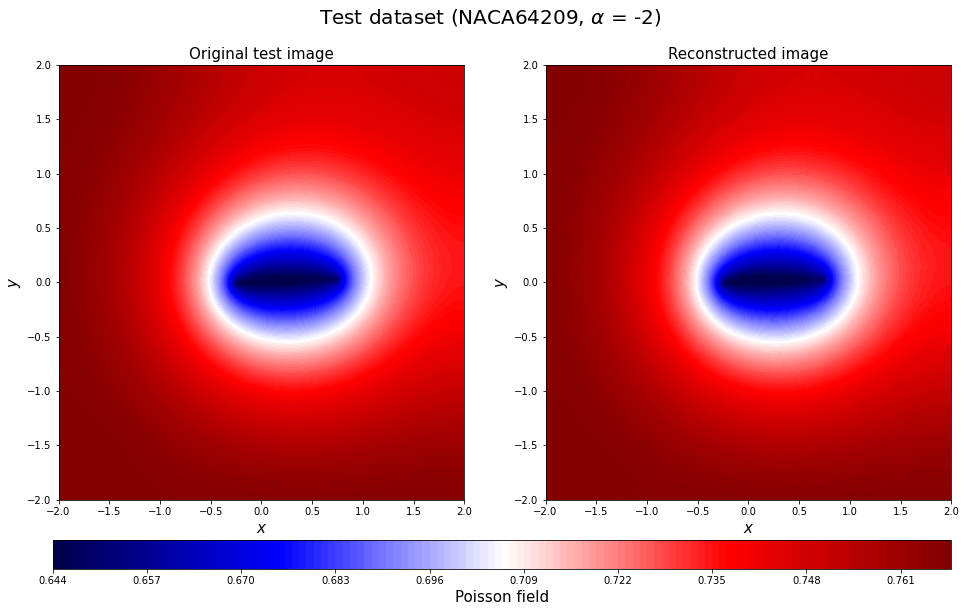

...

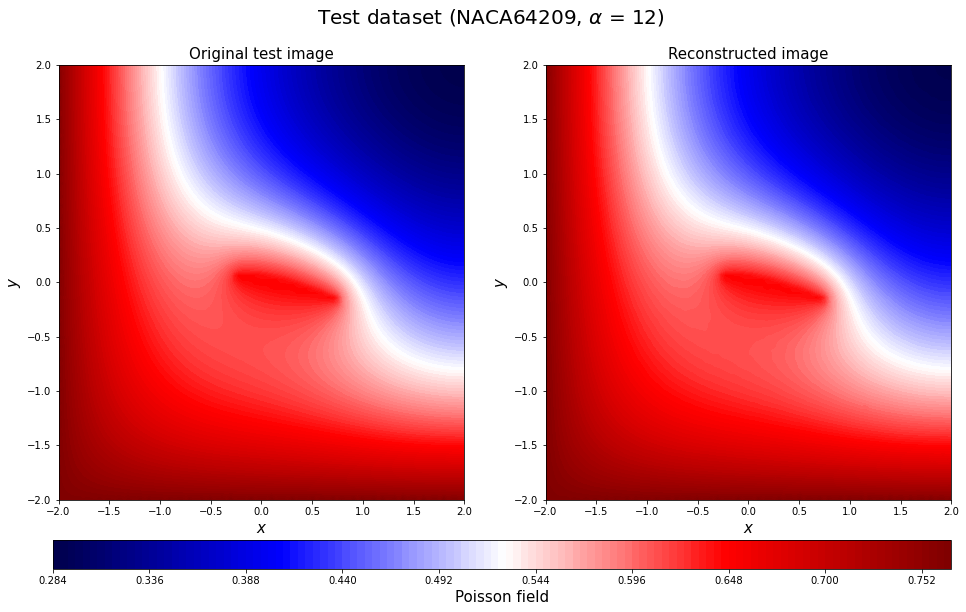

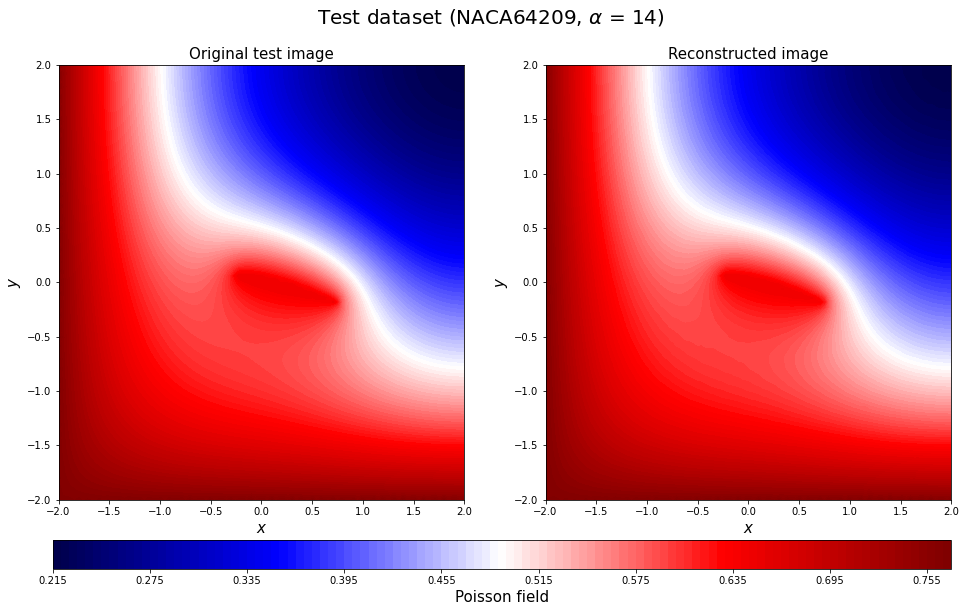

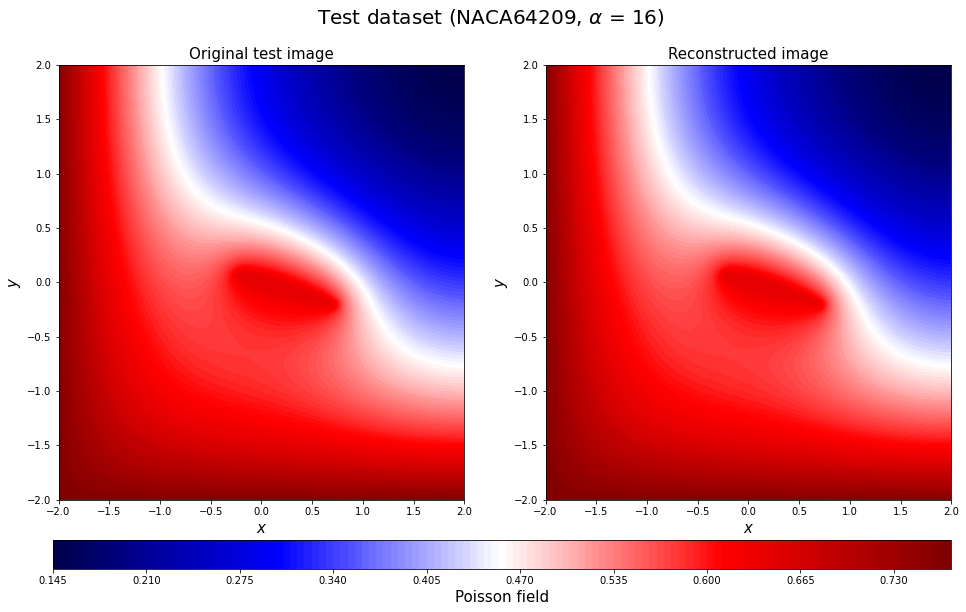

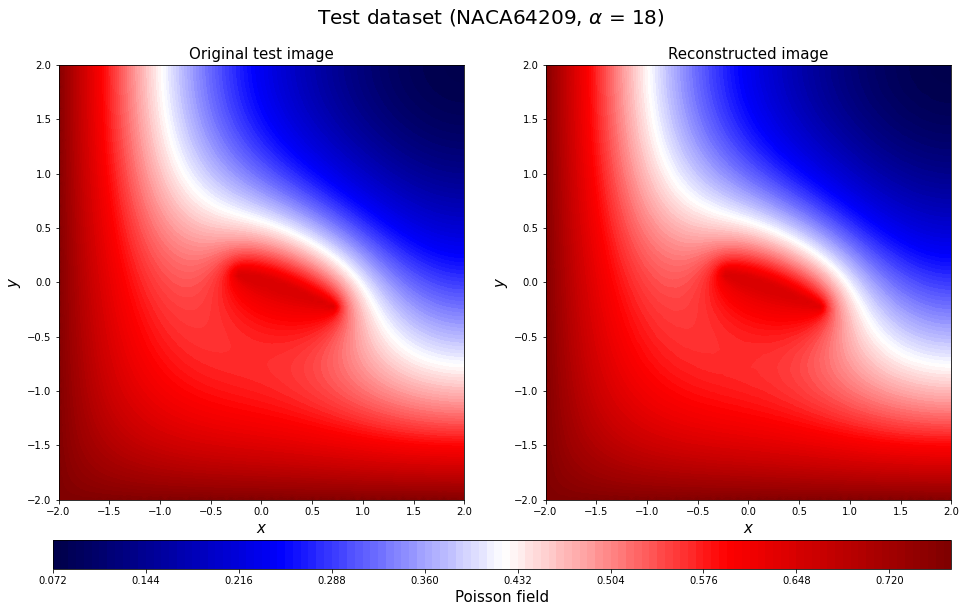

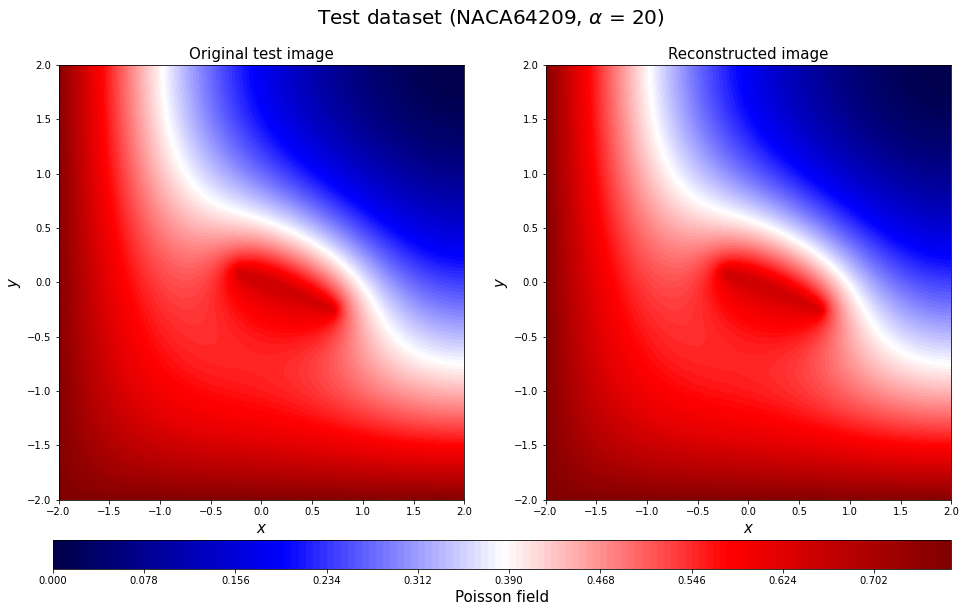

In [72]:
for c in range(0,16):
    plt.figure(figsize=(16, 8))
    y_test0_rotate = y_test[c].reshape(n_grid,n_grid).T
    decoded_rotate = decoded_test[c].reshape(n_grid,n_grid).T

    xrange = np.linspace(-2, 2, n_grid)
    yrange = np.linspace(-2, 2, n_grid)
    xmesh, ymesh = np.meshgrid(xrange, yrange)

    ax = plt.subplot(1, 2, 1)
    a1 = plt.contourf(xmesh, ymesh, y_test0_rotate, vmin=np.min(y_test0_rotate),
                      vmax=np.max(y_test0_rotate), levels=128, cmap='seismic')
    ax.set_xlabel('$x$', fontsize=15)
    ax.set_ylabel('$y$', fontsize=15)
    ax.set_title('Original test image', fontsize=15)

    # Display reconstruction
    ax = plt.subplot(1, 2, 2)
    a2 = plt.contourf(xmesh, ymesh, decoded_rotate, vmin=np.min(y_test0_rotate),
                      vmax=np.max(y_test0_rotate), levels=128, cmap='seismic')
    ax.set_xlabel('$x$', fontsize=15)
    ax.set_ylabel('$y$', fontsize=15)
    ax.set_title('Reconstructed image', fontsize=15)
    cax = plt.axes([0.12, 0.005, 0.78, 0.05])
    cbar = plt.colorbar(a1, cax=cax, orientation="horizontal")
    cbar.set_label('Poisson field', fontsize=15)
    #cbar.set_ticks([-0.5, -0.4, -0.3, -0.2, -0.1, 0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9])

    plt.suptitle(r'Test dataset (%s, $\alpha$ = %d)' %(np.array2string(geo_test[c])[3:-2], aa_test[c]),fontsize=20)
    save_fig_name = "20221030Prediction_Poisson_bc2(test)"+str(np.array2string(geo_test[c])[3:-2])+str(aa_test[c])+".jpg"
    plt.savefig(save_fig_name, dpi=300, bbox_inches='tight', pad_inches=0.3)
    plt.show()

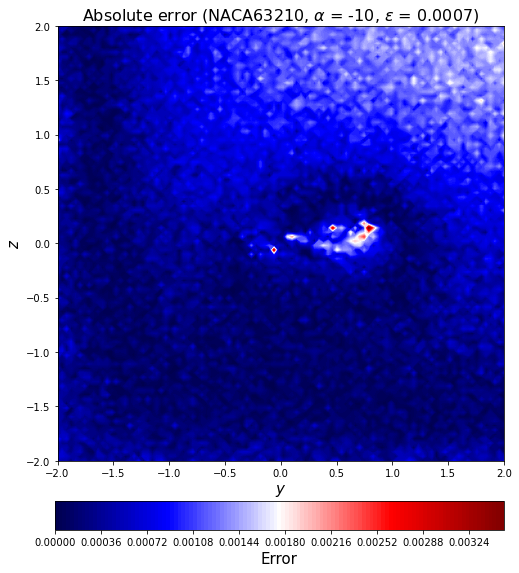

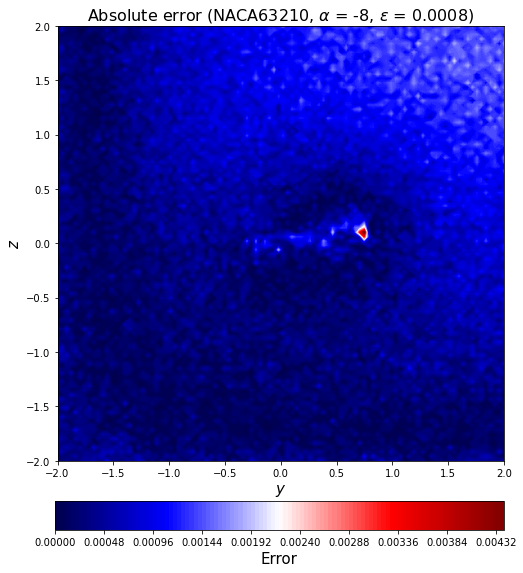

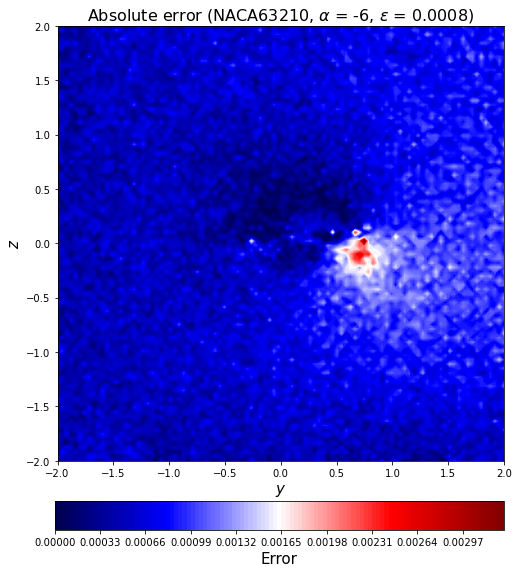

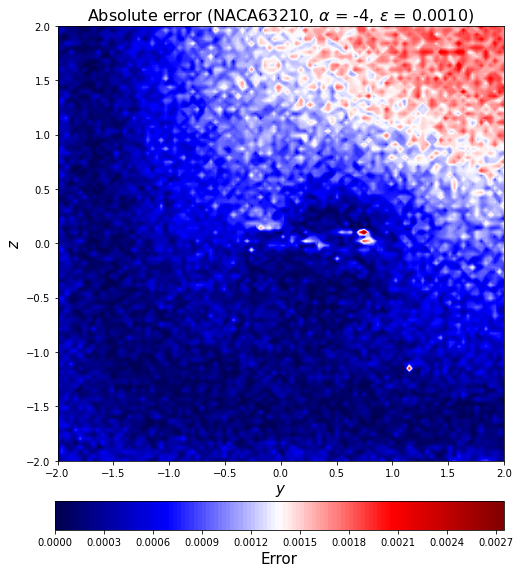

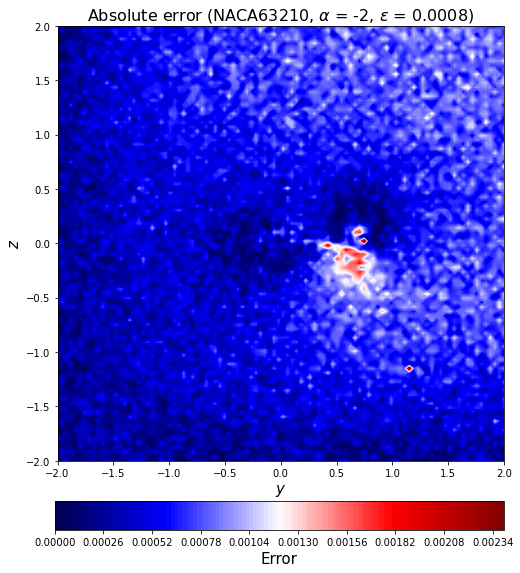

...

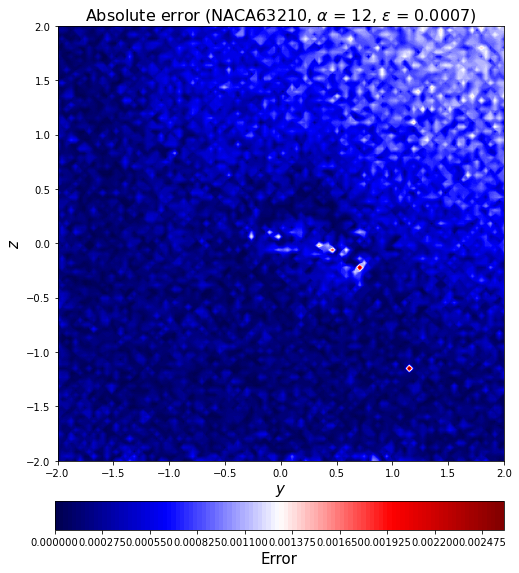

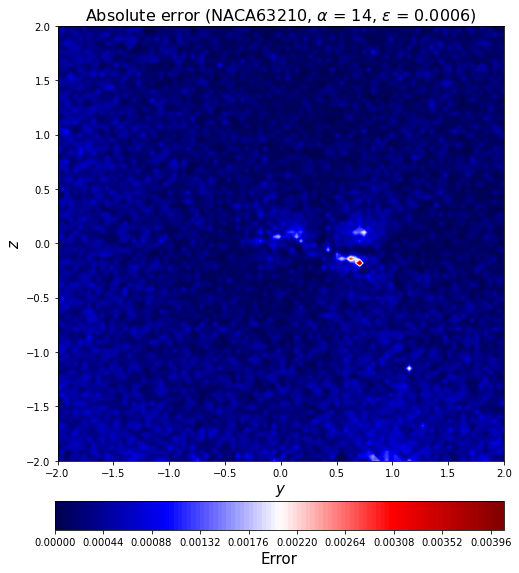

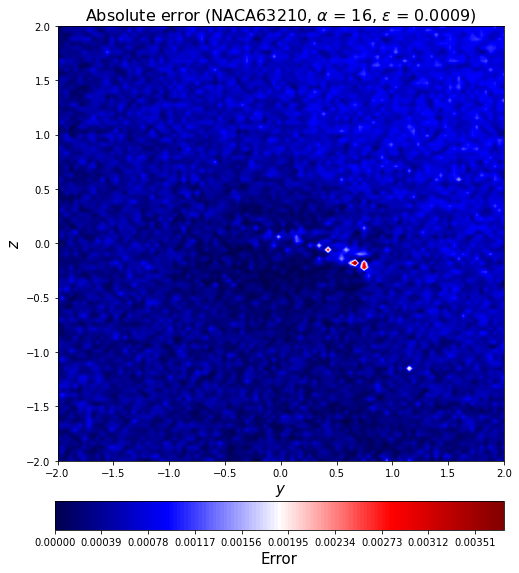

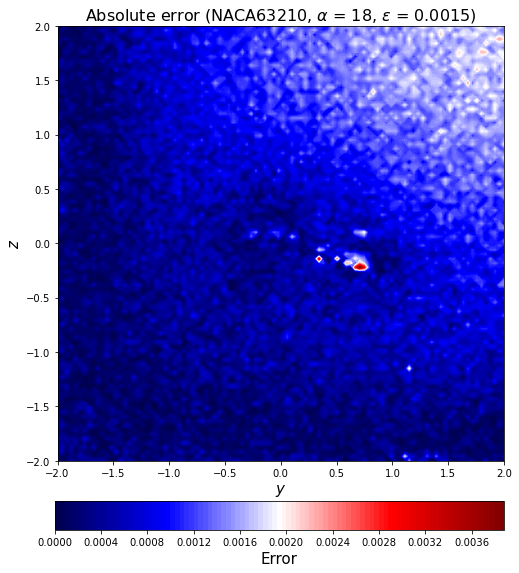

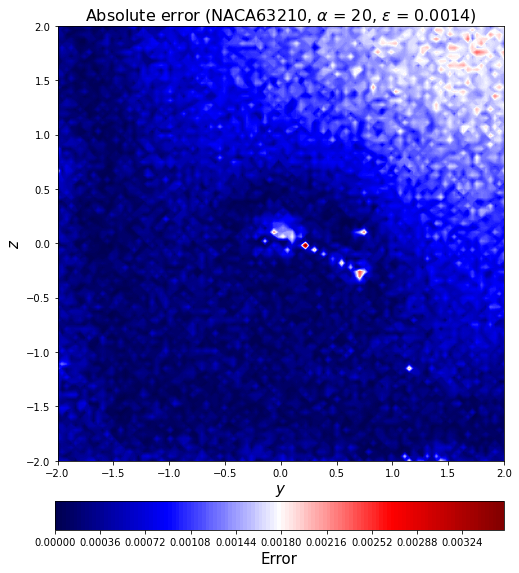

In [73]:
for c in range(0,16):
    error_test_abs2_rotate = error_test_abs[2*16+c].reshape(n_grid,n_grid).T

    fig5 = plt.figure(figsize = (8, 8))
    ax5 = fig5.add_subplot(111)
    mappable = ax5.contourf(xmesh, ymesh, error_test_abs2_rotate, levels=128, cmap='seismic')
    ax5.set_title(r'Absolute error (%s, $\alpha$ = %d, $\epsilon$ = %.4f)' %(np.array2string(geo_test[2*16+c])[3:-2],
                                                                       aa_test[2*16+c], l2_error_test_list[2*16+c]), fontsize=16)
    ax5.set_xlabel('$y$', fontsize=15)
    ax5.set_ylabel('$z$', fontsize=15)

    cax = plt.axes([0.12, 0.005, 0.78, 0.05])
    cbar = plt.colorbar(mappable, cax=cax, orientation="horizontal")
    cbar.set_label('Error', fontsize=15)

    save_fig_name = "20221030PredictionError_Poisson_bc2(test)"+str(np.array2string(geo_test[2*16+c])[3:-2])+str(aa_test[2*16+c])+".jpg"
    plt.savefig(save_fig_name, dpi=300, bbox_inches='tight', pad_inches=0.3)
    plt.show()

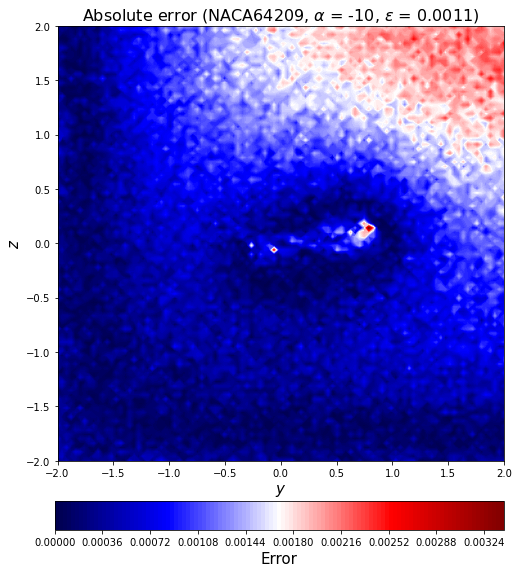

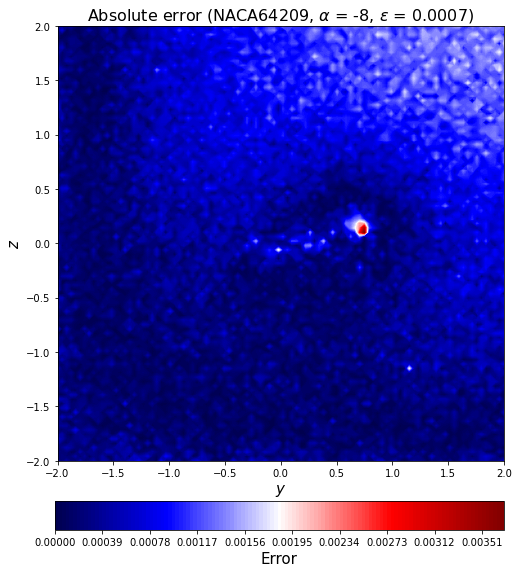

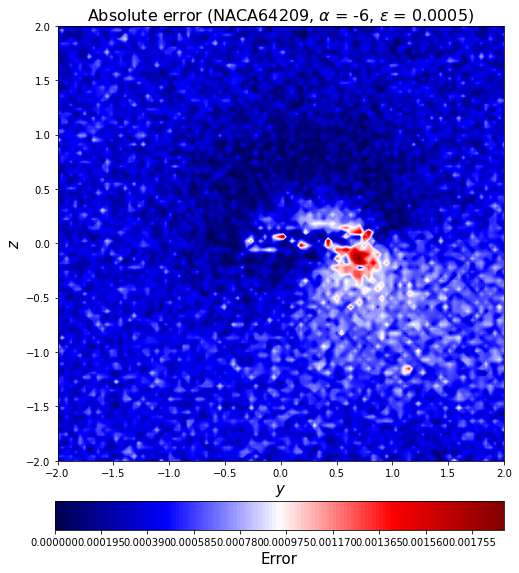

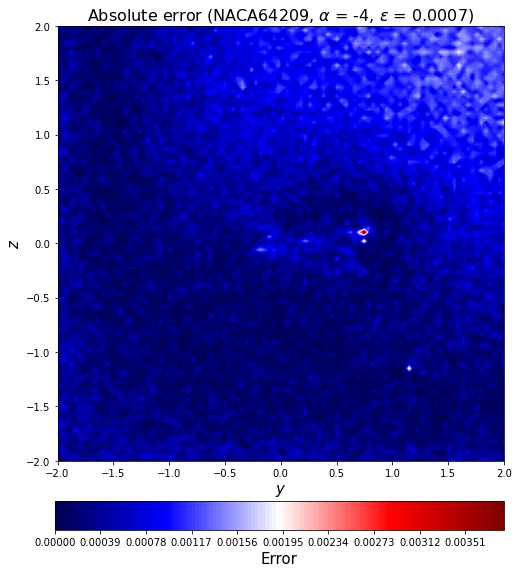

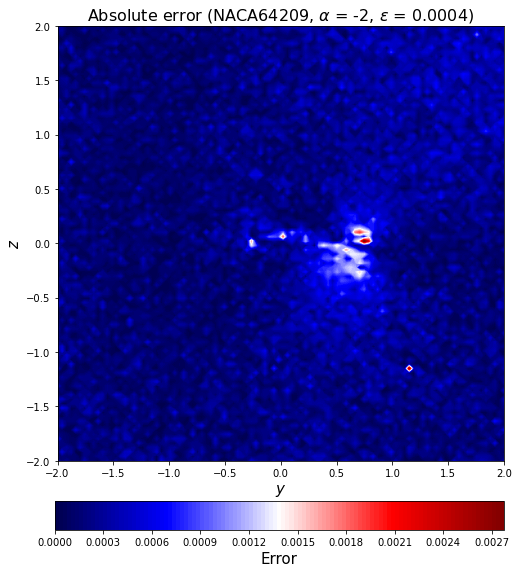

...

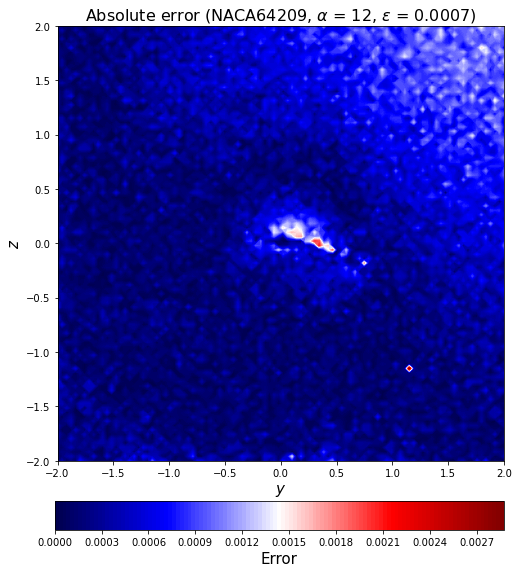

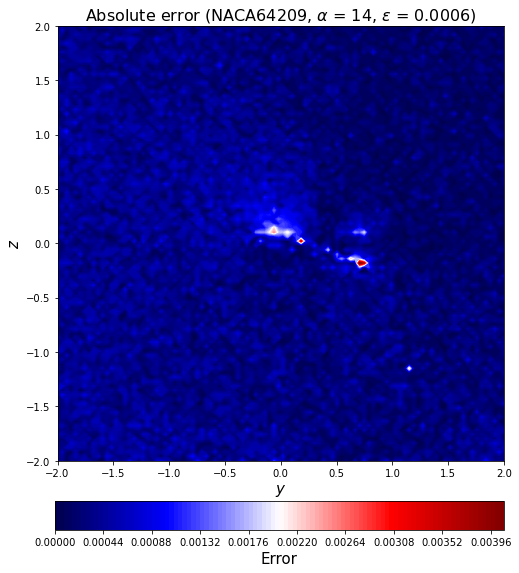

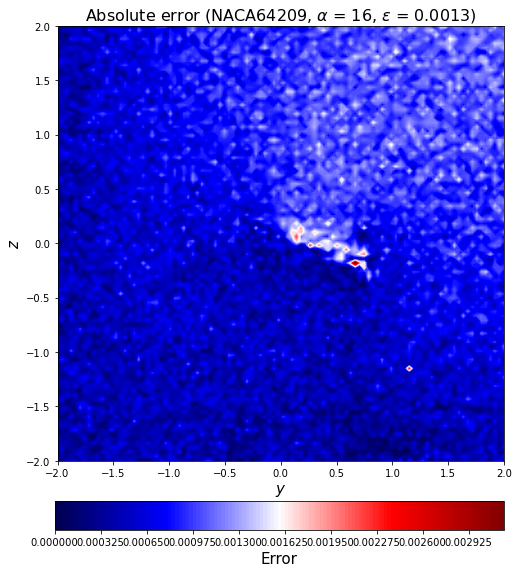

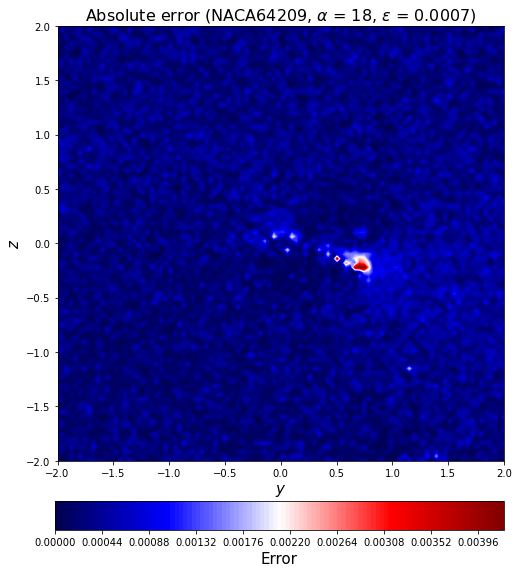

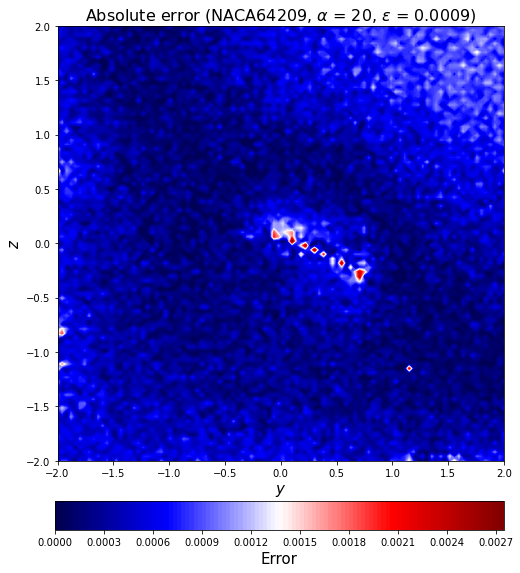

In [74]:
for c in range(0,16):
    error_test_abs2_rotate = error_test_abs[c].reshape(n_grid,n_grid).T

    fig5 = plt.figure(figsize = (8, 8))
    ax5 = fig5.add_subplot(111)
    mappable = ax5.contourf(xmesh, ymesh, error_test_abs2_rotate, levels=128, cmap='seismic')
    ax5.set_title(r'Absolute error (%s, $\alpha$ = %d, $\epsilon$ = %.4f)' %(np.array2string(geo_test[c])[3:-2],
                                                                       aa_test[c], l2_error_test_list[c]), fontsize=16)
    ax5.set_xlabel('$y$', fontsize=15)
    ax5.set_ylabel('$z$', fontsize=15)

    cax = plt.axes([0.12, 0.005, 0.78, 0.05])
    cbar = plt.colorbar(mappable, cax=cax, orientation="horizontal")
    cbar.set_label('Error', fontsize=15)

    save_fig_name = "20221030PredictionError_Poisson_bc2(test)"+str(np.array2string(geo_test[c])[3:-2])+str(aa_test[c])+".jpg"
    plt.savefig(save_fig_name, dpi=300, bbox_inches='tight', pad_inches=0.3)
    plt.show()

In [75]:
MAPE_train = (np.sum(np.abs(np.sum(y_train)-np.sum(decoded_train))) / np.abs(np.sum(y_train)))/(y_train.shape[0]/16)*100
acc_train = 1-MAPE_train

In [76]:
MAPE_val = (np.sum(np.abs(np.sum(y_val)-np.sum(decoded_val))) / np.abs(np.sum(y_val)))/(y_val.shape[0]/16)*100
acc_val = 1-MAPE_val

In [77]:
MAPE_test = (np.sum(np.abs(np.sum(y_test)-np.sum(decoded_test))) / np.abs(np.sum(y_test)))/(y_test.shape[0]/16)*100
acc_test = 1-MAPE_test

In [78]:
print(MAPE_train)
print(acc_train)

0.0004593931448732957
0.9995406068551267


In [79]:
print(MAPE_val)
print(acc_val)

0.008926344863300554
0.9910736551366994


In [80]:
print(MAPE_test)
print(acc_test)

0.01317731794847924
0.9868226820515208


In [81]:
MAPE_train_list = []
acc_train_list = []
for i in range(0, len(aa_train)):
    MAPE_train_data = (np.sum(np.abs(y_train[i]-decoded_train[i])) / np.sum(np.abs(y_train[i])))/(y_train.shape[0]/16)*100
    MAPE_train_list.append(MAPE_train_data)
    acc_train_data = 1 - MAPE_train_data
    acc_train_list.append(acc_train_data)

In [82]:
MAPE_val_list = []
acc_val_list = []
for i in range(0, len(aa_val)):
    MAPE_val_data = (np.sum(np.abs(y_val[i]-decoded_val[i])) / np.sum(np.abs(y_val[i])))/(y_val.shape[0]/16)*100
    MAPE_val_list.append(MAPE_val_data)
    acc_val_data = 1 - MAPE_val_data
    acc_val_list.append(acc_val_data)

In [83]:
MAPE_test_list = []
acc_test_list = []
for i in range(0, len(aa_test)):
    MAPE_test_data = (np.sum(np.abs(y_test[i]-decoded_test[i])) / np.sum(np.abs(y_test[i])))/(y_test.shape[0]/16)*100
    MAPE_test_list.append(MAPE_test_data)
    acc_test_data = 1 - MAPE_test_data
    acc_test_list.append(acc_test_data)

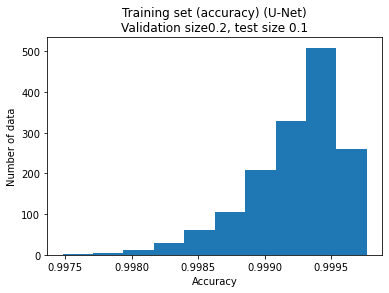

In [84]:
plt.hist(acc_train_list)
plt.title('Training set (accuracy) (U-Net)\nValidation size0.2, test size 0.1')
plt.ylabel('Number of data')
plt.xlabel('Accuracy')
#plt.grid()
save_acc_name = "20221030Accuracy_Poisson_bc2(training).jpg"
plt.savefig(save_acc_name, dpi=300, bbox_inches='tight', pad_inches=0.3)
plt.show()

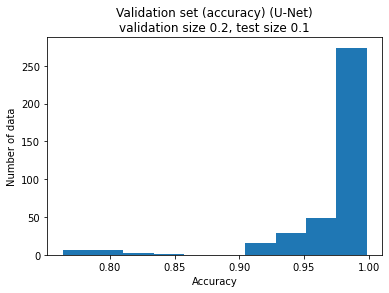

In [85]:
plt.hist(acc_val_list)
plt.title('Validation set (accuracy) (U-Net)\nvalidation size 0.2, test size 0.1')
plt.ylabel('Number of data')
plt.xlabel('Accuracy')
save_acc_name = "20221030Accuracy_Poisson_bc2(validation).jpg"
plt.savefig(save_acc_name, dpi=300, bbox_inches='tight', pad_inches=0.3)
plt.show()

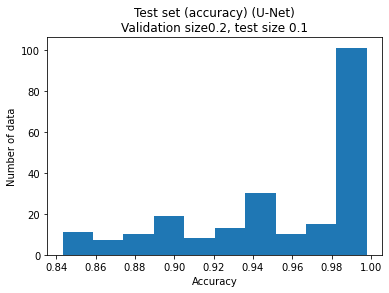

In [86]:
plt.hist(acc_test_list)
plt.title('Test set (accuracy) (U-Net)\nValidation size0.2, test size 0.1')
plt.ylabel('Number of data')
plt.xlabel('Accuracy')
save_acc_name = "20221030Accuracy_Poisson_bc2(test).jpg"
plt.savefig(save_acc_name, dpi=300, bbox_inches='tight', pad_inches=0.3)
plt.show()

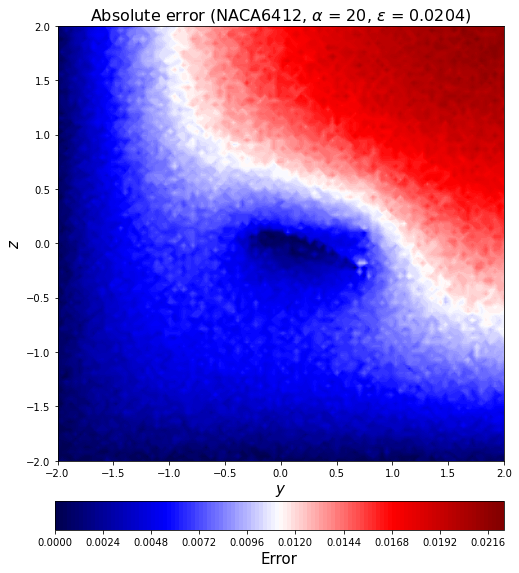

In [87]:
error_test_abs2_rotate = error_test_abs[-1].reshape(n_grid,n_grid).T

fig5 = plt.figure(figsize = (8, 8))
ax5 = fig5.add_subplot(111)
mappable = ax5.contourf(xmesh, ymesh, error_test_abs2_rotate, levels=128, cmap='seismic')
ax5.set_title(r'Absolute error (%s, $\alpha$ = %d, $\epsilon$ = %.4f)' %(np.array2string(geo_test[-1])[3:-2],
                                                                   aa_test[-1], l2_error_test_list[-1]), fontsize=16)
ax5.set_xlabel('$y$', fontsize=15)
ax5.set_ylabel('$z$', fontsize=15)

cax = plt.axes([0.12, 0.005, 0.78, 0.05])
cbar = plt.colorbar(mappable, cax=cax, orientation="horizontal")
cbar.set_label('Error', fontsize=15)

save_fig_name = "20221030PredictionError_Poisson_bc2(test)"+str(np.array2string(geo_test[-1])[3:-2])+str(aa_test[-1])+".jpg"
plt.savefig(save_fig_name, dpi=300, bbox_inches='tight', pad_inches=0.3)
plt.show()

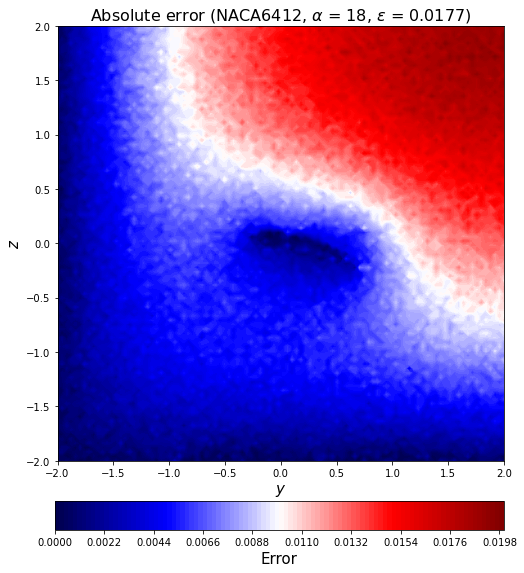

In [88]:
error_test_abs2_rotate = error_test_abs[-2].reshape(n_grid,n_grid).T

fig5 = plt.figure(figsize = (8, 8))
ax5 = fig5.add_subplot(111)
mappable = ax5.contourf(xmesh, ymesh, error_test_abs2_rotate, levels=128, cmap='seismic')
ax5.set_title(r'Absolute error (%s, $\alpha$ = %d, $\epsilon$ = %.4f)' %(np.array2string(geo_test[-2])[3:-2],
                                                                   aa_test[-2], l2_error_test_list[-2]), fontsize=16)
ax5.set_xlabel('$y$', fontsize=15)
ax5.set_ylabel('$z$', fontsize=15)

cax = plt.axes([0.12, 0.005, 0.78, 0.05])
cbar = plt.colorbar(mappable, cax=cax, orientation="horizontal")
cbar.set_label('Error', fontsize=15)

save_fig_name = "20221030PredictionError_Poisson_bc2(test)"+str(np.array2string(geo_test[-2])[3:-2])+str(aa_test[-2])+".jpg"
plt.savefig(save_fig_name, dpi=300, bbox_inches='tight', pad_inches=0.3)
plt.show()

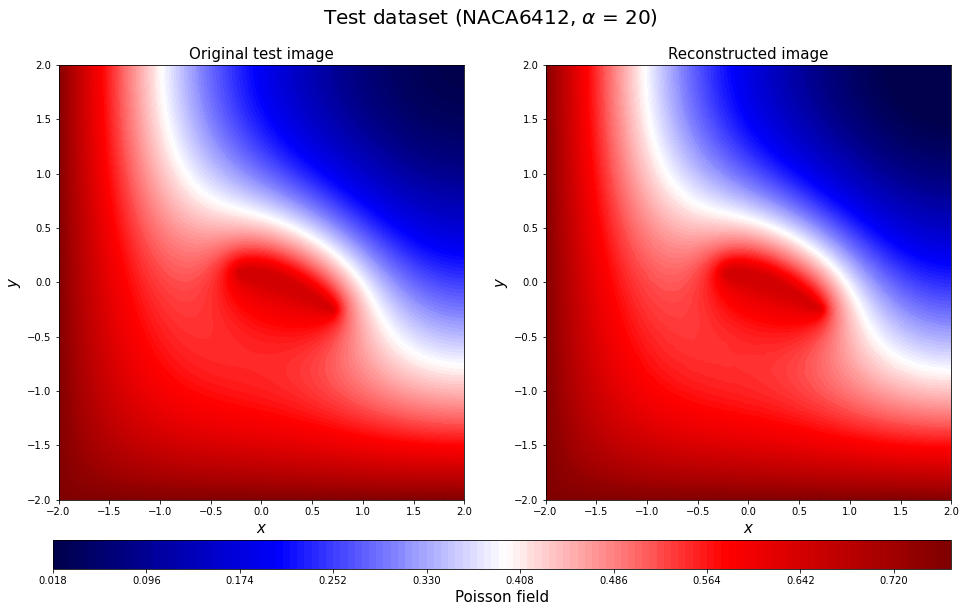

In [89]:
c=-1
plt.figure(figsize=(16, 8))
y_test0_rotate = y_test[c].reshape(n_grid,n_grid).T
decoded_rotate = decoded_test[c].reshape(n_grid,n_grid).T

xrange = np.linspace(-2, 2, n_grid)
yrange = np.linspace(-2, 2, n_grid)
xmesh, ymesh = np.meshgrid(xrange, yrange)

ax = plt.subplot(1, 2, 1)
a1 = plt.contourf(xmesh, ymesh, y_test0_rotate, vmin=np.min(y_test0_rotate),
                  vmax=np.max(y_test0_rotate), levels=128, cmap='seismic')
ax.set_xlabel('$x$', fontsize=15)
ax.set_ylabel('$y$', fontsize=15)
ax.set_title('Original test image', fontsize=15)

# Display reconstruction
ax = plt.subplot(1, 2, 2)
a2 = plt.contourf(xmesh, ymesh, decoded_rotate, vmin=np.min(y_test0_rotate),
                  vmax=np.max(y_test0_rotate), levels=128, cmap='seismic')
ax.set_xlabel('$x$', fontsize=15)
ax.set_ylabel('$y$', fontsize=15)
ax.set_title('Reconstructed image', fontsize=15)
cax = plt.axes([0.12, 0.005, 0.78, 0.05])
cbar = plt.colorbar(a1, cax=cax, orientation="horizontal")
cbar.set_label('Poisson field', fontsize=15)
#cbar.set_ticks([-0.5, -0.4, -0.3, -0.2, -0.1, 0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9])

plt.suptitle(r'Test dataset (%s, $\alpha$ = %d)' %(np.array2string(geo_test[c])[3:-2], aa_test[c]),fontsize=20)
save_fig_name = "20221030Prediction_Poisson_bc2(test)"+str(np.array2string(geo_test[c])[3:-2])+str(aa_test[c])+".jpg"
plt.savefig(save_fig_name, dpi=300, bbox_inches='tight', pad_inches=0.3)
plt.show()

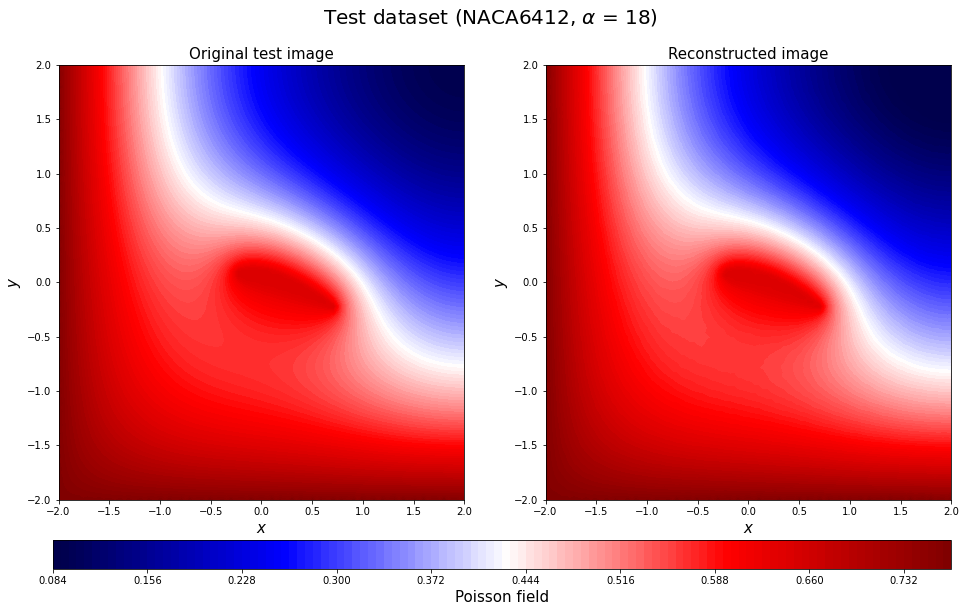

In [90]:
c=-2
plt.figure(figsize=(16, 8))
y_test0_rotate = y_test[c].reshape(n_grid,n_grid).T
decoded_rotate = decoded_test[c].reshape(n_grid,n_grid).T

xrange = np.linspace(-2, 2, n_grid)
yrange = np.linspace(-2, 2, n_grid)
xmesh, ymesh = np.meshgrid(xrange, yrange)

ax = plt.subplot(1, 2, 1)
a1 = plt.contourf(xmesh, ymesh, y_test0_rotate, vmin=np.min(y_test0_rotate),
                  vmax=np.max(y_test0_rotate), levels=128, cmap='seismic')
ax.set_xlabel('$x$', fontsize=15)
ax.set_ylabel('$y$', fontsize=15)
ax.set_title('Original test image', fontsize=15)

# Display reconstruction
ax = plt.subplot(1, 2, 2)
a2 = plt.contourf(xmesh, ymesh, decoded_rotate, vmin=np.min(y_test0_rotate),
                  vmax=np.max(y_test0_rotate), levels=128, cmap='seismic')
ax.set_xlabel('$x$', fontsize=15)
ax.set_ylabel('$y$', fontsize=15)
ax.set_title('Reconstructed image', fontsize=15)
cax = plt.axes([0.12, 0.005, 0.78, 0.05])
cbar = plt.colorbar(a1, cax=cax, orientation="horizontal")
cbar.set_label('Poisson field', fontsize=15)
#cbar.set_ticks([-0.5, -0.4, -0.3, -0.2, -0.1, 0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9])

plt.suptitle(r'Test dataset (%s, $\alpha$ = %d)' %(np.array2string(geo_test[c])[3:-2], aa_test[c]),fontsize=20)
save_fig_name = "20221030Prediction_Poisson_bc2(test)"+str(np.array2string(geo_test[c])[3:-2])+str(aa_test[c])+".jpg"
plt.savefig(save_fig_name, dpi=300, bbox_inches='tight', pad_inches=0.3)
plt.show()

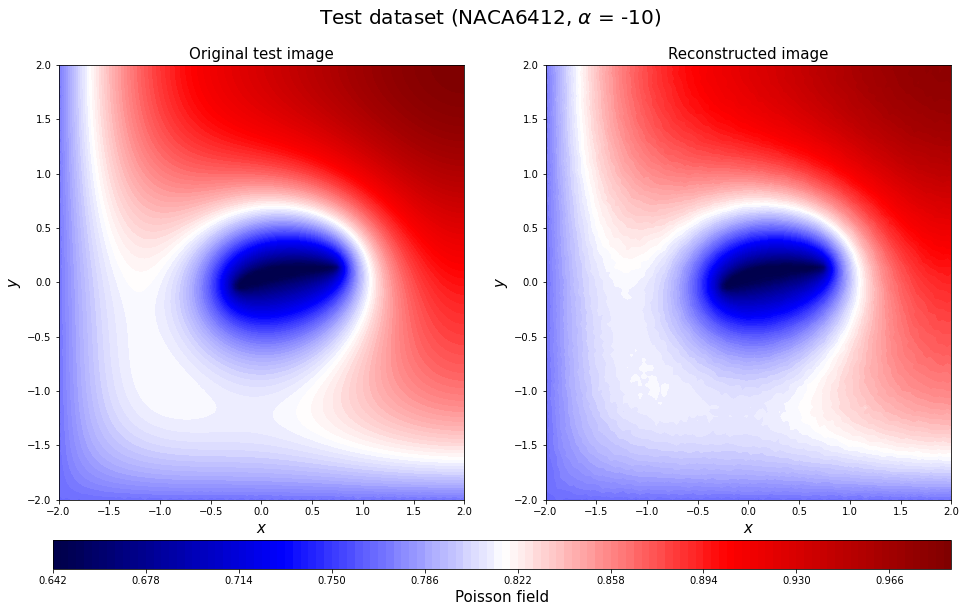

In [91]:
c=-16
plt.figure(figsize=(16, 8))
y_test0_rotate = y_test[c].reshape(n_grid,n_grid).T
decoded_rotate = decoded_test[c].reshape(n_grid,n_grid).T

xrange = np.linspace(-2, 2, n_grid)
yrange = np.linspace(-2, 2, n_grid)
xmesh, ymesh = np.meshgrid(xrange, yrange)

ax = plt.subplot(1, 2, 1)
a1 = plt.contourf(xmesh, ymesh, y_test0_rotate, vmin=np.min(y_test0_rotate),
                  vmax=np.max(y_test0_rotate), levels=128, cmap='seismic')
ax.set_xlabel('$x$', fontsize=15)
ax.set_ylabel('$y$', fontsize=15)
ax.set_title('Original test image', fontsize=15)

# Display reconstruction
ax = plt.subplot(1, 2, 2)
a2 = plt.contourf(xmesh, ymesh, decoded_rotate, vmin=np.min(y_test0_rotate),
                  vmax=np.max(y_test0_rotate), levels=128, cmap='seismic')
ax.set_xlabel('$x$', fontsize=15)
ax.set_ylabel('$y$', fontsize=15)
ax.set_title('Reconstructed image', fontsize=15)
cax = plt.axes([0.12, 0.005, 0.78, 0.05])
cbar = plt.colorbar(a1, cax=cax, orientation="horizontal")
cbar.set_label('Poisson field', fontsize=15)
#cbar.set_ticks([-0.5, -0.4, -0.3, -0.2, -0.1, 0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9])

plt.suptitle(r'Test dataset (%s, $\alpha$ = %d)' %(np.array2string(geo_test[c])[3:-2], aa_test[c]),fontsize=20)
save_fig_name = "20221030Prediction_Poisson_bc2(test)"+str(np.array2string(geo_test[c])[3:-2])+str(aa_test[c])+".jpg"
plt.savefig(save_fig_name, dpi=300, bbox_inches='tight', pad_inches=0.3)
plt.show()

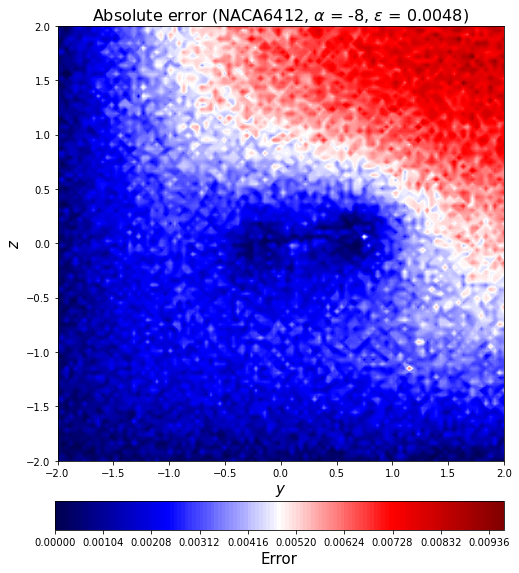

In [92]:
error_test_abs2_rotate = error_test_abs[-15].reshape(n_grid,n_grid).T

fig5 = plt.figure(figsize = (8, 8))
ax5 = fig5.add_subplot(111)
mappable = ax5.contourf(xmesh, ymesh, error_test_abs2_rotate, levels=128, cmap='seismic')
ax5.set_title(r'Absolute error (%s, $\alpha$ = %d, $\epsilon$ = %.4f)' %(np.array2string(geo_test[-15])[3:-2],
                                                                   aa_test[-15], l2_error_test_list[-15]), fontsize=16)
ax5.set_xlabel('$y$', fontsize=15)
ax5.set_ylabel('$z$', fontsize=15)

cax = plt.axes([0.12, 0.005, 0.78, 0.05])
cbar = plt.colorbar(mappable, cax=cax, orientation="horizontal")
cbar.set_label('Error', fontsize=15)

save_fig_name = "20221030PredictionError_Poisson_bc2(test)"+str(np.array2string(geo_test[-15])[3:-2])+str(aa_test[-15])+".jpg"
plt.savefig(save_fig_name, dpi=300, bbox_inches='tight', pad_inches=0.3)
plt.show()

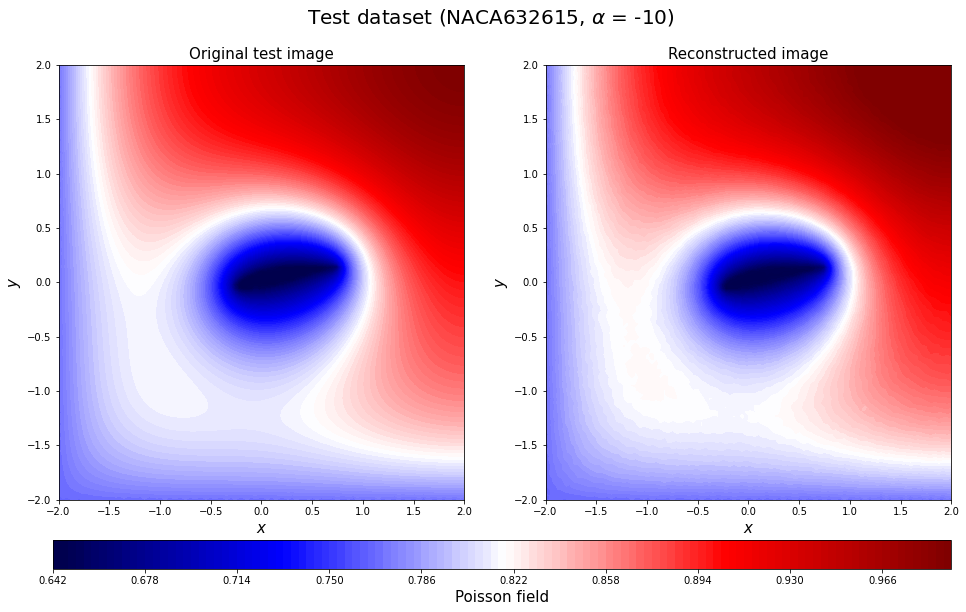

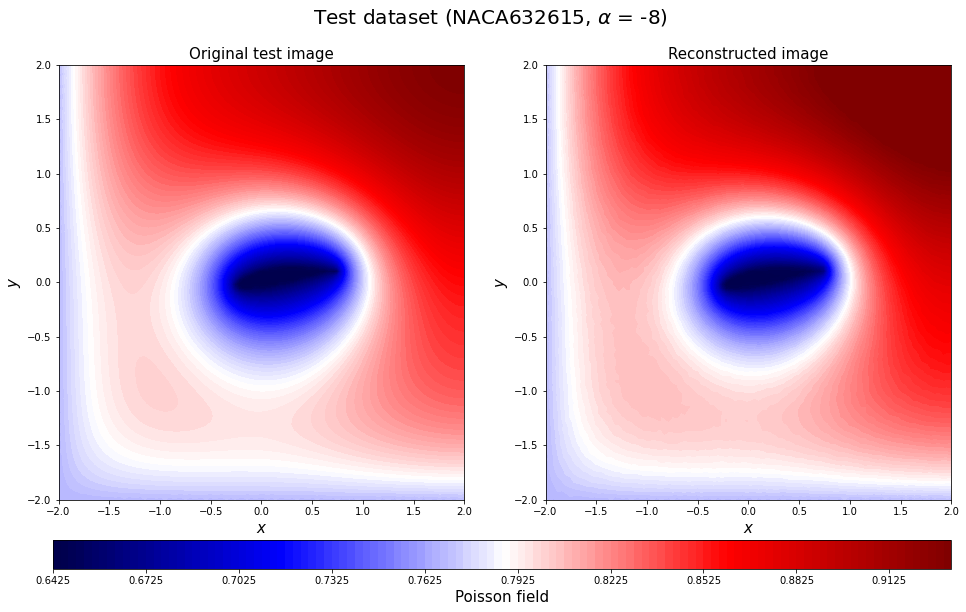

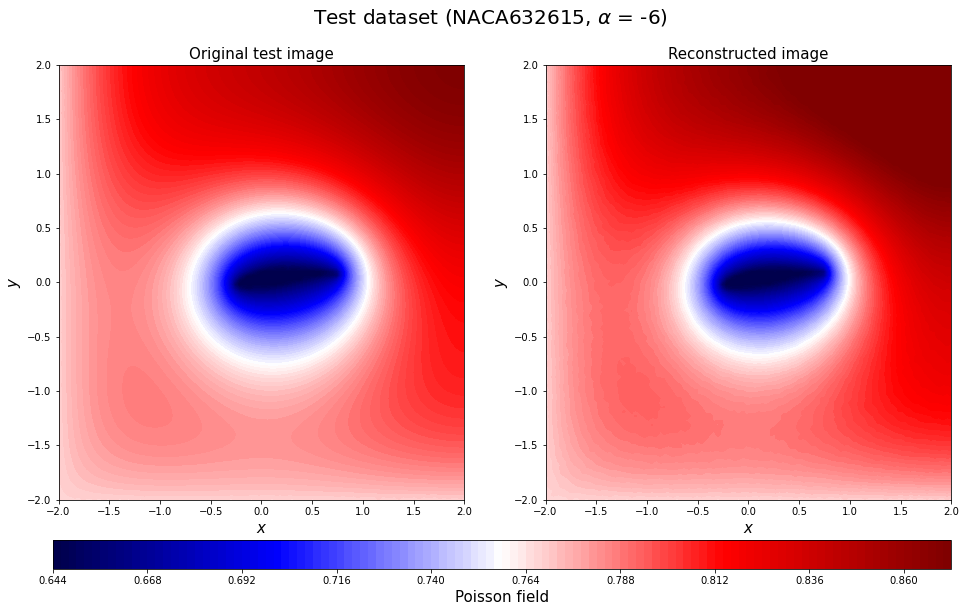

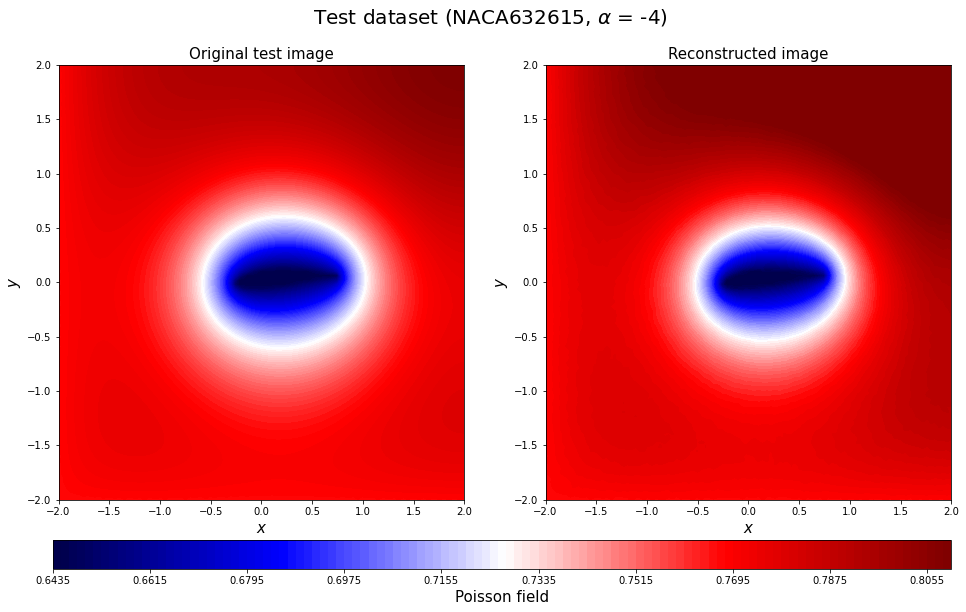

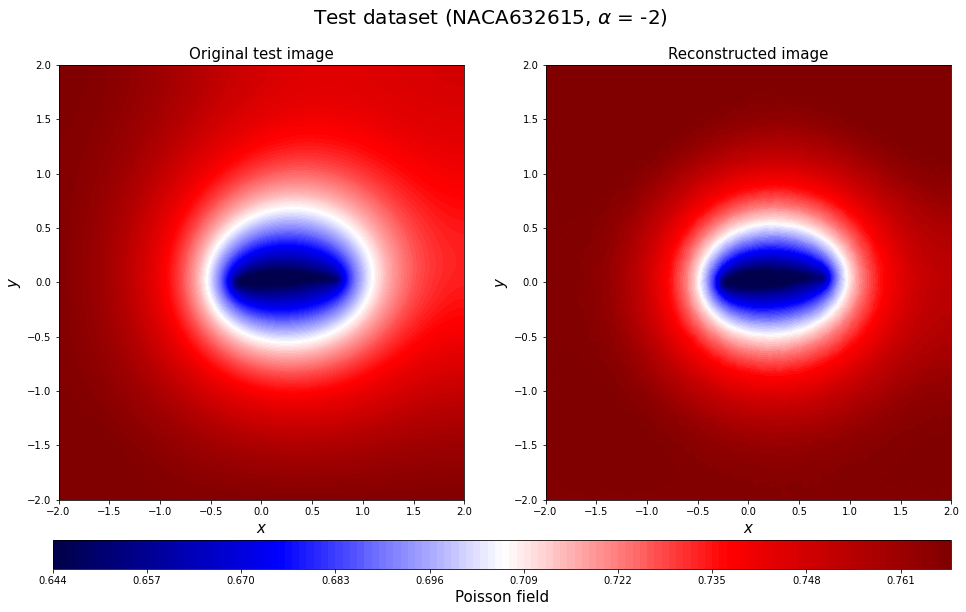

...

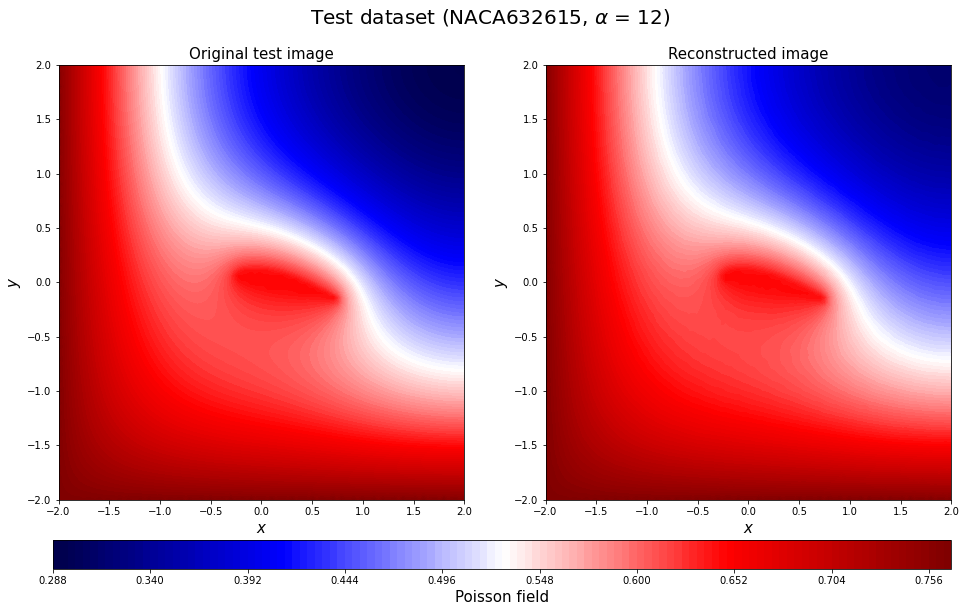

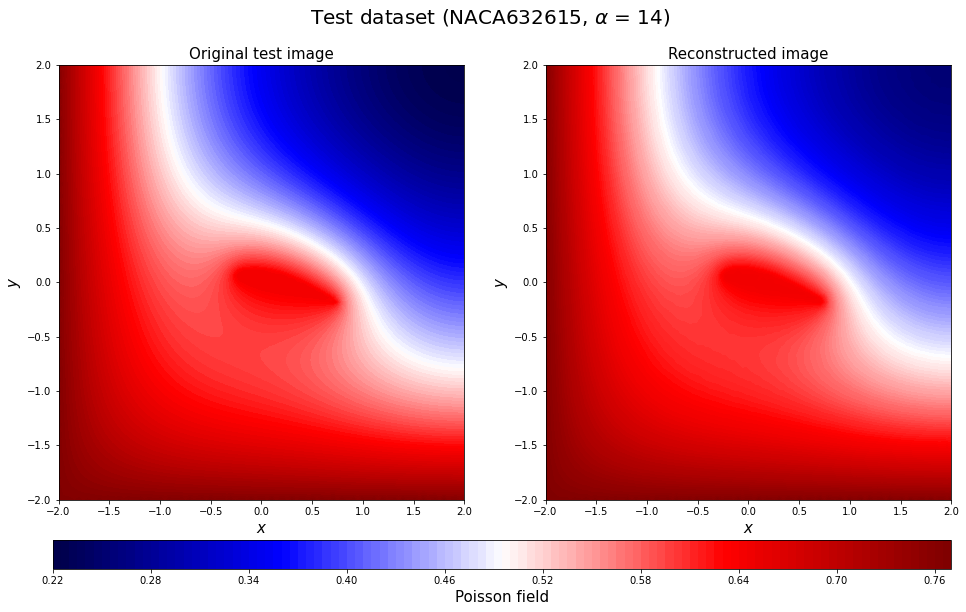

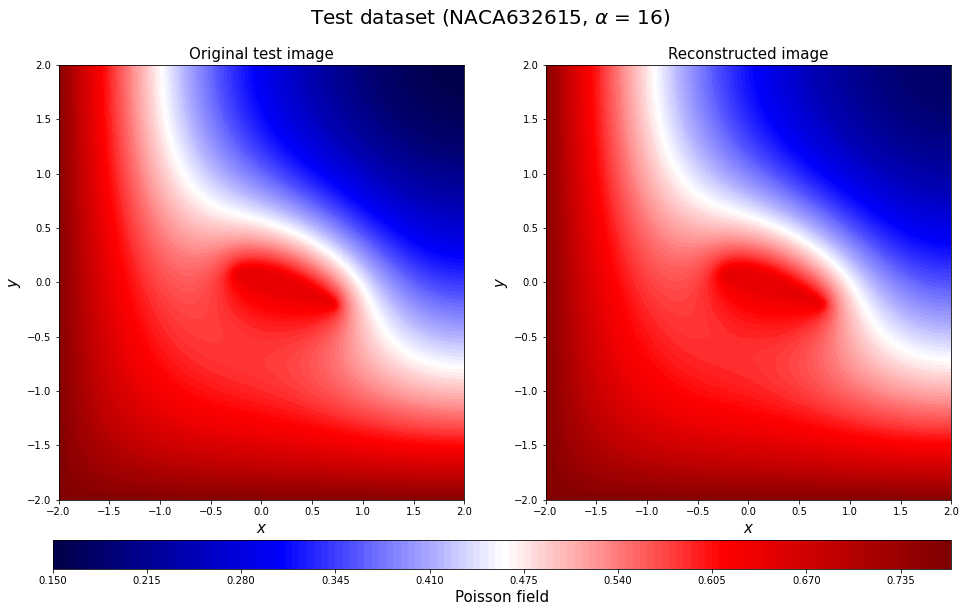

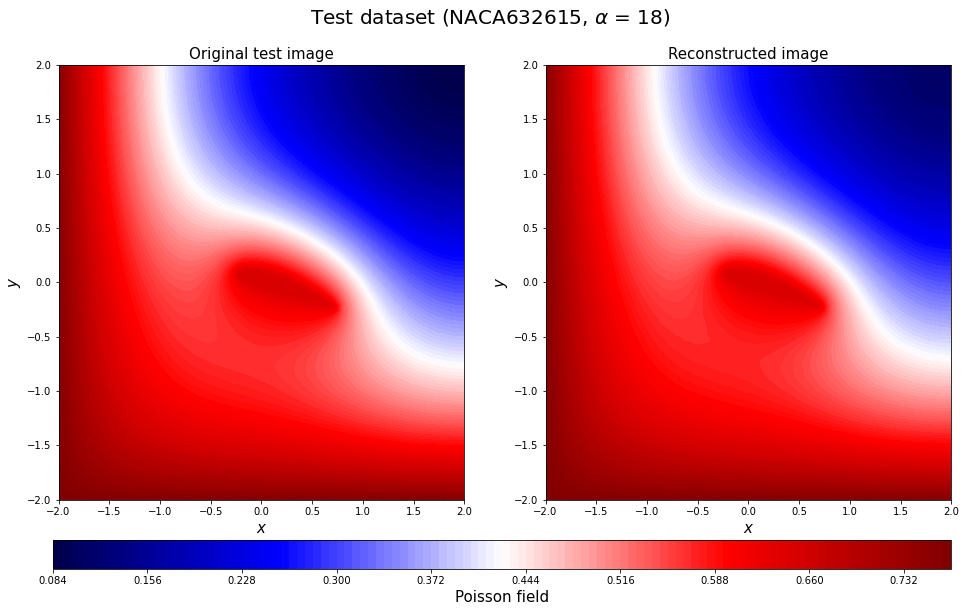

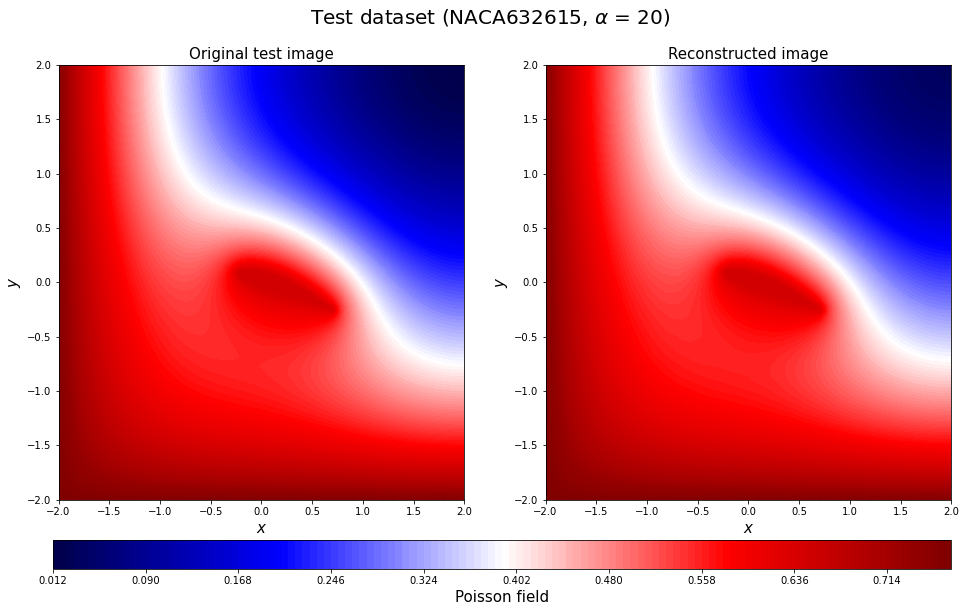

In [93]:
for c in range(96,112):
    plt.figure(figsize=(16, 8))
    y_test0_rotate = y_test[c].reshape(n_grid,n_grid).T
    decoded_rotate = decoded_test[c].reshape(n_grid,n_grid).T

    xrange = np.linspace(-2, 2, n_grid)
    yrange = np.linspace(-2, 2, n_grid)
    xmesh, ymesh = np.meshgrid(xrange, yrange)

    ax = plt.subplot(1, 2, 1)
    a1 = plt.contourf(xmesh, ymesh, y_test0_rotate, vmin=np.min(y_test0_rotate),
                      vmax = np.max(y_test0_rotate),levels=128, cmap='seismic')
    ax.set_xlabel('$x$', fontsize=15)
    ax.set_ylabel('$y$', fontsize=15)
    ax.set_title('Original test image', fontsize=15)

    # Display reconstruction
    ax = plt.subplot(1, 2, 2)
    a2 = plt.contourf(xmesh, ymesh, decoded_rotate, vmin=np.min(y_test0_rotate),
                      vmax = np.max(y_test0_rotate),levels=128, cmap='seismic')
    ax.set_xlabel('$x$', fontsize=15)
    ax.set_ylabel('$y$', fontsize=15)
    ax.set_title('Reconstructed image', fontsize=15)
    cax = plt.axes([0.12, 0.005, 0.78, 0.05])
    cbar = plt.colorbar(a1, cax=cax, orientation="horizontal")
    cbar.set_label('Poisson field', fontsize=15)
    #cbar.set_ticks([-0.5, -0.4, -0.3, -0.2, -0.1, 0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9])

    plt.suptitle(r'Test dataset (%s, $\alpha$ = %d)' %(np.array2string(geo_test[c])[3:-2], aa_test[c]),fontsize=20)
    save_fig_name = "20221030Prediction_Poisson_bc2(test)"+str(np.array2string(geo_test[c])[3:-2])+str(aa_test[c])+".jpg"
    plt.savefig(save_fig_name, dpi=300, bbox_inches='tight', pad_inches=0.3)
    plt.show()

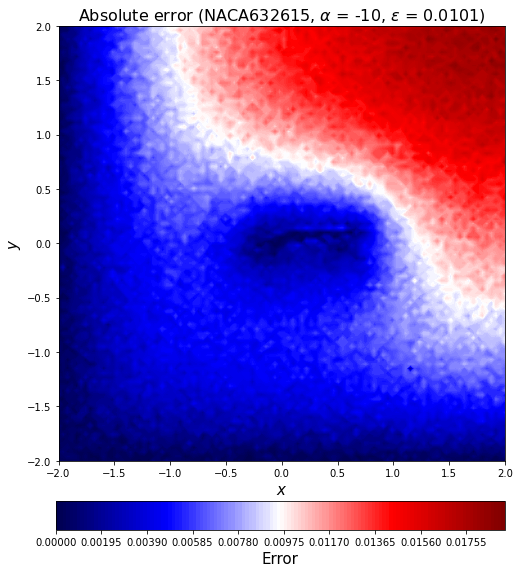

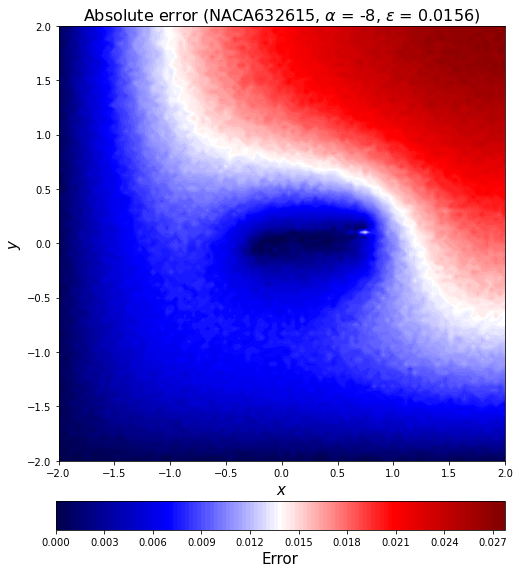

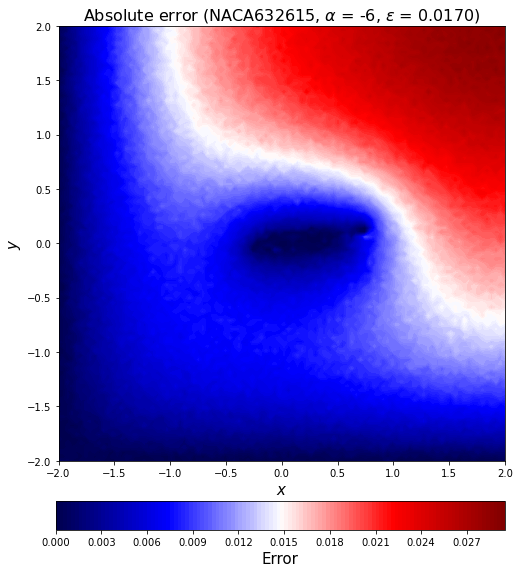

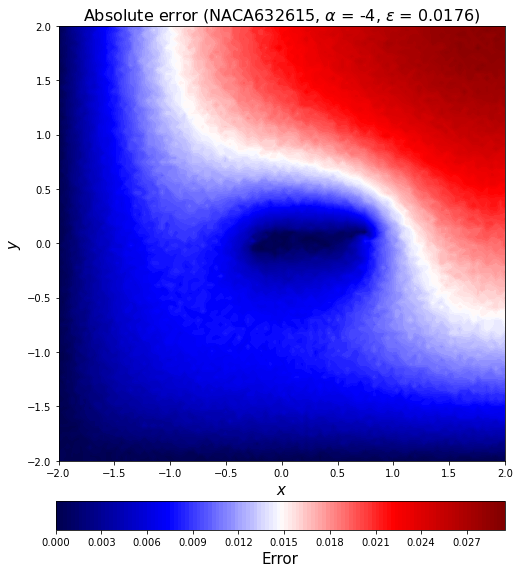

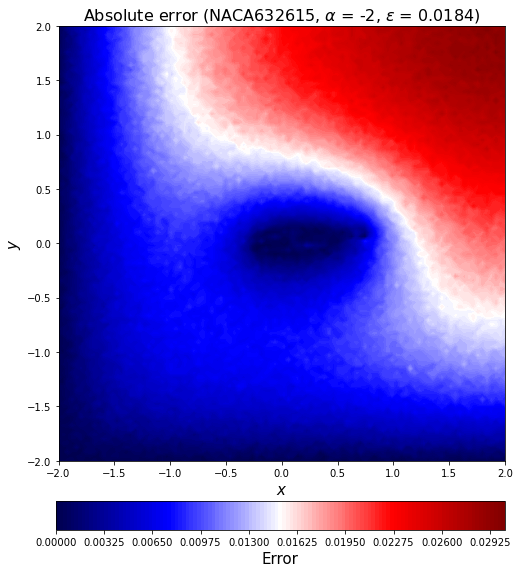

...

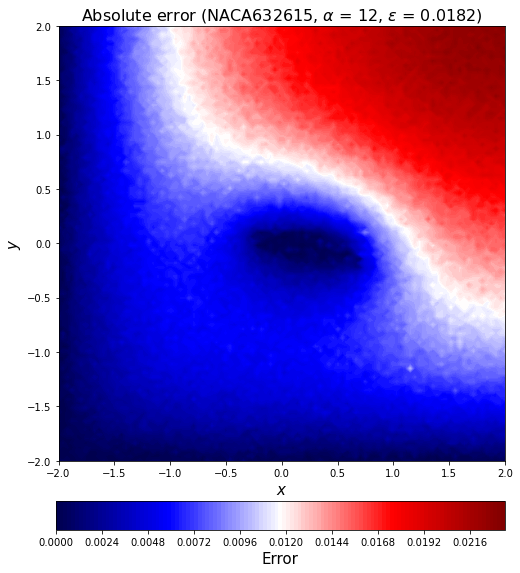

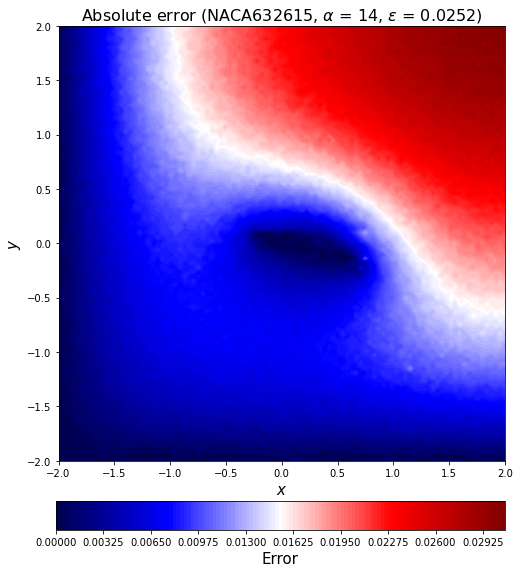

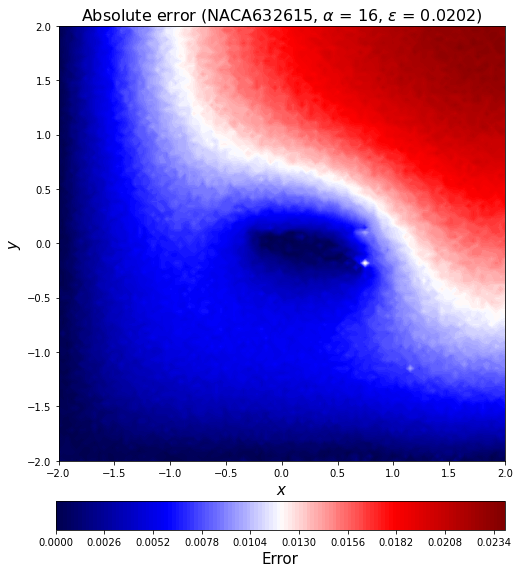

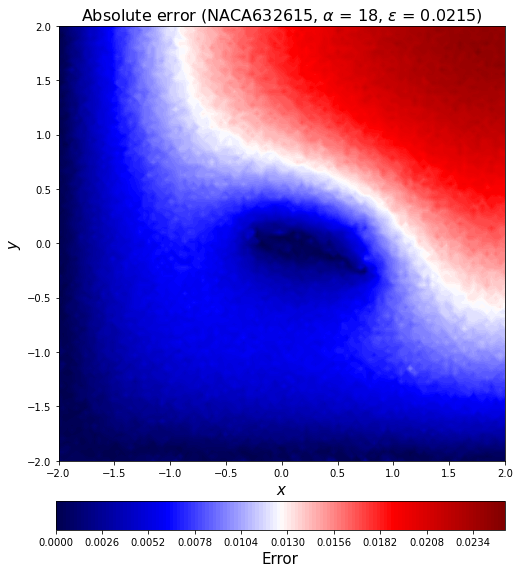

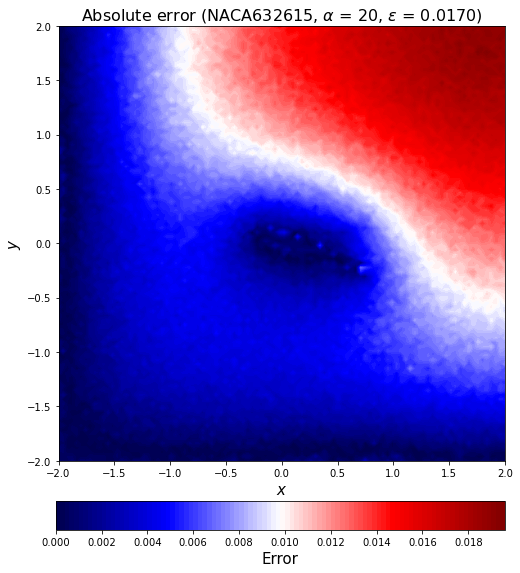

In [94]:
for c in range(96,112):
    error_test_abs2_rotate = error_test_abs[c].reshape(n_grid,n_grid).T

    fig5 = plt.figure(figsize = (8, 8))
    ax5 = fig5.add_subplot(111)
    mappable = ax5.contourf(xmesh, ymesh, error_test_abs2_rotate, levels=128, cmap='seismic')
    ax5.set_title(r'Absolute error (%s, $\alpha$ = %d, $\epsilon$ = %.4f)' %(np.array2string(geo_test[c])[3:-2],
                                                                       aa_test[c], l2_error_test_list[c]), fontsize=16)
    ax5.set_xlabel('$x$', fontsize=15)
    ax5.set_ylabel('$y$', fontsize=15)

    cax = plt.axes([0.12, 0.005, 0.78, 0.05])
    cbar = plt.colorbar(mappable, cax=cax, orientation="horizontal")
    cbar.set_label('Error', fontsize=15)

    save_fig_name = "20221030PredictionError_Poisson_bc2(test)"+str(np.array2string(geo_test[c])[3:-2])+str(aa_test[c])+".jpg"
    plt.savefig(save_fig_name, dpi=300, bbox_inches='tight', pad_inches=0.3)
    plt.show()

0.9994262738565944
0.0005737261434055618
0.994062225026873
0.005937774973126975
0.9935201258502095
0.006479874149790454


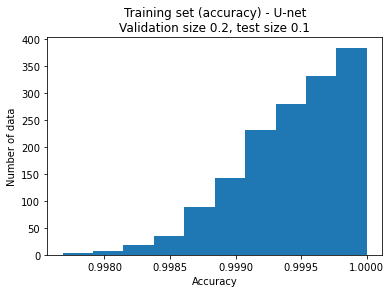

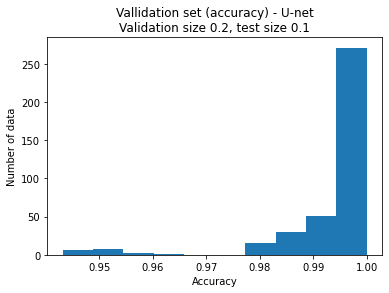

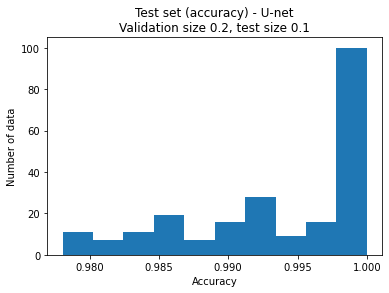

In [95]:
yTrainSum = np.zeros((y_train.shape[0],1))
dTrainSum = np.zeros((decoded_train.shape[0], 1))
MAPE_train_list = np.zeros((y_train.shape[0], 1))
for i in range(0, y_train.shape[0]):
    yTrainSum[i,:] = np.sum(y_train[i])
    dTrainSum[i,:] = np.sum(decoded_train[i])
    MAPE_train_list[i,:] = np.abs((dTrainSum[i,:]-yTrainSum[i,:])/yTrainSum[i,:])
    
MAPE_train =1-np.sum(MAPE_train_list)/x_train.shape[0]
print(MAPE_train)
acc_train = 1-MAPE_train
print(acc_train)
acc_train_list = 1 - MAPE_train_list

yValSum = np.zeros((y_val.shape[0],1))
dValSum = np.zeros((decoded_val.shape[0], 1))
MAPE_val_list = np.zeros((y_val.shape[0], 1))
for i in range(0, y_val.shape[0]):
    yValSum[i,:] = np.sum(y_val[i])
    dValSum[i,:] = np.sum(decoded_val[i])
    MAPE_val_list[i,:] = np.abs((dValSum[i,:]-yValSum[i,:])/yValSum[i,:])
    
MAPE_val = 1-np.sum(MAPE_val_list)/x_val.shape[0]
print(MAPE_val)
acc_val = 1-MAPE_val
print(acc_val)
acc_val_list = 1 - MAPE_val_list

yTestSum = np.zeros((y_test.shape[0],1))
dTestSum = np.zeros((decoded_test.shape[0], 1))
MAPE_test_list = np.zeros((y_test.shape[0], 1))
for i in range(0, y_test.shape[0]):
    yTestSum[i,:] = np.sum(y_test[i])
    dTestSum[i,:] = np.sum(decoded_test[i])
    MAPE_test_list[i,:] = np.abs((dTestSum[i,:]-yTestSum[i,:])/yTestSum[i,:])
    
MAPE_test = 1-np.sum(MAPE_test_list)/x_test.shape[0]
print(MAPE_test)
acc_test = 1-MAPE_test
print(acc_test)
acc_test_list = 1 - MAPE_test_list

plt.hist(acc_train_list)
plt.title('Training set (accuracy) - U-net\nValidation size 0.2, test size 0.1')
plt.ylabel('Number of data')
plt.xlabel('Accuracy')
#plt.grid()
save_acc_name = "20221030Accuracy_Poisson_bc2(training).jpg"
plt.savefig(save_acc_name, dpi=300, bbox_inches='tight', pad_inches=0.3)
plt.show()

plt.hist(acc_val_list)
plt.title('Vallidation set (accuracy) - U-net\nValidation size 0.2, test size 0.1')
plt.ylabel('Number of data')
plt.xlabel('Accuracy')
save_acc_name = "20221030Accuracy_Poisson_bc2(validation).jpg"
plt.savefig(save_acc_name, dpi=300, bbox_inches='tight', pad_inches=0.3)
plt.show()

plt.hist(acc_test_list)
plt.title('Test set (accuracy) - U-net\nValidation size 0.2, test size 0.1')
plt.ylabel('Number of data')
plt.xlabel('Accuracy')
save_acc_name = "20221030Accuracy_Poisson_bc2(test).jpg"
plt.savefig(save_acc_name, dpi=300, bbox_inches='tight', pad_inches=0.3)
plt.show()